# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [02:45, 1.10MB/s]                            
SVHN Testing Set: 64.3MB [00:52, 1.23MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

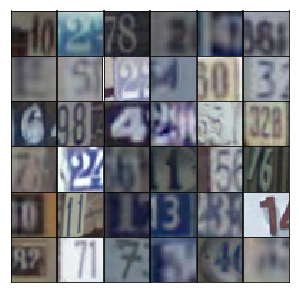

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.4011... Generator Loss: 0.5680
Epoch 1/25... Discriminator Loss: 0.6757... Generator Loss: 0.9856
Epoch 1/25... Discriminator Loss: 0.2156... Generator Loss: 2.0294
Epoch 1/25... Discriminator Loss: 0.1730... Generator Loss: 2.4557
Epoch 1/25... Discriminator Loss: 0.1530... Generator Loss: 2.7902
Epoch 1/25... Discriminator Loss: 0.0728... Generator Loss: 3.1912
Epoch 1/25... Discriminator Loss: 0.1289... Generator Loss: 2.6851
Epoch 1/25... Discriminator Loss: 0.3226... Generator Loss: 1.7626
Epoch 1/25... Discriminator Loss: 0.1230... Generator Loss: 3.2180
Epoch 1/25... Discriminator Loss: 1.0733... Generator Loss: 2.1474


/home/siyuan/venv/ml/lib/python3.5/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


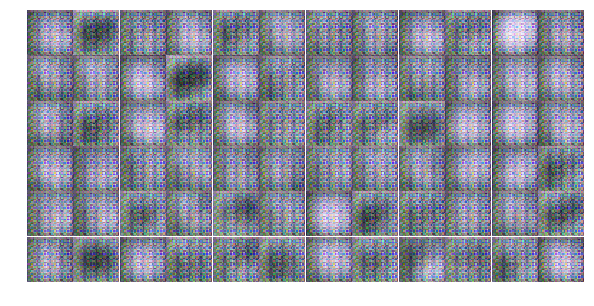

Epoch 1/25... Discriminator Loss: 0.4653... Generator Loss: 1.8074
Epoch 1/25... Discriminator Loss: 0.3557... Generator Loss: 2.7538
Epoch 1/25... Discriminator Loss: 0.5412... Generator Loss: 1.1287
Epoch 1/25... Discriminator Loss: 0.2164... Generator Loss: 2.6876
Epoch 1/25... Discriminator Loss: 0.4817... Generator Loss: 1.9460
Epoch 1/25... Discriminator Loss: 0.5661... Generator Loss: 2.3994
Epoch 1/25... Discriminator Loss: 0.2483... Generator Loss: 2.2613
Epoch 1/25... Discriminator Loss: 0.2140... Generator Loss: 3.1069
Epoch 1/25... Discriminator Loss: 0.2911... Generator Loss: 2.6316
Epoch 1/25... Discriminator Loss: 0.8997... Generator Loss: 6.0542


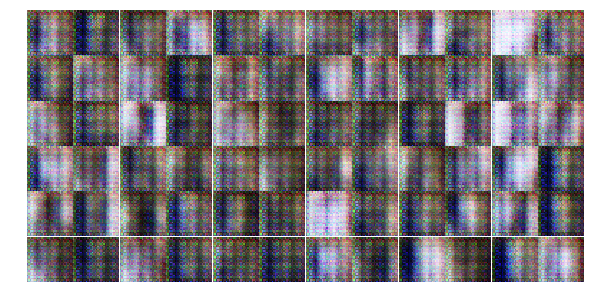

Epoch 1/25... Discriminator Loss: 1.5848... Generator Loss: 0.8782
Epoch 1/25... Discriminator Loss: 0.3400... Generator Loss: 5.3247
Epoch 1/25... Discriminator Loss: 0.2281... Generator Loss: 2.6669
Epoch 1/25... Discriminator Loss: 0.0693... Generator Loss: 3.9774
Epoch 1/25... Discriminator Loss: 0.1610... Generator Loss: 3.7305
Epoch 1/25... Discriminator Loss: 2.0967... Generator Loss: 5.9882
Epoch 1/25... Discriminator Loss: 0.9311... Generator Loss: 1.4183
Epoch 1/25... Discriminator Loss: 1.0302... Generator Loss: 1.3435
Epoch 1/25... Discriminator Loss: 0.8267... Generator Loss: 1.4182
Epoch 1/25... Discriminator Loss: 0.8354... Generator Loss: 1.2191


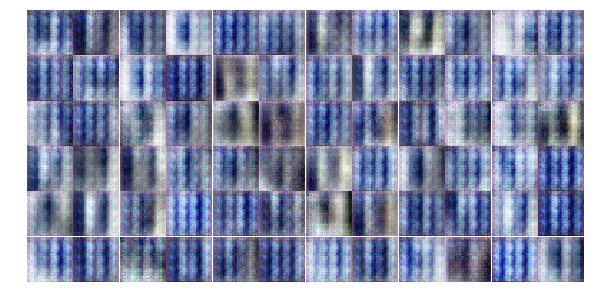

Epoch 1/25... Discriminator Loss: 0.8026... Generator Loss: 1.1516
Epoch 1/25... Discriminator Loss: 0.9164... Generator Loss: 1.1991
Epoch 1/25... Discriminator Loss: 0.5732... Generator Loss: 1.5296
Epoch 1/25... Discriminator Loss: 0.6876... Generator Loss: 1.6619
Epoch 1/25... Discriminator Loss: 0.4683... Generator Loss: 1.8585
Epoch 1/25... Discriminator Loss: 0.8339... Generator Loss: 0.9809
Epoch 1/25... Discriminator Loss: 0.5892... Generator Loss: 1.3881
Epoch 1/25... Discriminator Loss: 0.4721... Generator Loss: 2.1950
Epoch 1/25... Discriminator Loss: 0.4129... Generator Loss: 1.7826
Epoch 1/25... Discriminator Loss: 0.6352... Generator Loss: 2.1067


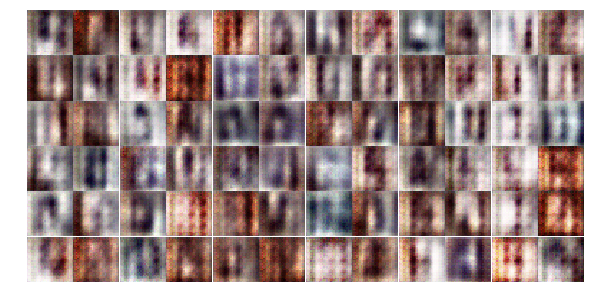

Epoch 1/25... Discriminator Loss: 0.4384... Generator Loss: 2.1583
Epoch 1/25... Discriminator Loss: 0.5735... Generator Loss: 2.1816
Epoch 1/25... Discriminator Loss: 0.7036... Generator Loss: 1.4879
Epoch 1/25... Discriminator Loss: 0.4313... Generator Loss: 2.0634
Epoch 1/25... Discriminator Loss: 0.3166... Generator Loss: 2.7457
Epoch 1/25... Discriminator Loss: 0.8068... Generator Loss: 0.8937
Epoch 1/25... Discriminator Loss: 1.4257... Generator Loss: 0.4703
Epoch 1/25... Discriminator Loss: 0.6126... Generator Loss: 1.3891
Epoch 1/25... Discriminator Loss: 0.8069... Generator Loss: 1.8675
Epoch 1/25... Discriminator Loss: 1.0367... Generator Loss: 2.0460


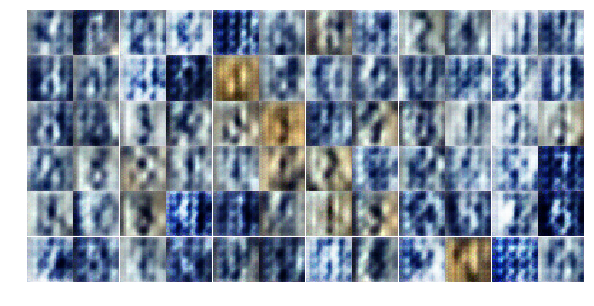

Epoch 1/25... Discriminator Loss: 0.7077... Generator Loss: 1.3844
Epoch 1/25... Discriminator Loss: 0.5347... Generator Loss: 1.7592
Epoch 1/25... Discriminator Loss: 0.7058... Generator Loss: 1.6841
Epoch 1/25... Discriminator Loss: 1.1859... Generator Loss: 0.5844
Epoch 1/25... Discriminator Loss: 0.9304... Generator Loss: 1.0382
Epoch 1/25... Discriminator Loss: 0.7096... Generator Loss: 1.2621
Epoch 1/25... Discriminator Loss: 0.7645... Generator Loss: 1.5949
Epoch 2/25... Discriminator Loss: 0.7797... Generator Loss: 1.4711
Epoch 2/25... Discriminator Loss: 0.6918... Generator Loss: 1.5706
Epoch 2/25... Discriminator Loss: 0.7451... Generator Loss: 1.0289


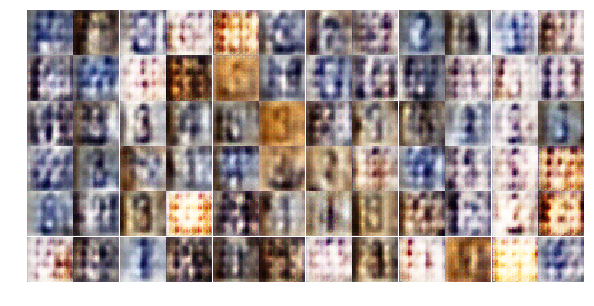

Epoch 2/25... Discriminator Loss: 0.8369... Generator Loss: 2.1142
Epoch 2/25... Discriminator Loss: 0.8131... Generator Loss: 1.1665
Epoch 2/25... Discriminator Loss: 0.7674... Generator Loss: 1.0696
Epoch 2/25... Discriminator Loss: 0.8648... Generator Loss: 1.1234
Epoch 2/25... Discriminator Loss: 0.8719... Generator Loss: 0.8809
Epoch 2/25... Discriminator Loss: 0.8487... Generator Loss: 1.2959
Epoch 2/25... Discriminator Loss: 0.9274... Generator Loss: 0.8145
Epoch 2/25... Discriminator Loss: 0.9596... Generator Loss: 0.9414
Epoch 2/25... Discriminator Loss: 0.9468... Generator Loss: 0.9841
Epoch 2/25... Discriminator Loss: 1.0490... Generator Loss: 1.1040


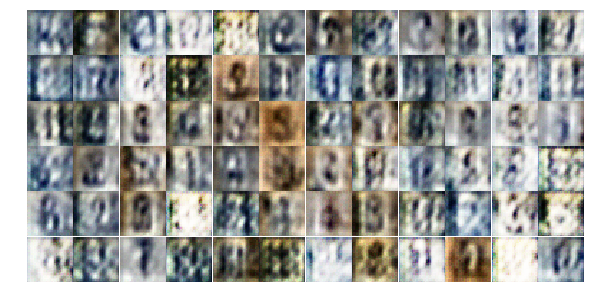

Epoch 2/25... Discriminator Loss: 1.5214... Generator Loss: 0.7369
Epoch 2/25... Discriminator Loss: 1.2002... Generator Loss: 1.5719
Epoch 2/25... Discriminator Loss: 0.9741... Generator Loss: 0.8957
Epoch 2/25... Discriminator Loss: 1.2678... Generator Loss: 0.6557
Epoch 2/25... Discriminator Loss: 0.8931... Generator Loss: 1.3251
Epoch 2/25... Discriminator Loss: 1.1084... Generator Loss: 1.1726
Epoch 2/25... Discriminator Loss: 0.8810... Generator Loss: 1.5431
Epoch 2/25... Discriminator Loss: 1.2902... Generator Loss: 1.1284
Epoch 2/25... Discriminator Loss: 1.0907... Generator Loss: 0.8902
Epoch 2/25... Discriminator Loss: 1.2593... Generator Loss: 0.5720


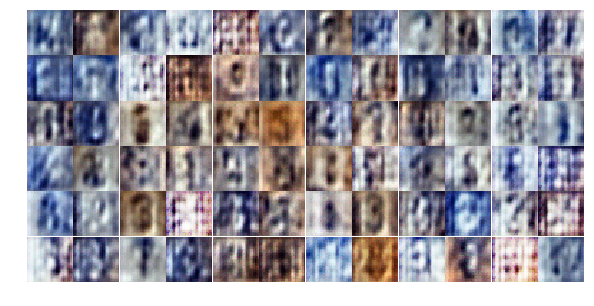

Epoch 2/25... Discriminator Loss: 1.2390... Generator Loss: 0.7936
Epoch 2/25... Discriminator Loss: 1.4146... Generator Loss: 0.4752
Epoch 2/25... Discriminator Loss: 0.8570... Generator Loss: 1.2286
Epoch 2/25... Discriminator Loss: 1.3048... Generator Loss: 1.0430
Epoch 2/25... Discriminator Loss: 0.8950... Generator Loss: 1.3545
Epoch 2/25... Discriminator Loss: 1.0631... Generator Loss: 0.8093
Epoch 2/25... Discriminator Loss: 1.3503... Generator Loss: 0.5970
Epoch 2/25... Discriminator Loss: 1.1492... Generator Loss: 0.7006
Epoch 2/25... Discriminator Loss: 1.0952... Generator Loss: 0.7830
Epoch 2/25... Discriminator Loss: 0.6955... Generator Loss: 1.5084


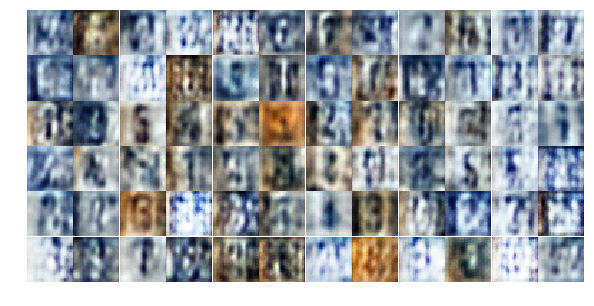

Epoch 2/25... Discriminator Loss: 1.1922... Generator Loss: 1.1261
Epoch 2/25... Discriminator Loss: 1.2104... Generator Loss: 1.0122
Epoch 2/25... Discriminator Loss: 1.5168... Generator Loss: 0.5584
Epoch 2/25... Discriminator Loss: 1.1929... Generator Loss: 0.7299
Epoch 2/25... Discriminator Loss: 0.8238... Generator Loss: 1.3069
Epoch 2/25... Discriminator Loss: 1.1449... Generator Loss: 1.0403
Epoch 2/25... Discriminator Loss: 1.2062... Generator Loss: 0.7235
Epoch 2/25... Discriminator Loss: 1.2847... Generator Loss: 0.9660
Epoch 2/25... Discriminator Loss: 1.0505... Generator Loss: 1.0165
Epoch 2/25... Discriminator Loss: 1.4107... Generator Loss: 0.6368


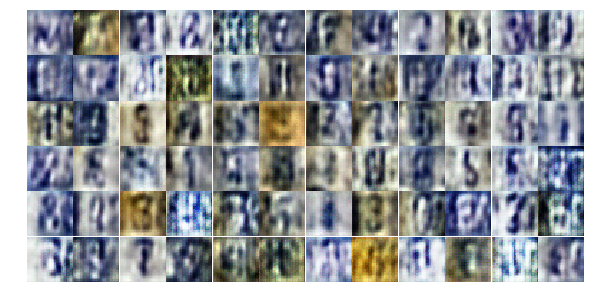

Epoch 2/25... Discriminator Loss: 0.9274... Generator Loss: 1.0933
Epoch 2/25... Discriminator Loss: 1.4941... Generator Loss: 0.6209
Epoch 2/25... Discriminator Loss: 0.9609... Generator Loss: 1.0087
Epoch 2/25... Discriminator Loss: 1.0061... Generator Loss: 1.0971
Epoch 2/25... Discriminator Loss: 1.2679... Generator Loss: 0.7860
Epoch 2/25... Discriminator Loss: 1.5428... Generator Loss: 0.5817
Epoch 2/25... Discriminator Loss: 0.9797... Generator Loss: 1.0173
Epoch 2/25... Discriminator Loss: 1.0581... Generator Loss: 1.2167
Epoch 2/25... Discriminator Loss: 0.9224... Generator Loss: 1.2255
Epoch 2/25... Discriminator Loss: 0.9233... Generator Loss: 1.2615


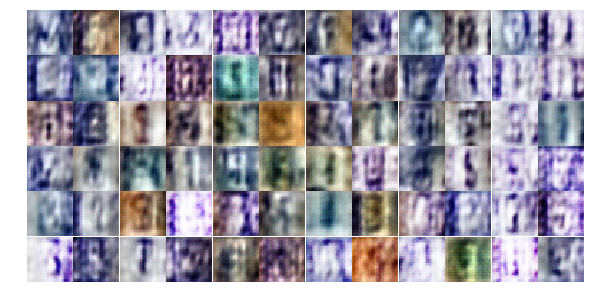

Epoch 2/25... Discriminator Loss: 0.9810... Generator Loss: 0.9623
Epoch 2/25... Discriminator Loss: 1.1011... Generator Loss: 0.9043
Epoch 2/25... Discriminator Loss: 1.7147... Generator Loss: 0.3560
Epoch 2/25... Discriminator Loss: 0.8972... Generator Loss: 1.0933
Epoch 3/25... Discriminator Loss: 1.1286... Generator Loss: 1.8935
Epoch 3/25... Discriminator Loss: 0.9890... Generator Loss: 1.1195
Epoch 3/25... Discriminator Loss: 0.9845... Generator Loss: 1.1917
Epoch 3/25... Discriminator Loss: 0.9735... Generator Loss: 0.9448
Epoch 3/25... Discriminator Loss: 0.9902... Generator Loss: 0.9437
Epoch 3/25... Discriminator Loss: 1.1528... Generator Loss: 0.6946


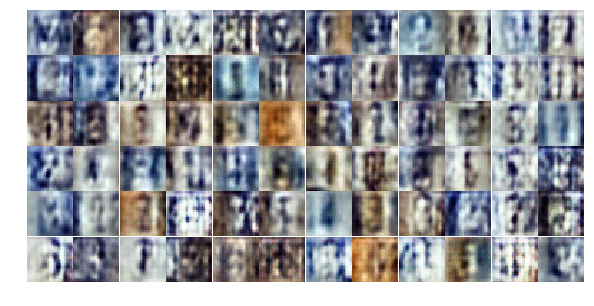

Epoch 3/25... Discriminator Loss: 0.7726... Generator Loss: 1.2708
Epoch 3/25... Discriminator Loss: 0.5842... Generator Loss: 1.3708
Epoch 3/25... Discriminator Loss: 0.8592... Generator Loss: 2.4270
Epoch 3/25... Discriminator Loss: 0.5977... Generator Loss: 1.4394
Epoch 3/25... Discriminator Loss: 1.1919... Generator Loss: 1.0005
Epoch 3/25... Discriminator Loss: 0.7196... Generator Loss: 1.1950
Epoch 3/25... Discriminator Loss: 0.9402... Generator Loss: 1.1638
Epoch 3/25... Discriminator Loss: 0.8096... Generator Loss: 1.4437
Epoch 3/25... Discriminator Loss: 0.8808... Generator Loss: 0.7933
Epoch 3/25... Discriminator Loss: 0.4834... Generator Loss: 2.1337


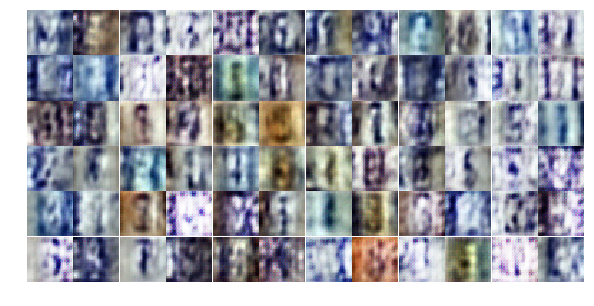

Epoch 3/25... Discriminator Loss: 0.8635... Generator Loss: 1.1973
Epoch 3/25... Discriminator Loss: 0.7659... Generator Loss: 0.9201
Epoch 3/25... Discriminator Loss: 0.5143... Generator Loss: 1.5377
Epoch 3/25... Discriminator Loss: 0.7177... Generator Loss: 1.3087
Epoch 3/25... Discriminator Loss: 0.9118... Generator Loss: 0.9362
Epoch 3/25... Discriminator Loss: 0.5944... Generator Loss: 2.4313
Epoch 3/25... Discriminator Loss: 1.2281... Generator Loss: 2.4808
Epoch 3/25... Discriminator Loss: 0.7218... Generator Loss: 1.1996
Epoch 3/25... Discriminator Loss: 1.2727... Generator Loss: 0.4564
Epoch 3/25... Discriminator Loss: 0.6532... Generator Loss: 1.2552


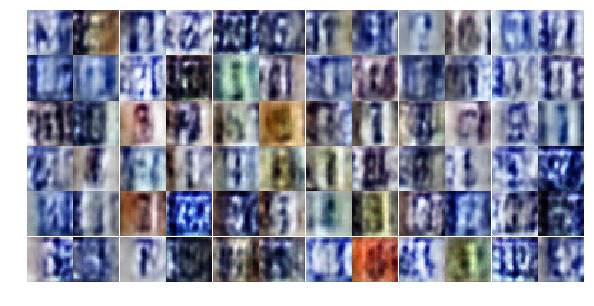

Epoch 3/25... Discriminator Loss: 0.5723... Generator Loss: 1.7376
Epoch 3/25... Discriminator Loss: 0.5527... Generator Loss: 2.9250
Epoch 3/25... Discriminator Loss: 0.6914... Generator Loss: 1.2129
Epoch 3/25... Discriminator Loss: 1.0738... Generator Loss: 1.3282
Epoch 3/25... Discriminator Loss: 0.9231... Generator Loss: 1.8215
Epoch 3/25... Discriminator Loss: 0.9413... Generator Loss: 0.7056
Epoch 3/25... Discriminator Loss: 0.5552... Generator Loss: 1.4327
Epoch 3/25... Discriminator Loss: 1.0701... Generator Loss: 0.5868
Epoch 3/25... Discriminator Loss: 0.6239... Generator Loss: 1.1622
Epoch 3/25... Discriminator Loss: 0.3577... Generator Loss: 2.3858


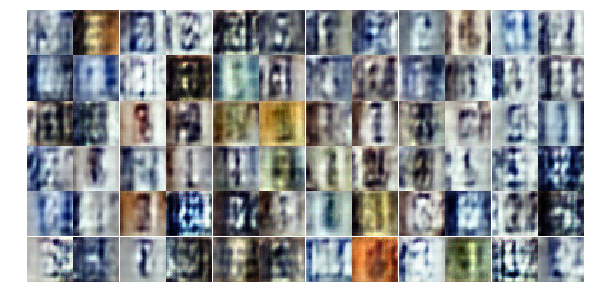

Epoch 3/25... Discriminator Loss: 0.4818... Generator Loss: 1.3425
Epoch 3/25... Discriminator Loss: 1.0181... Generator Loss: 3.3791
Epoch 3/25... Discriminator Loss: 0.3804... Generator Loss: 2.0958
Epoch 3/25... Discriminator Loss: 0.8038... Generator Loss: 0.9450
Epoch 3/25... Discriminator Loss: 0.3519... Generator Loss: 2.2195
Epoch 3/25... Discriminator Loss: 1.5370... Generator Loss: 0.4016
Epoch 3/25... Discriminator Loss: 0.9037... Generator Loss: 0.8097
Epoch 3/25... Discriminator Loss: 0.5757... Generator Loss: 3.7690
Epoch 3/25... Discriminator Loss: 1.2135... Generator Loss: 0.6245
Epoch 3/25... Discriminator Loss: 0.5239... Generator Loss: 1.5974


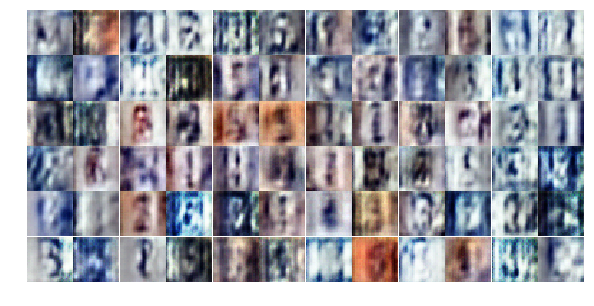

Epoch 3/25... Discriminator Loss: 0.5138... Generator Loss: 1.5404
Epoch 3/25... Discriminator Loss: 0.5237... Generator Loss: 1.9226
Epoch 3/25... Discriminator Loss: 0.7534... Generator Loss: 0.9930
Epoch 3/25... Discriminator Loss: 0.4279... Generator Loss: 1.7751
Epoch 3/25... Discriminator Loss: 0.4554... Generator Loss: 1.6817
Epoch 3/25... Discriminator Loss: 0.3975... Generator Loss: 2.5101
Epoch 3/25... Discriminator Loss: 0.4361... Generator Loss: 2.3840
Epoch 3/25... Discriminator Loss: 0.2590... Generator Loss: 2.6011
Epoch 3/25... Discriminator Loss: 1.1221... Generator Loss: 1.3680
Epoch 3/25... Discriminator Loss: 1.3422... Generator Loss: 0.5646


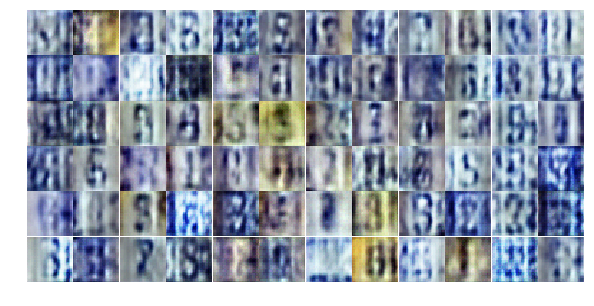

Epoch 3/25... Discriminator Loss: 0.7711... Generator Loss: 0.9771
Epoch 4/25... Discriminator Loss: 0.9791... Generator Loss: 0.8670
Epoch 4/25... Discriminator Loss: 0.6704... Generator Loss: 1.3685
Epoch 4/25... Discriminator Loss: 0.5559... Generator Loss: 1.4609
Epoch 4/25... Discriminator Loss: 0.7732... Generator Loss: 0.8982
Epoch 4/25... Discriminator Loss: 0.6185... Generator Loss: 1.1717
Epoch 4/25... Discriminator Loss: 0.8866... Generator Loss: 3.9541
Epoch 4/25... Discriminator Loss: 0.4185... Generator Loss: 2.6897
Epoch 4/25... Discriminator Loss: 0.5830... Generator Loss: 1.0441
Epoch 4/25... Discriminator Loss: 0.9117... Generator Loss: 3.1936


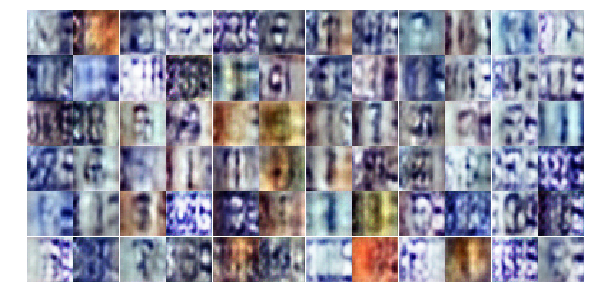

Epoch 4/25... Discriminator Loss: 0.6647... Generator Loss: 1.0929
Epoch 4/25... Discriminator Loss: 0.5929... Generator Loss: 1.6814
Epoch 4/25... Discriminator Loss: 0.6053... Generator Loss: 1.3296
Epoch 4/25... Discriminator Loss: 0.7292... Generator Loss: 1.2375
Epoch 4/25... Discriminator Loss: 0.9296... Generator Loss: 2.3486
Epoch 4/25... Discriminator Loss: 1.5941... Generator Loss: 0.3569
Epoch 4/25... Discriminator Loss: 0.7885... Generator Loss: 1.0565
Epoch 4/25... Discriminator Loss: 0.5006... Generator Loss: 1.7145
Epoch 4/25... Discriminator Loss: 0.9311... Generator Loss: 0.7179
Epoch 4/25... Discriminator Loss: 0.8829... Generator Loss: 2.4072


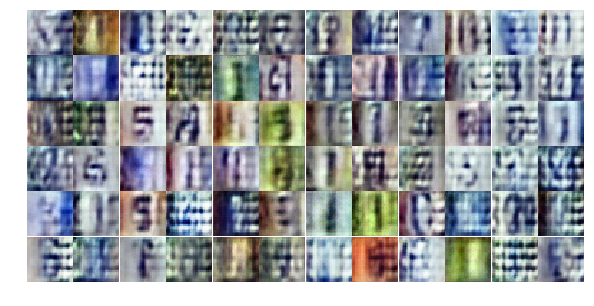

Epoch 4/25... Discriminator Loss: 0.5839... Generator Loss: 1.3350
Epoch 4/25... Discriminator Loss: 0.3561... Generator Loss: 2.1949
Epoch 4/25... Discriminator Loss: 0.4590... Generator Loss: 1.4893
Epoch 4/25... Discriminator Loss: 0.6375... Generator Loss: 1.4057
Epoch 4/25... Discriminator Loss: 0.3293... Generator Loss: 2.0280
Epoch 4/25... Discriminator Loss: 0.7937... Generator Loss: 0.9233
Epoch 4/25... Discriminator Loss: 0.6096... Generator Loss: 1.1494
Epoch 4/25... Discriminator Loss: 0.4034... Generator Loss: 2.2836
Epoch 4/25... Discriminator Loss: 0.4869... Generator Loss: 1.9691
Epoch 4/25... Discriminator Loss: 0.5941... Generator Loss: 1.3635


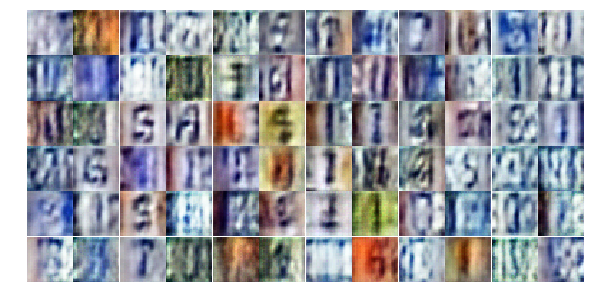

Epoch 4/25... Discriminator Loss: 0.5618... Generator Loss: 1.3395
Epoch 4/25... Discriminator Loss: 0.5004... Generator Loss: 1.6702
Epoch 4/25... Discriminator Loss: 0.4667... Generator Loss: 1.6876
Epoch 4/25... Discriminator Loss: 0.4433... Generator Loss: 2.2270
Epoch 4/25... Discriminator Loss: 0.2828... Generator Loss: 2.8054
Epoch 4/25... Discriminator Loss: 0.7900... Generator Loss: 1.1573
Epoch 4/25... Discriminator Loss: 0.7407... Generator Loss: 2.6108
Epoch 4/25... Discriminator Loss: 0.4279... Generator Loss: 1.8713
Epoch 4/25... Discriminator Loss: 1.0600... Generator Loss: 0.8042
Epoch 4/25... Discriminator Loss: 0.9413... Generator Loss: 0.9714


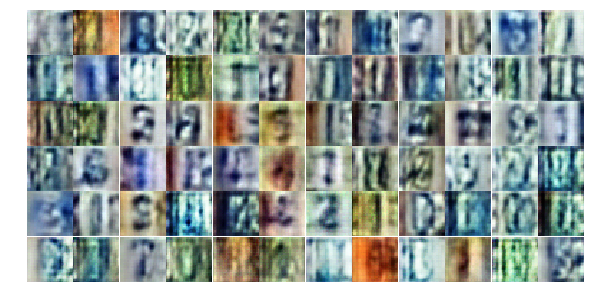

Epoch 4/25... Discriminator Loss: 0.7465... Generator Loss: 1.2514
Epoch 4/25... Discriminator Loss: 0.7089... Generator Loss: 1.0875
Epoch 4/25... Discriminator Loss: 0.7570... Generator Loss: 1.0027
Epoch 4/25... Discriminator Loss: 0.5955... Generator Loss: 2.0492
Epoch 4/25... Discriminator Loss: 0.4318... Generator Loss: 1.9883
Epoch 4/25... Discriminator Loss: 1.0070... Generator Loss: 0.7824
Epoch 4/25... Discriminator Loss: 0.9301... Generator Loss: 0.6948
Epoch 4/25... Discriminator Loss: 0.9752... Generator Loss: 2.4455
Epoch 4/25... Discriminator Loss: 0.8311... Generator Loss: 0.8102
Epoch 4/25... Discriminator Loss: 0.4374... Generator Loss: 2.5274


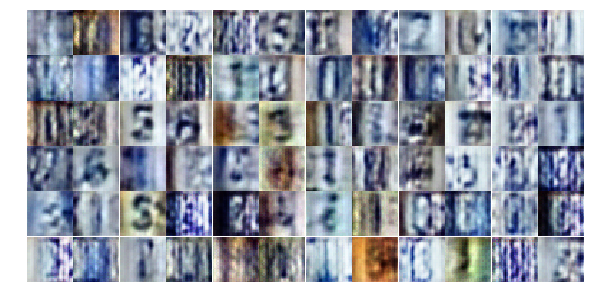

Epoch 4/25... Discriminator Loss: 0.5390... Generator Loss: 1.4359
Epoch 4/25... Discriminator Loss: 0.4384... Generator Loss: 1.5263
Epoch 4/25... Discriminator Loss: 0.6806... Generator Loss: 1.2308
Epoch 4/25... Discriminator Loss: 0.8367... Generator Loss: 0.8213
Epoch 4/25... Discriminator Loss: 0.9098... Generator Loss: 0.8121
Epoch 4/25... Discriminator Loss: 0.5397... Generator Loss: 1.5167
Epoch 4/25... Discriminator Loss: 0.5365... Generator Loss: 1.3805
Epoch 4/25... Discriminator Loss: 1.0258... Generator Loss: 0.5859
Epoch 4/25... Discriminator Loss: 0.5267... Generator Loss: 1.8218
Epoch 5/25... Discriminator Loss: 0.5238... Generator Loss: 2.1162


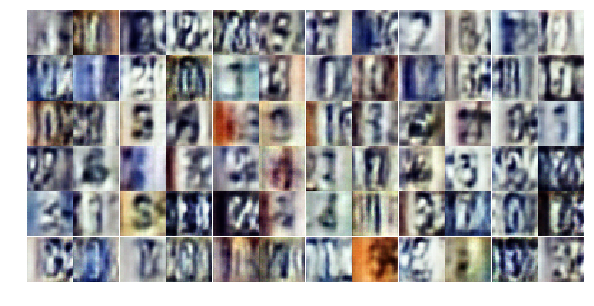

Epoch 5/25... Discriminator Loss: 0.4272... Generator Loss: 2.3881
Epoch 5/25... Discriminator Loss: 0.3404... Generator Loss: 2.6199
Epoch 5/25... Discriminator Loss: 0.5933... Generator Loss: 1.4120
Epoch 5/25... Discriminator Loss: 0.6573... Generator Loss: 0.9485
Epoch 5/25... Discriminator Loss: 0.7096... Generator Loss: 2.9674
Epoch 5/25... Discriminator Loss: 0.6724... Generator Loss: 1.4232
Epoch 5/25... Discriminator Loss: 0.6550... Generator Loss: 0.9943
Epoch 5/25... Discriminator Loss: 0.3865... Generator Loss: 1.8281
Epoch 5/25... Discriminator Loss: 1.4826... Generator Loss: 0.3861
Epoch 5/25... Discriminator Loss: 0.9243... Generator Loss: 0.9331


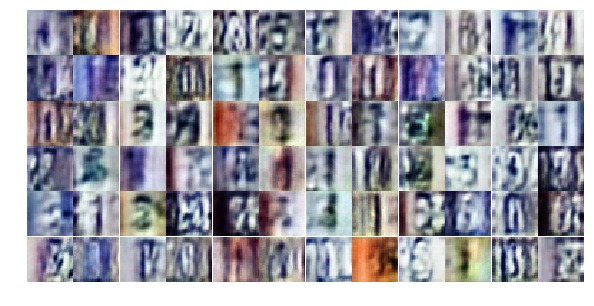

Epoch 5/25... Discriminator Loss: 0.8149... Generator Loss: 0.8427
Epoch 5/25... Discriminator Loss: 0.5693... Generator Loss: 1.2410
Epoch 5/25... Discriminator Loss: 0.4608... Generator Loss: 1.4743
Epoch 5/25... Discriminator Loss: 1.0630... Generator Loss: 0.6786
Epoch 5/25... Discriminator Loss: 0.5009... Generator Loss: 1.9216
Epoch 5/25... Discriminator Loss: 0.6231... Generator Loss: 1.0738
Epoch 5/25... Discriminator Loss: 0.8216... Generator Loss: 0.8017
Epoch 5/25... Discriminator Loss: 0.5334... Generator Loss: 1.3687
Epoch 5/25... Discriminator Loss: 0.3618... Generator Loss: 1.9682
Epoch 5/25... Discriminator Loss: 0.4373... Generator Loss: 1.5641


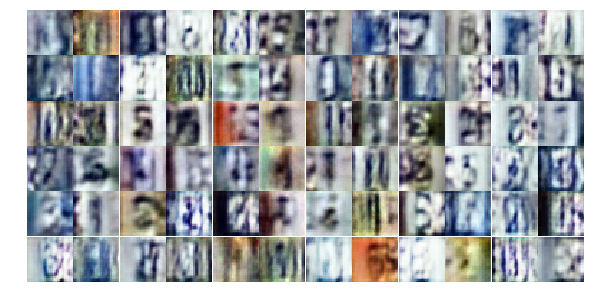

Epoch 5/25... Discriminator Loss: 0.5330... Generator Loss: 1.3512
Epoch 5/25... Discriminator Loss: 1.0875... Generator Loss: 0.7704
Epoch 5/25... Discriminator Loss: 0.6413... Generator Loss: 1.2231
Epoch 5/25... Discriminator Loss: 0.7209... Generator Loss: 0.9611
Epoch 5/25... Discriminator Loss: 0.4722... Generator Loss: 1.4468
Epoch 5/25... Discriminator Loss: 0.5265... Generator Loss: 1.3294
Epoch 5/25... Discriminator Loss: 0.7478... Generator Loss: 0.9236
Epoch 5/25... Discriminator Loss: 0.3819... Generator Loss: 2.6397
Epoch 5/25... Discriminator Loss: 0.7805... Generator Loss: 0.9690
Epoch 5/25... Discriminator Loss: 0.4139... Generator Loss: 1.7483


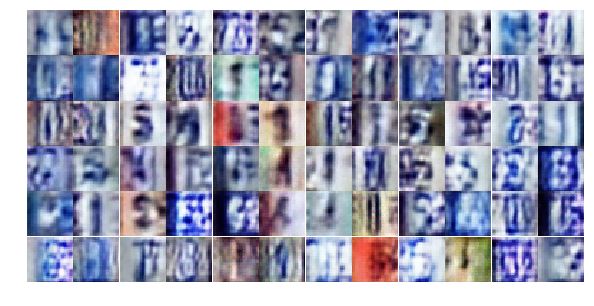

Epoch 5/25... Discriminator Loss: 0.6376... Generator Loss: 2.0366
Epoch 5/25... Discriminator Loss: 0.4040... Generator Loss: 1.7184
Epoch 5/25... Discriminator Loss: 0.6233... Generator Loss: 1.9764
Epoch 5/25... Discriminator Loss: 0.4828... Generator Loss: 1.2774
Epoch 5/25... Discriminator Loss: 0.5481... Generator Loss: 2.4092
Epoch 5/25... Discriminator Loss: 0.3448... Generator Loss: 2.0006
Epoch 5/25... Discriminator Loss: 0.4676... Generator Loss: 1.7855
Epoch 5/25... Discriminator Loss: 0.5844... Generator Loss: 1.1412
Epoch 5/25... Discriminator Loss: 0.6556... Generator Loss: 0.9486
Epoch 5/25... Discriminator Loss: 0.6390... Generator Loss: 1.0614


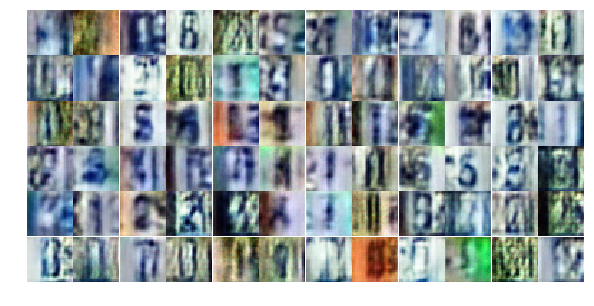

Epoch 5/25... Discriminator Loss: 0.2796... Generator Loss: 2.3986
Epoch 5/25... Discriminator Loss: 0.5666... Generator Loss: 1.1533
Epoch 5/25... Discriminator Loss: 1.1126... Generator Loss: 0.6113
Epoch 5/25... Discriminator Loss: 0.6311... Generator Loss: 1.0631
Epoch 5/25... Discriminator Loss: 0.8973... Generator Loss: 0.8492
Epoch 5/25... Discriminator Loss: 0.7128... Generator Loss: 1.0905
Epoch 5/25... Discriminator Loss: 0.4880... Generator Loss: 1.9568
Epoch 5/25... Discriminator Loss: 0.3729... Generator Loss: 1.7387
Epoch 5/25... Discriminator Loss: 0.6339... Generator Loss: 2.4330
Epoch 5/25... Discriminator Loss: 0.5732... Generator Loss: 3.9938


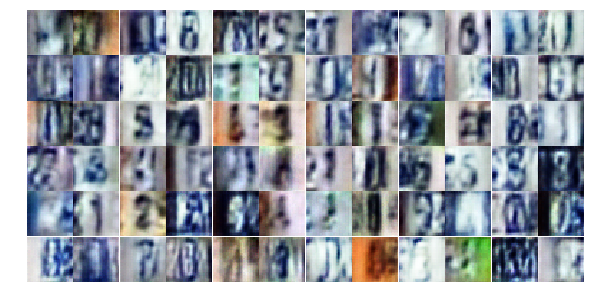

Epoch 5/25... Discriminator Loss: 0.6381... Generator Loss: 1.7049
Epoch 5/25... Discriminator Loss: 0.6334... Generator Loss: 1.3625
Epoch 5/25... Discriminator Loss: 0.6987... Generator Loss: 1.3676
Epoch 5/25... Discriminator Loss: 0.4955... Generator Loss: 1.3762
Epoch 5/25... Discriminator Loss: 0.4093... Generator Loss: 1.6189
Epoch 5/25... Discriminator Loss: 0.5648... Generator Loss: 1.1533
Epoch 6/25... Discriminator Loss: 0.5841... Generator Loss: 1.1795
Epoch 6/25... Discriminator Loss: 0.3340... Generator Loss: 1.7170
Epoch 6/25... Discriminator Loss: 1.1217... Generator Loss: 0.5191
Epoch 6/25... Discriminator Loss: 0.9186... Generator Loss: 0.6927


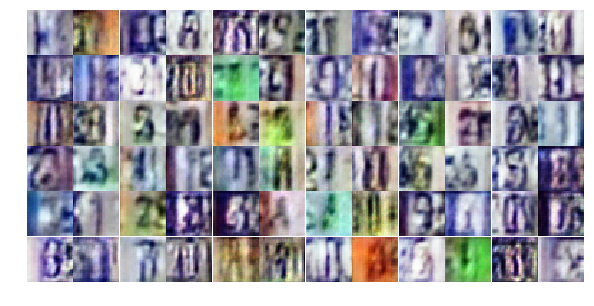

Epoch 6/25... Discriminator Loss: 0.4856... Generator Loss: 1.4275
Epoch 6/25... Discriminator Loss: 0.7015... Generator Loss: 2.1103
Epoch 6/25... Discriminator Loss: 0.5450... Generator Loss: 1.2049
Epoch 6/25... Discriminator Loss: 1.1831... Generator Loss: 3.2867
Epoch 6/25... Discriminator Loss: 0.7937... Generator Loss: 0.8726
Epoch 6/25... Discriminator Loss: 0.5096... Generator Loss: 1.2572
Epoch 6/25... Discriminator Loss: 0.5444... Generator Loss: 1.3275
Epoch 6/25... Discriminator Loss: 0.7579... Generator Loss: 0.8580
Epoch 6/25... Discriminator Loss: 0.5807... Generator Loss: 1.0358
Epoch 6/25... Discriminator Loss: 0.5768... Generator Loss: 1.5187


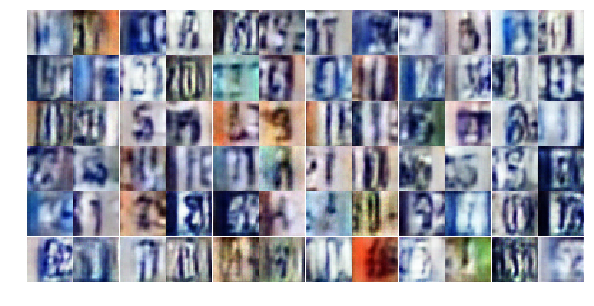

Epoch 6/25... Discriminator Loss: 1.1691... Generator Loss: 0.7457
Epoch 6/25... Discriminator Loss: 0.8104... Generator Loss: 2.4595
Epoch 6/25... Discriminator Loss: 0.7389... Generator Loss: 0.8849
Epoch 6/25... Discriminator Loss: 0.5735... Generator Loss: 1.1712
Epoch 6/25... Discriminator Loss: 0.5767... Generator Loss: 1.1908
Epoch 6/25... Discriminator Loss: 0.4548... Generator Loss: 1.3350
Epoch 6/25... Discriminator Loss: 0.5279... Generator Loss: 1.3949
Epoch 6/25... Discriminator Loss: 0.6444... Generator Loss: 1.0227
Epoch 6/25... Discriminator Loss: 0.8793... Generator Loss: 2.7973
Epoch 6/25... Discriminator Loss: 0.7983... Generator Loss: 1.7038


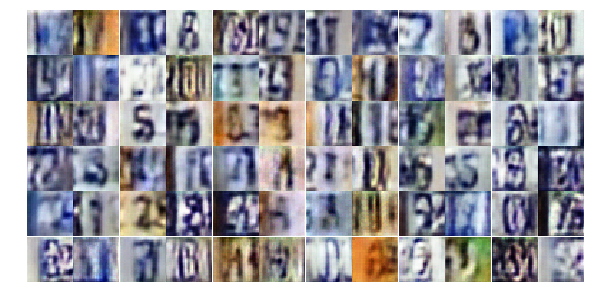

Epoch 6/25... Discriminator Loss: 0.8725... Generator Loss: 0.7829
Epoch 6/25... Discriminator Loss: 0.5240... Generator Loss: 1.4736
Epoch 6/25... Discriminator Loss: 1.1579... Generator Loss: 0.5495
Epoch 6/25... Discriminator Loss: 0.7258... Generator Loss: 0.9060
Epoch 6/25... Discriminator Loss: 0.5233... Generator Loss: 1.2996
Epoch 6/25... Discriminator Loss: 0.7845... Generator Loss: 0.8693
Epoch 6/25... Discriminator Loss: 0.5834... Generator Loss: 2.1642
Epoch 6/25... Discriminator Loss: 0.4075... Generator Loss: 2.6593
Epoch 6/25... Discriminator Loss: 0.6096... Generator Loss: 1.7689
Epoch 6/25... Discriminator Loss: 0.5645... Generator Loss: 1.2066


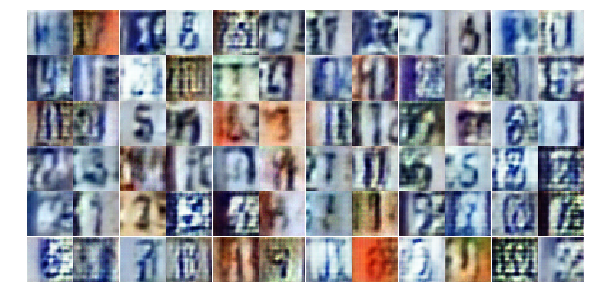

Epoch 6/25... Discriminator Loss: 0.8783... Generator Loss: 2.1013
Epoch 6/25... Discriminator Loss: 0.8769... Generator Loss: 3.2310
Epoch 6/25... Discriminator Loss: 0.8335... Generator Loss: 0.7851
Epoch 6/25... Discriminator Loss: 0.4972... Generator Loss: 1.3326
Epoch 6/25... Discriminator Loss: 0.5737... Generator Loss: 1.2216
Epoch 6/25... Discriminator Loss: 0.5216... Generator Loss: 1.2730
Epoch 6/25... Discriminator Loss: 0.4714... Generator Loss: 1.3851
Epoch 6/25... Discriminator Loss: 0.3985... Generator Loss: 2.5222
Epoch 6/25... Discriminator Loss: 1.4126... Generator Loss: 0.4214
Epoch 6/25... Discriminator Loss: 0.4911... Generator Loss: 1.4552


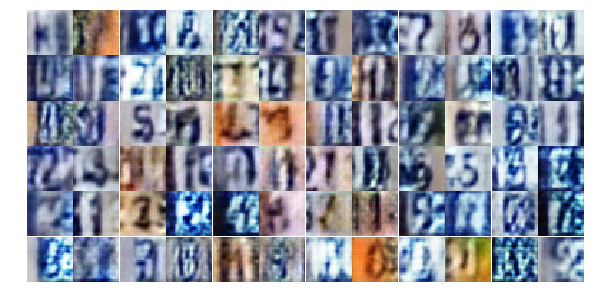

Epoch 6/25... Discriminator Loss: 0.4757... Generator Loss: 2.0472
Epoch 6/25... Discriminator Loss: 0.8109... Generator Loss: 2.0262
Epoch 6/25... Discriminator Loss: 0.6191... Generator Loss: 2.0005
Epoch 6/25... Discriminator Loss: 0.4450... Generator Loss: 1.5300
Epoch 6/25... Discriminator Loss: 0.4572... Generator Loss: 1.5594
Epoch 6/25... Discriminator Loss: 0.3648... Generator Loss: 1.5847
Epoch 6/25... Discriminator Loss: 0.8528... Generator Loss: 0.7455
Epoch 6/25... Discriminator Loss: 0.5763... Generator Loss: 1.2376
Epoch 6/25... Discriminator Loss: 0.9557... Generator Loss: 1.3931
Epoch 6/25... Discriminator Loss: 1.3426... Generator Loss: 0.4547


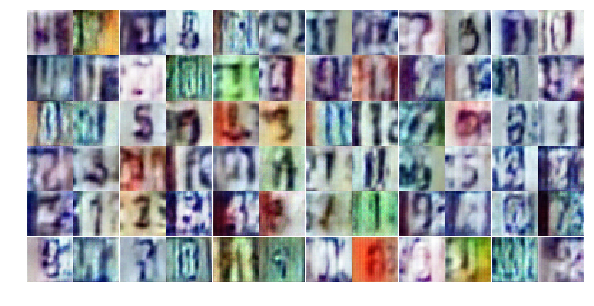

Epoch 6/25... Discriminator Loss: 1.1046... Generator Loss: 0.5802
Epoch 6/25... Discriminator Loss: 0.5994... Generator Loss: 1.2496
Epoch 6/25... Discriminator Loss: 0.6221... Generator Loss: 1.3314
Epoch 7/25... Discriminator Loss: 0.7073... Generator Loss: 1.0245
Epoch 7/25... Discriminator Loss: 0.8135... Generator Loss: 0.8560
Epoch 7/25... Discriminator Loss: 0.6499... Generator Loss: 1.0126
Epoch 7/25... Discriminator Loss: 0.8607... Generator Loss: 0.7604
Epoch 7/25... Discriminator Loss: 0.5291... Generator Loss: 1.3627
Epoch 7/25... Discriminator Loss: 0.4218... Generator Loss: 1.8909
Epoch 7/25... Discriminator Loss: 0.5495... Generator Loss: 1.2779


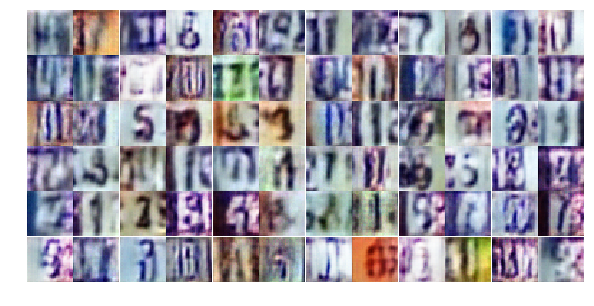

Epoch 7/25... Discriminator Loss: 0.4818... Generator Loss: 1.5572
Epoch 7/25... Discriminator Loss: 0.7353... Generator Loss: 0.9623
Epoch 7/25... Discriminator Loss: 1.1298... Generator Loss: 0.5138
Epoch 7/25... Discriminator Loss: 0.6166... Generator Loss: 1.9416
Epoch 7/25... Discriminator Loss: 0.4200... Generator Loss: 1.5329
Epoch 7/25... Discriminator Loss: 0.7037... Generator Loss: 2.7149
Epoch 7/25... Discriminator Loss: 0.7709... Generator Loss: 1.9862
Epoch 7/25... Discriminator Loss: 0.7617... Generator Loss: 2.3125
Epoch 7/25... Discriminator Loss: 0.8798... Generator Loss: 2.7568
Epoch 7/25... Discriminator Loss: 1.0032... Generator Loss: 0.6906


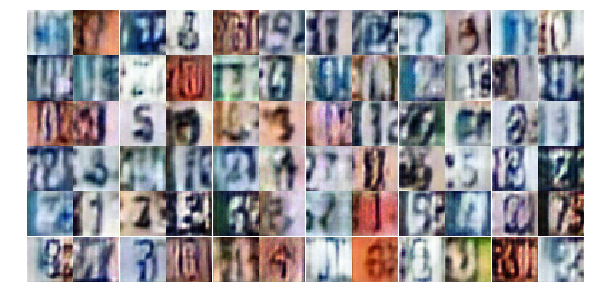

Epoch 7/25... Discriminator Loss: 0.6595... Generator Loss: 1.0758
Epoch 7/25... Discriminator Loss: 0.7085... Generator Loss: 0.9588
Epoch 7/25... Discriminator Loss: 0.7072... Generator Loss: 1.5363
Epoch 7/25... Discriminator Loss: 0.5596... Generator Loss: 1.6637
Epoch 7/25... Discriminator Loss: 0.4352... Generator Loss: 1.4820
Epoch 7/25... Discriminator Loss: 0.6649... Generator Loss: 2.3995
Epoch 7/25... Discriminator Loss: 0.6623... Generator Loss: 1.0541
Epoch 7/25... Discriminator Loss: 1.1119... Generator Loss: 0.5129
Epoch 7/25... Discriminator Loss: 0.3153... Generator Loss: 2.2544
Epoch 7/25... Discriminator Loss: 0.5669... Generator Loss: 1.1085


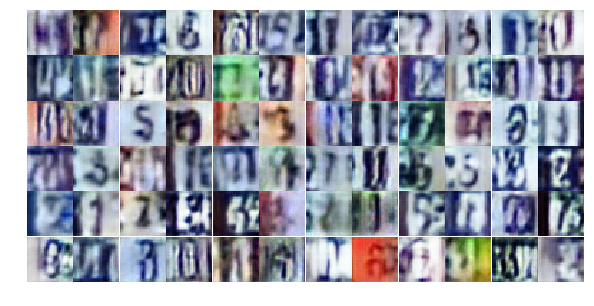

Epoch 7/25... Discriminator Loss: 2.2851... Generator Loss: 0.2699
Epoch 7/25... Discriminator Loss: 0.6817... Generator Loss: 1.1457
Epoch 7/25... Discriminator Loss: 0.6684... Generator Loss: 1.0336
Epoch 7/25... Discriminator Loss: 0.5572... Generator Loss: 1.3470
Epoch 7/25... Discriminator Loss: 0.8830... Generator Loss: 0.7112
Epoch 7/25... Discriminator Loss: 0.7924... Generator Loss: 0.8524
Epoch 7/25... Discriminator Loss: 0.4617... Generator Loss: 1.4430
Epoch 7/25... Discriminator Loss: 0.6755... Generator Loss: 0.9896
Epoch 7/25... Discriminator Loss: 1.1459... Generator Loss: 0.4944
Epoch 7/25... Discriminator Loss: 0.5925... Generator Loss: 2.1225


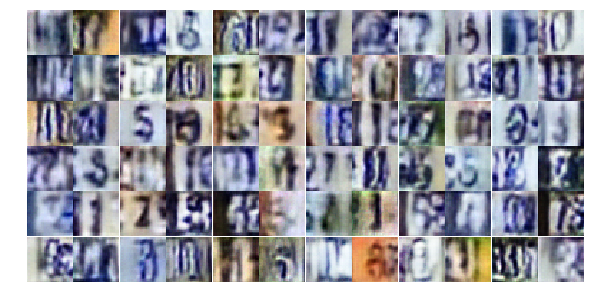

Epoch 7/25... Discriminator Loss: 0.9220... Generator Loss: 0.8004
Epoch 7/25... Discriminator Loss: 0.5962... Generator Loss: 1.4270
Epoch 7/25... Discriminator Loss: 0.4191... Generator Loss: 1.9216
Epoch 7/25... Discriminator Loss: 0.5827... Generator Loss: 1.1370
Epoch 7/25... Discriminator Loss: 0.7829... Generator Loss: 0.8585
Epoch 7/25... Discriminator Loss: 0.5691... Generator Loss: 1.4187
Epoch 7/25... Discriminator Loss: 0.4742... Generator Loss: 1.3045
Epoch 7/25... Discriminator Loss: 0.9148... Generator Loss: 0.9744
Epoch 7/25... Discriminator Loss: 0.3214... Generator Loss: 1.9372
Epoch 7/25... Discriminator Loss: 0.6391... Generator Loss: 1.8574


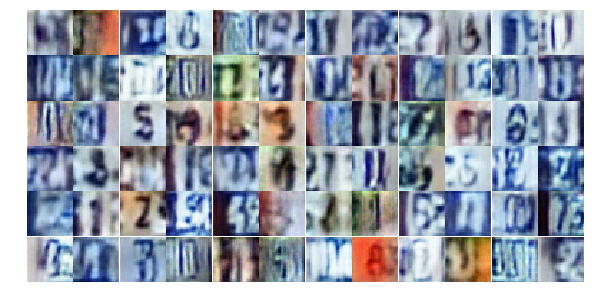

Epoch 7/25... Discriminator Loss: 0.2879... Generator Loss: 2.0587
Epoch 7/25... Discriminator Loss: 0.7369... Generator Loss: 0.8624
Epoch 7/25... Discriminator Loss: 0.5543... Generator Loss: 1.4616
Epoch 7/25... Discriminator Loss: 0.8238... Generator Loss: 0.7692
Epoch 7/25... Discriminator Loss: 0.6415... Generator Loss: 1.0020
Epoch 7/25... Discriminator Loss: 0.7925... Generator Loss: 1.0652
Epoch 7/25... Discriminator Loss: 1.8454... Generator Loss: 0.2682
Epoch 7/25... Discriminator Loss: 0.5413... Generator Loss: 1.7788
Epoch 7/25... Discriminator Loss: 0.9937... Generator Loss: 0.8144
Epoch 7/25... Discriminator Loss: 0.4886... Generator Loss: 1.2629


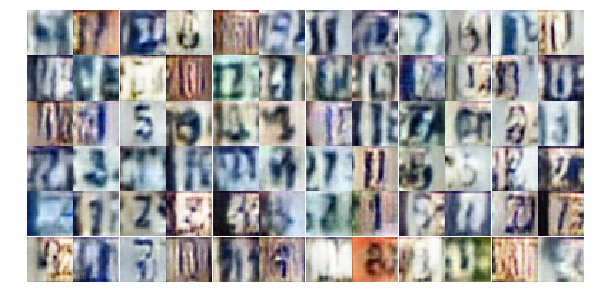

Epoch 7/25... Discriminator Loss: 0.4598... Generator Loss: 1.8786
Epoch 8/25... Discriminator Loss: 0.5094... Generator Loss: 1.3099
Epoch 8/25... Discriminator Loss: 0.6791... Generator Loss: 1.0636
Epoch 8/25... Discriminator Loss: 0.5685... Generator Loss: 1.1819
Epoch 8/25... Discriminator Loss: 0.6318... Generator Loss: 1.6969
Epoch 8/25... Discriminator Loss: 0.8915... Generator Loss: 2.1007
Epoch 8/25... Discriminator Loss: 0.7088... Generator Loss: 1.2376
Epoch 8/25... Discriminator Loss: 0.4964... Generator Loss: 1.3904
Epoch 8/25... Discriminator Loss: 0.7113... Generator Loss: 1.1283
Epoch 8/25... Discriminator Loss: 0.6796... Generator Loss: 1.0213


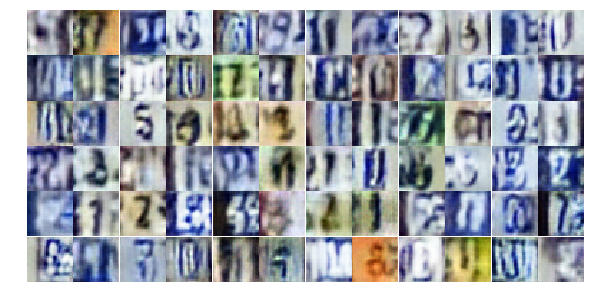

Epoch 8/25... Discriminator Loss: 0.3473... Generator Loss: 2.0220
Epoch 8/25... Discriminator Loss: 0.4365... Generator Loss: 1.4380
Epoch 8/25... Discriminator Loss: 0.7595... Generator Loss: 1.6251
Epoch 8/25... Discriminator Loss: 0.3560... Generator Loss: 1.7582
Epoch 8/25... Discriminator Loss: 1.0002... Generator Loss: 0.5939
Epoch 8/25... Discriminator Loss: 0.6607... Generator Loss: 2.5053
Epoch 8/25... Discriminator Loss: 0.4135... Generator Loss: 1.6693
Epoch 8/25... Discriminator Loss: 0.5275... Generator Loss: 1.6718
Epoch 8/25... Discriminator Loss: 0.4571... Generator Loss: 1.5635
Epoch 8/25... Discriminator Loss: 0.9790... Generator Loss: 0.9882


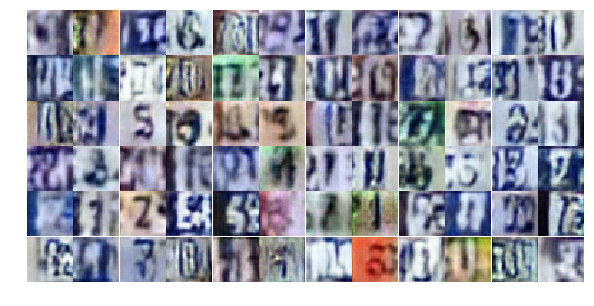

Epoch 8/25... Discriminator Loss: 0.4359... Generator Loss: 1.9530
Epoch 8/25... Discriminator Loss: 0.5509... Generator Loss: 1.3360
Epoch 8/25... Discriminator Loss: 1.1326... Generator Loss: 2.6899
Epoch 8/25... Discriminator Loss: 0.8616... Generator Loss: 0.8556
Epoch 8/25... Discriminator Loss: 0.4135... Generator Loss: 2.1524
Epoch 8/25... Discriminator Loss: 0.6192... Generator Loss: 1.1586
Epoch 8/25... Discriminator Loss: 0.5684... Generator Loss: 1.7785
Epoch 8/25... Discriminator Loss: 1.6021... Generator Loss: 3.8232
Epoch 8/25... Discriminator Loss: 0.9442... Generator Loss: 2.5040
Epoch 8/25... Discriminator Loss: 0.8884... Generator Loss: 0.7962


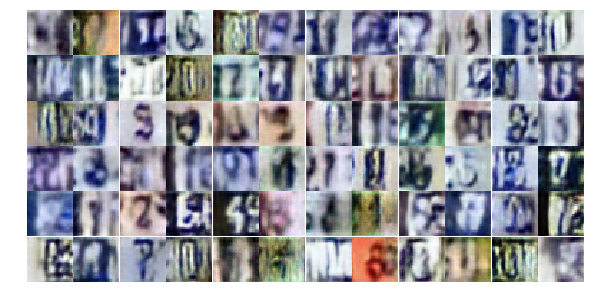

Epoch 8/25... Discriminator Loss: 0.6201... Generator Loss: 1.1744
Epoch 8/25... Discriminator Loss: 1.1179... Generator Loss: 0.5185
Epoch 8/25... Discriminator Loss: 0.6086... Generator Loss: 1.1837
Epoch 8/25... Discriminator Loss: 0.9972... Generator Loss: 0.6058
Epoch 8/25... Discriminator Loss: 1.1593... Generator Loss: 0.5532
Epoch 8/25... Discriminator Loss: 0.4192... Generator Loss: 1.5446
Epoch 8/25... Discriminator Loss: 0.5749... Generator Loss: 1.1792
Epoch 8/25... Discriminator Loss: 0.8223... Generator Loss: 0.7996
Epoch 8/25... Discriminator Loss: 0.6404... Generator Loss: 1.1455
Epoch 8/25... Discriminator Loss: 0.5936... Generator Loss: 1.1309


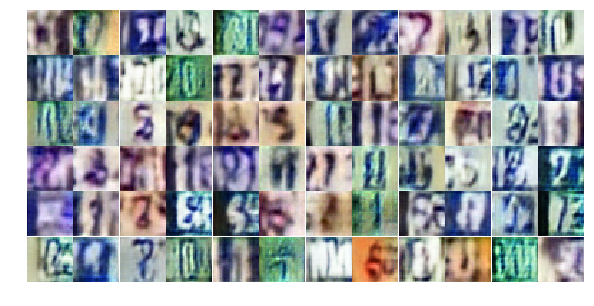

Epoch 8/25... Discriminator Loss: 0.4329... Generator Loss: 1.5389
Epoch 8/25... Discriminator Loss: 1.1197... Generator Loss: 2.2478
Epoch 8/25... Discriminator Loss: 0.5585... Generator Loss: 1.1803
Epoch 8/25... Discriminator Loss: 0.5992... Generator Loss: 1.2026
Epoch 8/25... Discriminator Loss: 0.7118... Generator Loss: 2.0752
Epoch 8/25... Discriminator Loss: 1.3653... Generator Loss: 0.3797
Epoch 8/25... Discriminator Loss: 1.1313... Generator Loss: 0.5580
Epoch 8/25... Discriminator Loss: 0.3874... Generator Loss: 1.7971
Epoch 8/25... Discriminator Loss: 0.5674... Generator Loss: 1.6472
Epoch 8/25... Discriminator Loss: 0.5455... Generator Loss: 1.3331


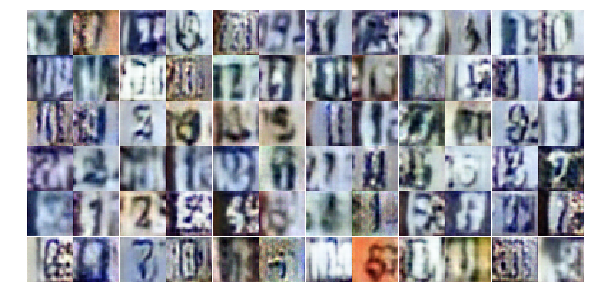

Epoch 8/25... Discriminator Loss: 0.5748... Generator Loss: 1.1150
Epoch 8/25... Discriminator Loss: 0.3168... Generator Loss: 2.0312
Epoch 8/25... Discriminator Loss: 0.8159... Generator Loss: 0.9055
Epoch 8/25... Discriminator Loss: 0.9426... Generator Loss: 0.8019
Epoch 8/25... Discriminator Loss: 0.5010... Generator Loss: 2.2841
Epoch 8/25... Discriminator Loss: 0.8589... Generator Loss: 1.5212
Epoch 8/25... Discriminator Loss: 0.7004... Generator Loss: 2.7411
Epoch 8/25... Discriminator Loss: 0.7125... Generator Loss: 2.0414
Epoch 9/25... Discriminator Loss: 0.7318... Generator Loss: 1.4326
Epoch 9/25... Discriminator Loss: 0.7169... Generator Loss: 1.0682


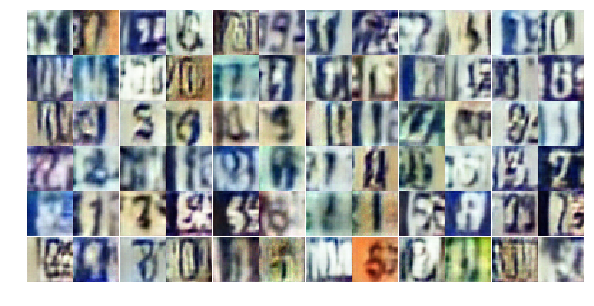

Epoch 9/25... Discriminator Loss: 0.6385... Generator Loss: 1.2229
Epoch 9/25... Discriminator Loss: 0.8809... Generator Loss: 0.8331
Epoch 9/25... Discriminator Loss: 0.9577... Generator Loss: 0.7150
Epoch 9/25... Discriminator Loss: 0.4358... Generator Loss: 1.9090
Epoch 9/25... Discriminator Loss: 0.9054... Generator Loss: 0.6793
Epoch 9/25... Discriminator Loss: 0.6245... Generator Loss: 1.4657
Epoch 9/25... Discriminator Loss: 0.6809... Generator Loss: 1.5002
Epoch 9/25... Discriminator Loss: 0.5363... Generator Loss: 1.3566
Epoch 9/25... Discriminator Loss: 0.7855... Generator Loss: 0.8698
Epoch 9/25... Discriminator Loss: 0.6029... Generator Loss: 1.1432


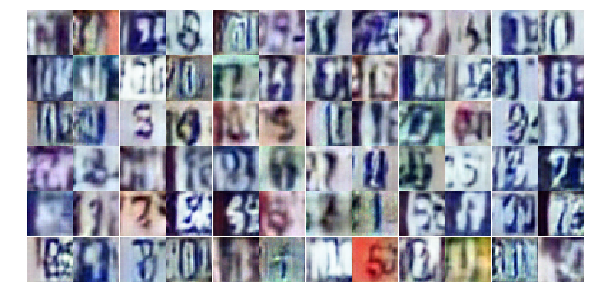

Epoch 9/25... Discriminator Loss: 0.7130... Generator Loss: 1.0436
Epoch 9/25... Discriminator Loss: 0.8973... Generator Loss: 0.8705
Epoch 9/25... Discriminator Loss: 0.7366... Generator Loss: 1.8840
Epoch 9/25... Discriminator Loss: 0.8528... Generator Loss: 0.7471
Epoch 9/25... Discriminator Loss: 0.5495... Generator Loss: 1.4509
Epoch 9/25... Discriminator Loss: 0.7484... Generator Loss: 1.5933
Epoch 9/25... Discriminator Loss: 0.9823... Generator Loss: 0.6774
Epoch 9/25... Discriminator Loss: 0.7106... Generator Loss: 0.9529
Epoch 9/25... Discriminator Loss: 0.9450... Generator Loss: 0.6285
Epoch 9/25... Discriminator Loss: 0.7627... Generator Loss: 0.8627


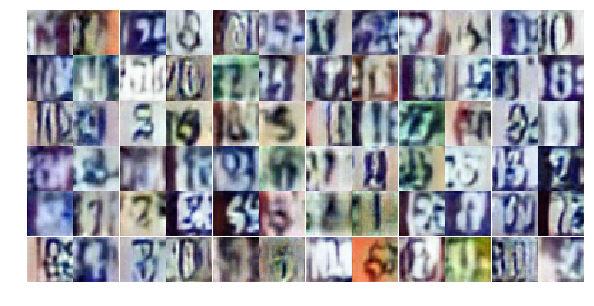

Epoch 9/25... Discriminator Loss: 0.8457... Generator Loss: 1.0933
Epoch 9/25... Discriminator Loss: 0.8285... Generator Loss: 0.8153
Epoch 9/25... Discriminator Loss: 0.4681... Generator Loss: 1.6722
Epoch 9/25... Discriminator Loss: 0.5484... Generator Loss: 1.2279
Epoch 9/25... Discriminator Loss: 0.6712... Generator Loss: 3.2340
Epoch 9/25... Discriminator Loss: 0.6525... Generator Loss: 1.0718
Epoch 9/25... Discriminator Loss: 0.6538... Generator Loss: 1.1807
Epoch 9/25... Discriminator Loss: 0.3811... Generator Loss: 1.7338
Epoch 9/25... Discriminator Loss: 0.5244... Generator Loss: 1.2148
Epoch 9/25... Discriminator Loss: 0.5662... Generator Loss: 1.1000


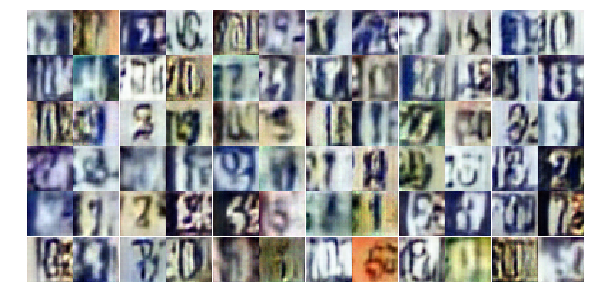

Epoch 9/25... Discriminator Loss: 0.6362... Generator Loss: 1.0446
Epoch 9/25... Discriminator Loss: 0.3727... Generator Loss: 1.9901
Epoch 9/25... Discriminator Loss: 1.3541... Generator Loss: 0.5116
Epoch 9/25... Discriminator Loss: 0.7035... Generator Loss: 1.5250
Epoch 9/25... Discriminator Loss: 0.6219... Generator Loss: 1.2488
Epoch 9/25... Discriminator Loss: 0.4746... Generator Loss: 1.5199
Epoch 9/25... Discriminator Loss: 0.5555... Generator Loss: 1.1444
Epoch 9/25... Discriminator Loss: 0.3888... Generator Loss: 1.7888
Epoch 9/25... Discriminator Loss: 0.8419... Generator Loss: 0.8388
Epoch 9/25... Discriminator Loss: 0.6407... Generator Loss: 1.0178


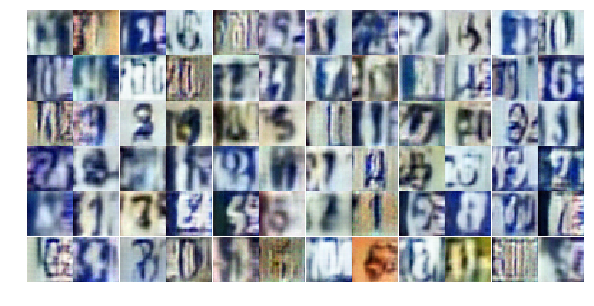

Epoch 9/25... Discriminator Loss: 0.5499... Generator Loss: 1.5260
Epoch 9/25... Discriminator Loss: 0.3241... Generator Loss: 1.8080
Epoch 9/25... Discriminator Loss: 0.5292... Generator Loss: 2.2949
Epoch 9/25... Discriminator Loss: 1.0965... Generator Loss: 0.7259
Epoch 9/25... Discriminator Loss: 0.5922... Generator Loss: 2.9085
Epoch 9/25... Discriminator Loss: 0.6216... Generator Loss: 1.5360
Epoch 9/25... Discriminator Loss: 0.9051... Generator Loss: 0.7396
Epoch 9/25... Discriminator Loss: 0.7294... Generator Loss: 0.8714
Epoch 9/25... Discriminator Loss: 0.4502... Generator Loss: 1.5284
Epoch 9/25... Discriminator Loss: 0.5489... Generator Loss: 2.6023


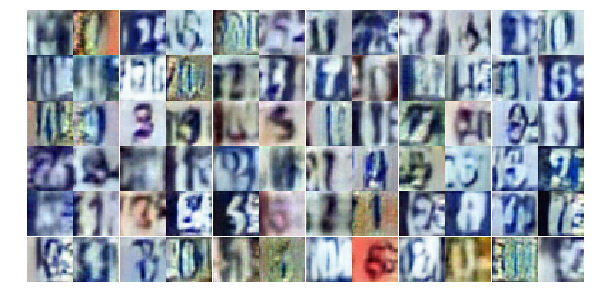

Epoch 9/25... Discriminator Loss: 2.1605... Generator Loss: 0.2271
Epoch 9/25... Discriminator Loss: 0.6262... Generator Loss: 2.1103
Epoch 9/25... Discriminator Loss: 0.6668... Generator Loss: 1.1442
Epoch 9/25... Discriminator Loss: 1.1350... Generator Loss: 0.5158
Epoch 9/25... Discriminator Loss: 0.8102... Generator Loss: 0.8334
Epoch 10/25... Discriminator Loss: 0.5779... Generator Loss: 1.4004
Epoch 10/25... Discriminator Loss: 0.5859... Generator Loss: 1.1504
Epoch 10/25... Discriminator Loss: 0.7261... Generator Loss: 0.9957
Epoch 10/25... Discriminator Loss: 0.7390... Generator Loss: 0.8977
Epoch 10/25... Discriminator Loss: 1.2581... Generator Loss: 0.4403


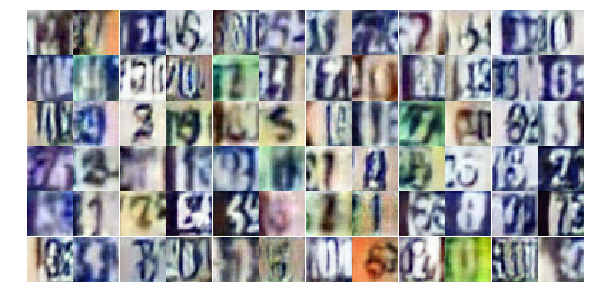

Epoch 10/25... Discriminator Loss: 0.6134... Generator Loss: 1.0778
Epoch 10/25... Discriminator Loss: 0.4458... Generator Loss: 1.4002
Epoch 10/25... Discriminator Loss: 0.4784... Generator Loss: 1.4289
Epoch 10/25... Discriminator Loss: 0.5913... Generator Loss: 1.5373
Epoch 10/25... Discriminator Loss: 0.6687... Generator Loss: 1.9313
Epoch 10/25... Discriminator Loss: 0.7470... Generator Loss: 0.9815
Epoch 10/25... Discriminator Loss: 0.5246... Generator Loss: 1.3215
Epoch 10/25... Discriminator Loss: 1.0060... Generator Loss: 0.6255
Epoch 10/25... Discriminator Loss: 1.0891... Generator Loss: 0.6225
Epoch 10/25... Discriminator Loss: 0.8223... Generator Loss: 0.8684


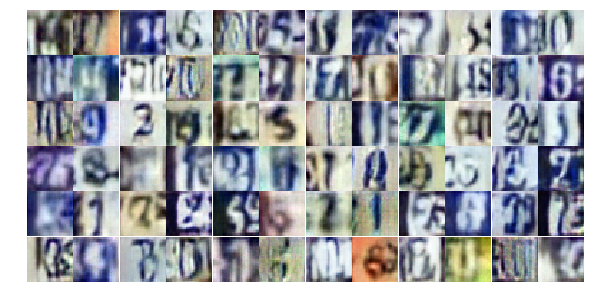

Epoch 10/25... Discriminator Loss: 0.6260... Generator Loss: 1.3841
Epoch 10/25... Discriminator Loss: 1.1037... Generator Loss: 0.5721
Epoch 10/25... Discriminator Loss: 0.8941... Generator Loss: 1.9541
Epoch 10/25... Discriminator Loss: 0.9627... Generator Loss: 0.6630
Epoch 10/25... Discriminator Loss: 0.9380... Generator Loss: 2.9320
Epoch 10/25... Discriminator Loss: 0.5898... Generator Loss: 1.1641
Epoch 10/25... Discriminator Loss: 0.7656... Generator Loss: 0.8854
Epoch 10/25... Discriminator Loss: 0.5747... Generator Loss: 1.2442
Epoch 10/25... Discriminator Loss: 0.6449... Generator Loss: 0.9656
Epoch 10/25... Discriminator Loss: 0.2731... Generator Loss: 2.4936


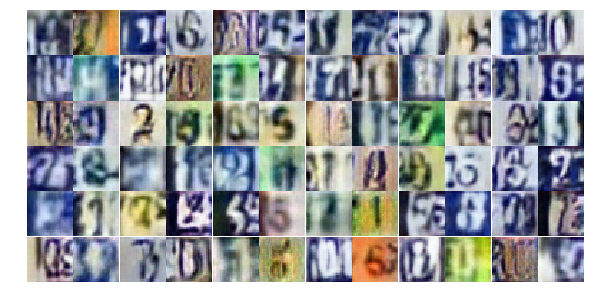

Epoch 10/25... Discriminator Loss: 1.1702... Generator Loss: 0.4937
Epoch 10/25... Discriminator Loss: 0.8653... Generator Loss: 0.7388
Epoch 10/25... Discriminator Loss: 0.4748... Generator Loss: 1.3674
Epoch 10/25... Discriminator Loss: 0.4439... Generator Loss: 1.4743
Epoch 10/25... Discriminator Loss: 1.4299... Generator Loss: 0.3641
Epoch 10/25... Discriminator Loss: 0.6701... Generator Loss: 1.0412
Epoch 10/25... Discriminator Loss: 0.3820... Generator Loss: 2.0730
Epoch 10/25... Discriminator Loss: 0.6012... Generator Loss: 1.4623
Epoch 10/25... Discriminator Loss: 0.5298... Generator Loss: 1.2047
Epoch 10/25... Discriminator Loss: 0.7871... Generator Loss: 0.8558


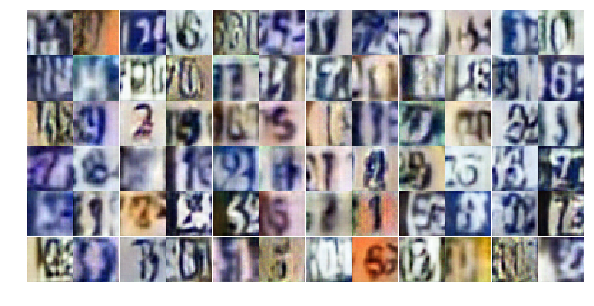

Epoch 10/25... Discriminator Loss: 0.5591... Generator Loss: 1.4348
Epoch 10/25... Discriminator Loss: 1.3314... Generator Loss: 0.4844
Epoch 10/25... Discriminator Loss: 0.5117... Generator Loss: 2.4675
Epoch 10/25... Discriminator Loss: 0.6121... Generator Loss: 1.3435
Epoch 10/25... Discriminator Loss: 0.6343... Generator Loss: 1.0668
Epoch 10/25... Discriminator Loss: 0.6126... Generator Loss: 1.1904
Epoch 10/25... Discriminator Loss: 0.8038... Generator Loss: 0.8584
Epoch 10/25... Discriminator Loss: 0.7978... Generator Loss: 0.7975
Epoch 10/25... Discriminator Loss: 0.8598... Generator Loss: 0.7376
Epoch 10/25... Discriminator Loss: 1.3430... Generator Loss: 2.4923


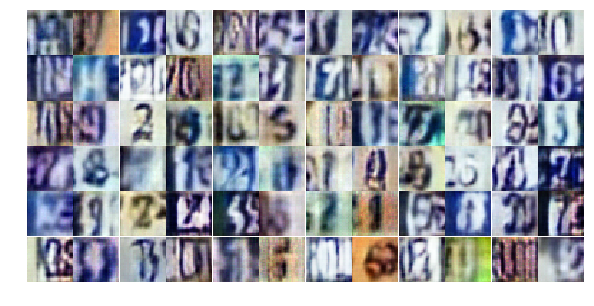

Epoch 10/25... Discriminator Loss: 0.9106... Generator Loss: 1.0305
Epoch 10/25... Discriminator Loss: 0.9481... Generator Loss: 1.2081
Epoch 10/25... Discriminator Loss: 0.9553... Generator Loss: 0.7230
Epoch 10/25... Discriminator Loss: 1.1145... Generator Loss: 0.5482
Epoch 10/25... Discriminator Loss: 0.5795... Generator Loss: 1.8657
Epoch 10/25... Discriminator Loss: 0.8364... Generator Loss: 0.7988
Epoch 10/25... Discriminator Loss: 0.6432... Generator Loss: 1.2153
Epoch 10/25... Discriminator Loss: 0.4317... Generator Loss: 1.8272
Epoch 10/25... Discriminator Loss: 0.6200... Generator Loss: 1.7058
Epoch 10/25... Discriminator Loss: 0.5256... Generator Loss: 1.3580


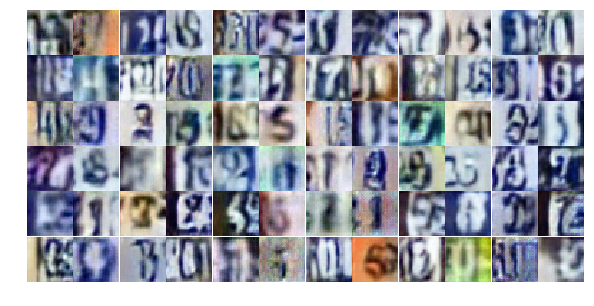

Epoch 10/25... Discriminator Loss: 0.6403... Generator Loss: 1.2051
Epoch 10/25... Discriminator Loss: 0.8356... Generator Loss: 0.8161
Epoch 10/25... Discriminator Loss: 0.6180... Generator Loss: 1.1136
Epoch 11/25... Discriminator Loss: 0.6408... Generator Loss: 1.5875
Epoch 11/25... Discriminator Loss: 0.5979... Generator Loss: 1.3735
Epoch 11/25... Discriminator Loss: 1.2964... Generator Loss: 0.4527
Epoch 11/25... Discriminator Loss: 0.6058... Generator Loss: 1.1609
Epoch 11/25... Discriminator Loss: 0.7125... Generator Loss: 1.4293
Epoch 11/25... Discriminator Loss: 1.6699... Generator Loss: 0.3030
Epoch 11/25... Discriminator Loss: 0.5458... Generator Loss: 1.2662


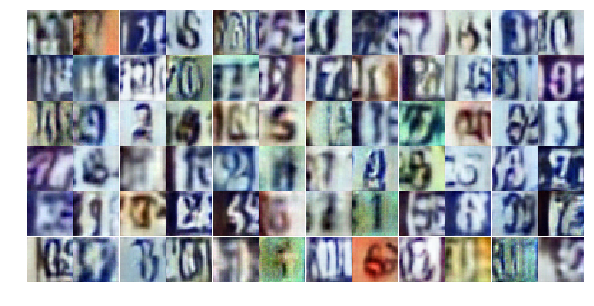

Epoch 11/25... Discriminator Loss: 0.3145... Generator Loss: 2.0002
Epoch 11/25... Discriminator Loss: 0.7117... Generator Loss: 1.0431
Epoch 11/25... Discriminator Loss: 0.5190... Generator Loss: 1.2905
Epoch 11/25... Discriminator Loss: 0.7047... Generator Loss: 1.1843
Epoch 11/25... Discriminator Loss: 0.6954... Generator Loss: 1.2610
Epoch 11/25... Discriminator Loss: 0.4400... Generator Loss: 1.7200
Epoch 11/25... Discriminator Loss: 0.5620... Generator Loss: 1.9379
Epoch 11/25... Discriminator Loss: 0.3751... Generator Loss: 1.7550
Epoch 11/25... Discriminator Loss: 0.8029... Generator Loss: 0.8278
Epoch 11/25... Discriminator Loss: 1.2596... Generator Loss: 0.4770


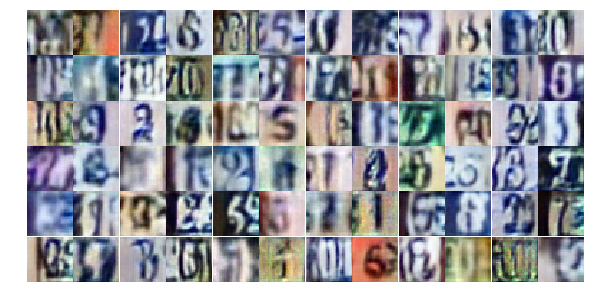

Epoch 11/25... Discriminator Loss: 0.7862... Generator Loss: 0.9439
Epoch 11/25... Discriminator Loss: 0.3399... Generator Loss: 2.3386
Epoch 11/25... Discriminator Loss: 0.9854... Generator Loss: 0.6865
Epoch 11/25... Discriminator Loss: 0.4873... Generator Loss: 1.5164
Epoch 11/25... Discriminator Loss: 0.3652... Generator Loss: 1.7517
Epoch 11/25... Discriminator Loss: 0.3522... Generator Loss: 2.0138
Epoch 11/25... Discriminator Loss: 0.5982... Generator Loss: 1.1100
Epoch 11/25... Discriminator Loss: 0.7950... Generator Loss: 0.9745
Epoch 11/25... Discriminator Loss: 0.3509... Generator Loss: 1.8018
Epoch 11/25... Discriminator Loss: 1.0486... Generator Loss: 0.6147


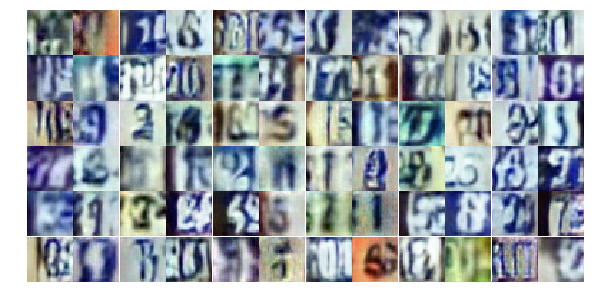

Epoch 11/25... Discriminator Loss: 0.8609... Generator Loss: 0.7636
Epoch 11/25... Discriminator Loss: 0.7409... Generator Loss: 1.2829
Epoch 11/25... Discriminator Loss: 1.0204... Generator Loss: 0.6624
Epoch 11/25... Discriminator Loss: 0.4600... Generator Loss: 1.3659
Epoch 11/25... Discriminator Loss: 0.6322... Generator Loss: 1.0046
Epoch 11/25... Discriminator Loss: 0.7269... Generator Loss: 1.0705
Epoch 11/25... Discriminator Loss: 0.7981... Generator Loss: 0.8799
Epoch 11/25... Discriminator Loss: 1.1114... Generator Loss: 0.5580
Epoch 11/25... Discriminator Loss: 0.5060... Generator Loss: 1.2629
Epoch 11/25... Discriminator Loss: 1.0057... Generator Loss: 0.6380


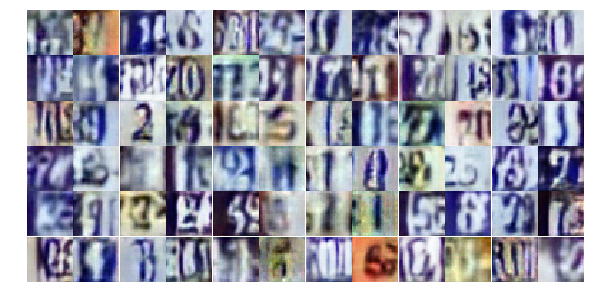

Epoch 11/25... Discriminator Loss: 0.5093... Generator Loss: 1.4293
Epoch 11/25... Discriminator Loss: 0.5894... Generator Loss: 1.1187
Epoch 11/25... Discriminator Loss: 1.6300... Generator Loss: 0.2935
Epoch 11/25... Discriminator Loss: 0.8999... Generator Loss: 0.9049
Epoch 11/25... Discriminator Loss: 0.7032... Generator Loss: 1.1480
Epoch 11/25... Discriminator Loss: 0.4881... Generator Loss: 1.2857
Epoch 11/25... Discriminator Loss: 0.2929... Generator Loss: 2.4954
Epoch 11/25... Discriminator Loss: 0.7650... Generator Loss: 0.8175
Epoch 11/25... Discriminator Loss: 1.1211... Generator Loss: 0.5530
Epoch 11/25... Discriminator Loss: 2.4553... Generator Loss: 5.5045


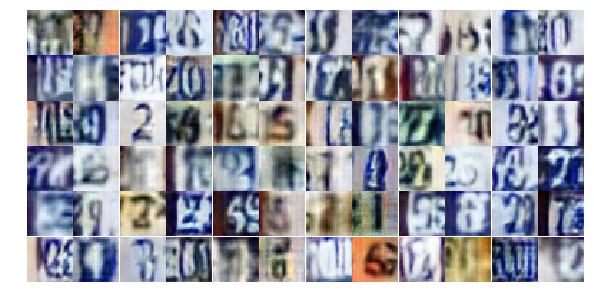

Epoch 11/25... Discriminator Loss: 0.7733... Generator Loss: 1.3046
Epoch 11/25... Discriminator Loss: 0.4600... Generator Loss: 1.7383
Epoch 11/25... Discriminator Loss: 0.8114... Generator Loss: 0.9089
Epoch 11/25... Discriminator Loss: 0.5748... Generator Loss: 1.1944
Epoch 11/25... Discriminator Loss: 1.0690... Generator Loss: 0.6025
Epoch 11/25... Discriminator Loss: 0.9345... Generator Loss: 0.7428
Epoch 11/25... Discriminator Loss: 0.8244... Generator Loss: 0.9442
Epoch 11/25... Discriminator Loss: 0.6320... Generator Loss: 1.6527
Epoch 11/25... Discriminator Loss: 0.9707... Generator Loss: 1.5460
Epoch 11/25... Discriminator Loss: 0.7132... Generator Loss: 1.1631


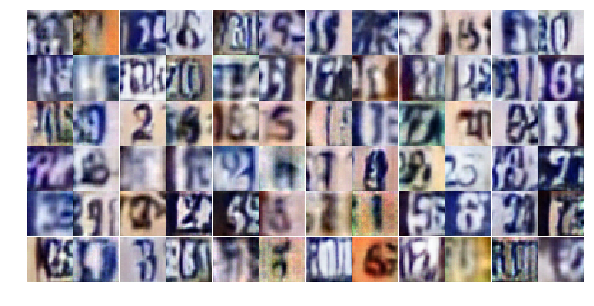

Epoch 12/25... Discriminator Loss: 0.9225... Generator Loss: 1.6054
Epoch 12/25... Discriminator Loss: 0.6365... Generator Loss: 1.2416
Epoch 12/25... Discriminator Loss: 0.8785... Generator Loss: 0.8701
Epoch 12/25... Discriminator Loss: 0.5859... Generator Loss: 1.3044
Epoch 12/25... Discriminator Loss: 0.4143... Generator Loss: 1.9011
Epoch 12/25... Discriminator Loss: 1.0238... Generator Loss: 0.6101
Epoch 12/25... Discriminator Loss: 0.6201... Generator Loss: 1.2792
Epoch 12/25... Discriminator Loss: 0.8514... Generator Loss: 0.8481
Epoch 12/25... Discriminator Loss: 0.5794... Generator Loss: 1.5928
Epoch 12/25... Discriminator Loss: 1.0999... Generator Loss: 0.6581


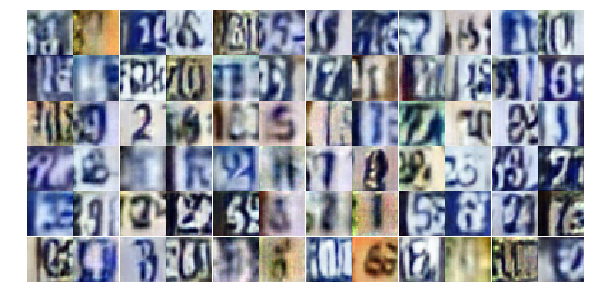

Epoch 12/25... Discriminator Loss: 0.5589... Generator Loss: 1.2211
Epoch 12/25... Discriminator Loss: 1.1666... Generator Loss: 0.5052
Epoch 12/25... Discriminator Loss: 0.4411... Generator Loss: 1.5991
Epoch 12/25... Discriminator Loss: 0.6130... Generator Loss: 1.6006
Epoch 12/25... Discriminator Loss: 0.5631... Generator Loss: 1.9378
Epoch 12/25... Discriminator Loss: 1.1776... Generator Loss: 0.5695
Epoch 12/25... Discriminator Loss: 1.8027... Generator Loss: 0.2396
Epoch 12/25... Discriminator Loss: 0.6043... Generator Loss: 1.7836
Epoch 12/25... Discriminator Loss: 0.4118... Generator Loss: 1.6369
Epoch 12/25... Discriminator Loss: 0.6822... Generator Loss: 0.9905


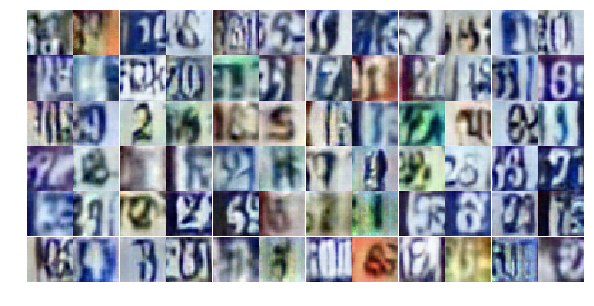

Epoch 12/25... Discriminator Loss: 0.3244... Generator Loss: 2.0583
Epoch 12/25... Discriminator Loss: 0.4251... Generator Loss: 1.3898
Epoch 12/25... Discriminator Loss: 0.6543... Generator Loss: 1.6250
Epoch 12/25... Discriminator Loss: 0.4695... Generator Loss: 1.4704
Epoch 12/25... Discriminator Loss: 0.3896... Generator Loss: 1.6334
Epoch 12/25... Discriminator Loss: 0.4833... Generator Loss: 1.4011
Epoch 12/25... Discriminator Loss: 0.7069... Generator Loss: 0.9931
Epoch 12/25... Discriminator Loss: 0.3952... Generator Loss: 1.7713
Epoch 12/25... Discriminator Loss: 0.4247... Generator Loss: 1.7951
Epoch 12/25... Discriminator Loss: 0.5438... Generator Loss: 1.2627


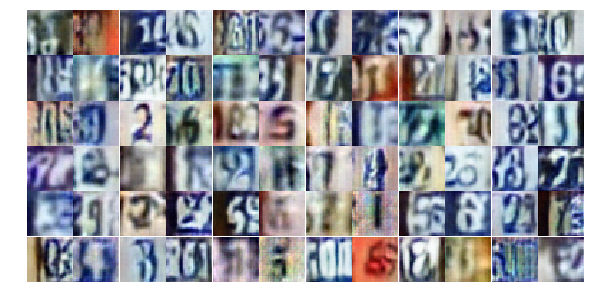

Epoch 12/25... Discriminator Loss: 0.8398... Generator Loss: 0.8394
Epoch 12/25... Discriminator Loss: 0.7703... Generator Loss: 0.9031
Epoch 12/25... Discriminator Loss: 0.8643... Generator Loss: 0.7807
Epoch 12/25... Discriminator Loss: 1.7756... Generator Loss: 0.2682
Epoch 12/25... Discriminator Loss: 0.7760... Generator Loss: 1.5085
Epoch 12/25... Discriminator Loss: 0.7543... Generator Loss: 0.9085
Epoch 12/25... Discriminator Loss: 0.9605... Generator Loss: 0.6456
Epoch 12/25... Discriminator Loss: 0.7928... Generator Loss: 0.9344
Epoch 12/25... Discriminator Loss: 0.6516... Generator Loss: 2.1615
Epoch 12/25... Discriminator Loss: 0.6166... Generator Loss: 1.2554


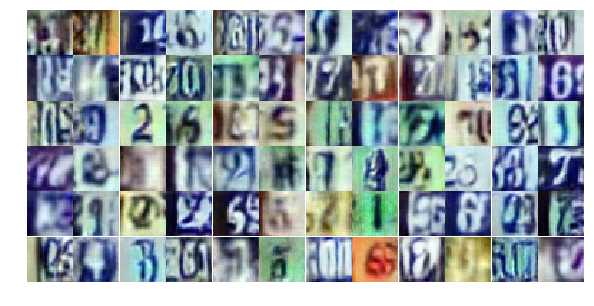

Epoch 12/25... Discriminator Loss: 0.5952... Generator Loss: 2.8265
Epoch 12/25... Discriminator Loss: 0.4901... Generator Loss: 1.3662
Epoch 12/25... Discriminator Loss: 0.4194... Generator Loss: 1.7220
Epoch 12/25... Discriminator Loss: 0.9796... Generator Loss: 0.7147
Epoch 12/25... Discriminator Loss: 0.9602... Generator Loss: 0.6227
Epoch 12/25... Discriminator Loss: 1.0524... Generator Loss: 0.6267
Epoch 12/25... Discriminator Loss: 0.5982... Generator Loss: 1.2166
Epoch 12/25... Discriminator Loss: 0.5638... Generator Loss: 1.4675
Epoch 12/25... Discriminator Loss: 0.5840... Generator Loss: 1.4388
Epoch 12/25... Discriminator Loss: 0.7557... Generator Loss: 1.2027


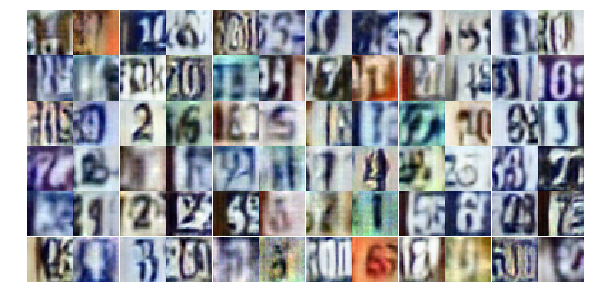

Epoch 12/25... Discriminator Loss: 0.8158... Generator Loss: 0.8510
Epoch 12/25... Discriminator Loss: 1.0619... Generator Loss: 0.7065
Epoch 12/25... Discriminator Loss: 0.7734... Generator Loss: 2.3182
Epoch 12/25... Discriminator Loss: 1.2067... Generator Loss: 0.5187
Epoch 12/25... Discriminator Loss: 0.4582... Generator Loss: 1.4978
Epoch 12/25... Discriminator Loss: 0.8317... Generator Loss: 1.0455
Epoch 12/25... Discriminator Loss: 0.8377... Generator Loss: 0.8072
Epoch 13/25... Discriminator Loss: 0.6010... Generator Loss: 1.1349
Epoch 13/25... Discriminator Loss: 0.4135... Generator Loss: 1.5114
Epoch 13/25... Discriminator Loss: 0.9898... Generator Loss: 0.6672


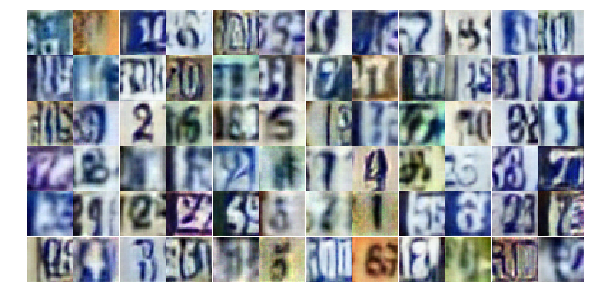

Epoch 13/25... Discriminator Loss: 0.5090... Generator Loss: 1.3437
Epoch 13/25... Discriminator Loss: 0.7666... Generator Loss: 2.5702
Epoch 13/25... Discriminator Loss: 1.2755... Generator Loss: 0.5819
Epoch 13/25... Discriminator Loss: 1.4705... Generator Loss: 0.3984
Epoch 13/25... Discriminator Loss: 0.7108... Generator Loss: 0.9688
Epoch 13/25... Discriminator Loss: 0.6218... Generator Loss: 1.3316
Epoch 13/25... Discriminator Loss: 0.4653... Generator Loss: 1.8492
Epoch 13/25... Discriminator Loss: 0.8410... Generator Loss: 0.8685
Epoch 13/25... Discriminator Loss: 0.6025... Generator Loss: 1.1073
Epoch 13/25... Discriminator Loss: 0.5987... Generator Loss: 1.2202


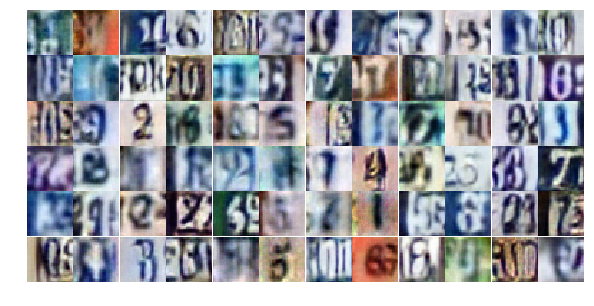

Epoch 13/25... Discriminator Loss: 0.7108... Generator Loss: 1.0259
Epoch 13/25... Discriminator Loss: 0.5113... Generator Loss: 1.3891
Epoch 13/25... Discriminator Loss: 1.0354... Generator Loss: 0.6369
Epoch 13/25... Discriminator Loss: 0.7780... Generator Loss: 1.0016
Epoch 13/25... Discriminator Loss: 0.4873... Generator Loss: 1.7390
Epoch 13/25... Discriminator Loss: 0.9188... Generator Loss: 0.7897
Epoch 13/25... Discriminator Loss: 1.0851... Generator Loss: 0.6406
Epoch 13/25... Discriminator Loss: 1.0600... Generator Loss: 0.6208
Epoch 13/25... Discriminator Loss: 0.6689... Generator Loss: 1.1119
Epoch 13/25... Discriminator Loss: 1.0648... Generator Loss: 0.5591


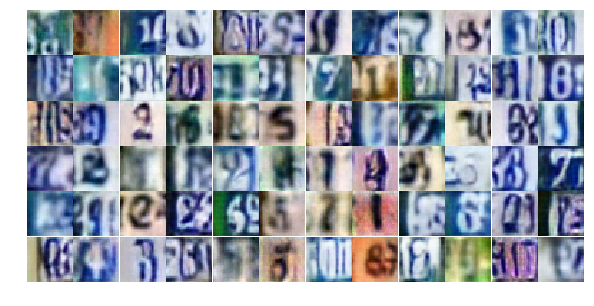

Epoch 13/25... Discriminator Loss: 0.7537... Generator Loss: 0.8414
Epoch 13/25... Discriminator Loss: 0.5890... Generator Loss: 1.2537
Epoch 13/25... Discriminator Loss: 0.5911... Generator Loss: 1.6170
Epoch 13/25... Discriminator Loss: 0.8526... Generator Loss: 0.7380
Epoch 13/25... Discriminator Loss: 0.5400... Generator Loss: 1.3892
Epoch 13/25... Discriminator Loss: 0.8484... Generator Loss: 0.7840
Epoch 13/25... Discriminator Loss: 0.7463... Generator Loss: 1.6219
Epoch 13/25... Discriminator Loss: 0.5466... Generator Loss: 1.1451
Epoch 13/25... Discriminator Loss: 0.5698... Generator Loss: 1.3115
Epoch 13/25... Discriminator Loss: 0.5108... Generator Loss: 1.3553


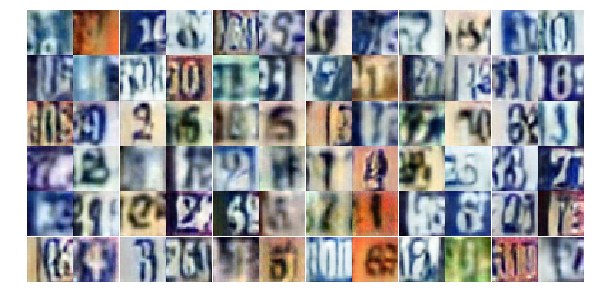

Epoch 13/25... Discriminator Loss: 0.8264... Generator Loss: 0.7546
Epoch 13/25... Discriminator Loss: 0.9635... Generator Loss: 0.7853
Epoch 13/25... Discriminator Loss: 2.3773... Generator Loss: 0.1844
Epoch 13/25... Discriminator Loss: 1.1949... Generator Loss: 0.4991
Epoch 13/25... Discriminator Loss: 0.5391... Generator Loss: 1.2816
Epoch 13/25... Discriminator Loss: 0.6383... Generator Loss: 1.2396
Epoch 13/25... Discriminator Loss: 0.4780... Generator Loss: 1.4258
Epoch 13/25... Discriminator Loss: 1.2899... Generator Loss: 0.4400
Epoch 13/25... Discriminator Loss: 0.6123... Generator Loss: 1.0452
Epoch 13/25... Discriminator Loss: 0.8600... Generator Loss: 0.7832


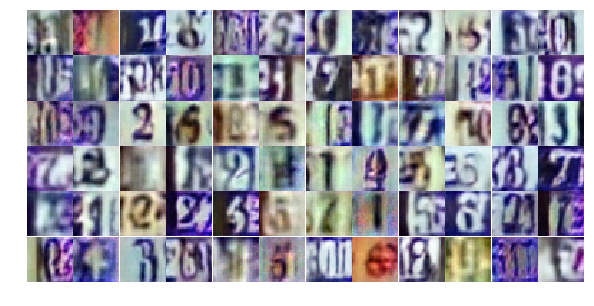

Epoch 13/25... Discriminator Loss: 0.6143... Generator Loss: 1.1530
Epoch 13/25... Discriminator Loss: 0.7025... Generator Loss: 2.5507
Epoch 13/25... Discriminator Loss: 0.7240... Generator Loss: 1.8637
Epoch 13/25... Discriminator Loss: 0.5868... Generator Loss: 1.7024
Epoch 13/25... Discriminator Loss: 1.0509... Generator Loss: 0.6912
Epoch 13/25... Discriminator Loss: 0.5786... Generator Loss: 1.3376
Epoch 13/25... Discriminator Loss: 0.8571... Generator Loss: 0.8021
Epoch 13/25... Discriminator Loss: 0.7188... Generator Loss: 1.0012
Epoch 13/25... Discriminator Loss: 0.8673... Generator Loss: 0.7470
Epoch 13/25... Discriminator Loss: 1.1881... Generator Loss: 0.5118


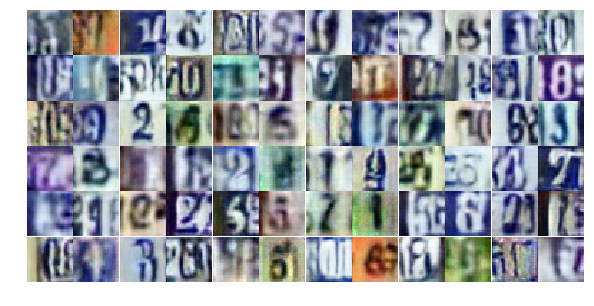

Epoch 13/25... Discriminator Loss: 0.4451... Generator Loss: 1.4580
Epoch 13/25... Discriminator Loss: 0.8230... Generator Loss: 0.8579
Epoch 13/25... Discriminator Loss: 0.4610... Generator Loss: 1.4486
Epoch 13/25... Discriminator Loss: 0.8283... Generator Loss: 0.7979
Epoch 14/25... Discriminator Loss: 1.2696... Generator Loss: 0.4834
Epoch 14/25... Discriminator Loss: 0.6844... Generator Loss: 1.4488
Epoch 14/25... Discriminator Loss: 0.7937... Generator Loss: 1.0418
Epoch 14/25... Discriminator Loss: 0.6197... Generator Loss: 1.5848
Epoch 14/25... Discriminator Loss: 0.6558... Generator Loss: 1.1245
Epoch 14/25... Discriminator Loss: 0.8904... Generator Loss: 0.7819


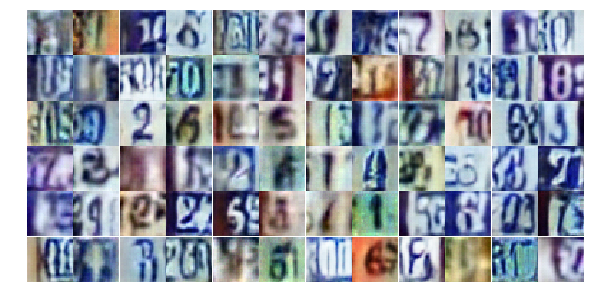

Epoch 14/25... Discriminator Loss: 1.2512... Generator Loss: 0.6082
Epoch 14/25... Discriminator Loss: 0.9947... Generator Loss: 0.6368
Epoch 14/25... Discriminator Loss: 0.8059... Generator Loss: 0.8992
Epoch 14/25... Discriminator Loss: 0.7036... Generator Loss: 1.1603
Epoch 14/25... Discriminator Loss: 1.0676... Generator Loss: 0.5686
Epoch 14/25... Discriminator Loss: 0.5889... Generator Loss: 1.0646
Epoch 14/25... Discriminator Loss: 0.5355... Generator Loss: 1.2959
Epoch 14/25... Discriminator Loss: 1.4062... Generator Loss: 0.3725
Epoch 14/25... Discriminator Loss: 0.7473... Generator Loss: 1.0567
Epoch 14/25... Discriminator Loss: 2.2726... Generator Loss: 0.1583


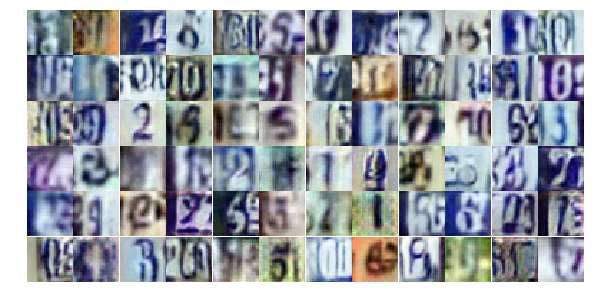

Epoch 14/25... Discriminator Loss: 0.7831... Generator Loss: 0.9271
Epoch 14/25... Discriminator Loss: 0.5503... Generator Loss: 1.5961
Epoch 14/25... Discriminator Loss: 1.0663... Generator Loss: 0.7004
Epoch 14/25... Discriminator Loss: 0.4870... Generator Loss: 1.6031
Epoch 14/25... Discriminator Loss: 0.9902... Generator Loss: 0.6505
Epoch 14/25... Discriminator Loss: 0.8996... Generator Loss: 0.7602
Epoch 14/25... Discriminator Loss: 0.6043... Generator Loss: 1.1450
Epoch 14/25... Discriminator Loss: 0.5764... Generator Loss: 1.2260
Epoch 14/25... Discriminator Loss: 0.4879... Generator Loss: 1.2874
Epoch 14/25... Discriminator Loss: 0.6669... Generator Loss: 0.9742


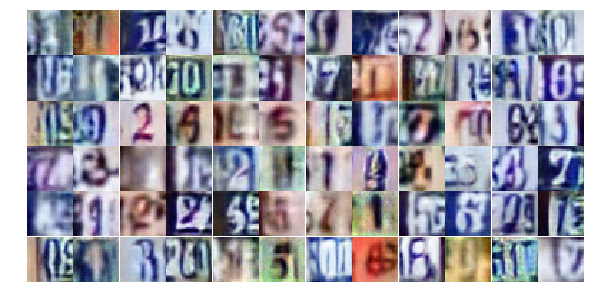

Epoch 14/25... Discriminator Loss: 1.0949... Generator Loss: 0.6044
Epoch 14/25... Discriminator Loss: 0.4561... Generator Loss: 1.3765
Epoch 14/25... Discriminator Loss: 0.6832... Generator Loss: 1.0312
Epoch 14/25... Discriminator Loss: 0.4674... Generator Loss: 1.3098
Epoch 14/25... Discriminator Loss: 0.7748... Generator Loss: 0.8607
Epoch 14/25... Discriminator Loss: 0.7287... Generator Loss: 0.9448
Epoch 14/25... Discriminator Loss: 0.7112... Generator Loss: 0.9913
Epoch 14/25... Discriminator Loss: 0.4581... Generator Loss: 1.3259
Epoch 14/25... Discriminator Loss: 0.4151... Generator Loss: 2.2741
Epoch 14/25... Discriminator Loss: 1.6323... Generator Loss: 0.6869


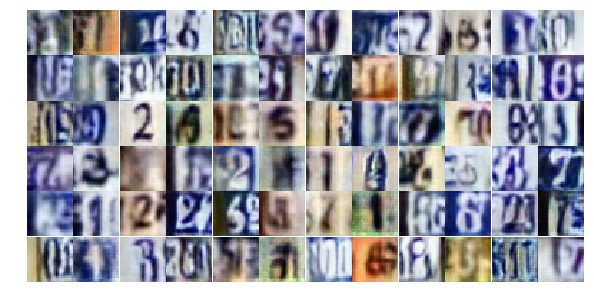

Epoch 14/25... Discriminator Loss: 1.0246... Generator Loss: 0.6375
Epoch 14/25... Discriminator Loss: 0.6887... Generator Loss: 1.2352
Epoch 14/25... Discriminator Loss: 0.4598... Generator Loss: 1.5181
Epoch 14/25... Discriminator Loss: 1.2754... Generator Loss: 0.4838
Epoch 14/25... Discriminator Loss: 1.1524... Generator Loss: 0.5181
Epoch 14/25... Discriminator Loss: 0.7121... Generator Loss: 1.0101
Epoch 14/25... Discriminator Loss: 0.7140... Generator Loss: 1.0760
Epoch 14/25... Discriminator Loss: 0.6924... Generator Loss: 1.0543
Epoch 14/25... Discriminator Loss: 0.8424... Generator Loss: 0.8532
Epoch 14/25... Discriminator Loss: 1.4540... Generator Loss: 0.3585


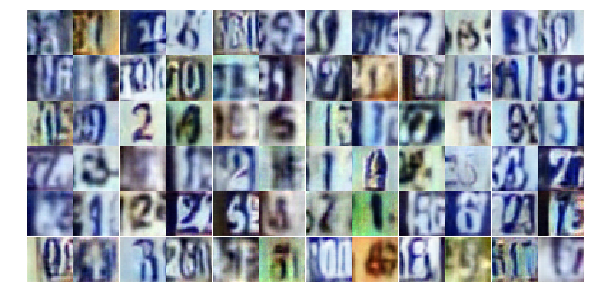

Epoch 14/25... Discriminator Loss: 1.0464... Generator Loss: 0.6865
Epoch 14/25... Discriminator Loss: 1.6223... Generator Loss: 0.2911
Epoch 14/25... Discriminator Loss: 0.5537... Generator Loss: 1.1803
Epoch 14/25... Discriminator Loss: 1.1588... Generator Loss: 0.5498
Epoch 14/25... Discriminator Loss: 0.5987... Generator Loss: 1.0822
Epoch 14/25... Discriminator Loss: 0.6498... Generator Loss: 1.0504
Epoch 14/25... Discriminator Loss: 0.7197... Generator Loss: 1.2909
Epoch 14/25... Discriminator Loss: 0.6640... Generator Loss: 1.0000
Epoch 14/25... Discriminator Loss: 1.0329... Generator Loss: 0.5792
Epoch 14/25... Discriminator Loss: 1.1140... Generator Loss: 0.5378


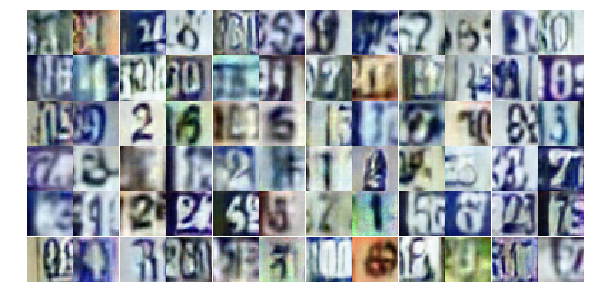

Epoch 14/25... Discriminator Loss: 1.1684... Generator Loss: 2.3172
Epoch 14/25... Discriminator Loss: 0.9750... Generator Loss: 0.7068
Epoch 15/25... Discriminator Loss: 0.8891... Generator Loss: 0.8691
Epoch 15/25... Discriminator Loss: 0.4877... Generator Loss: 1.6746
Epoch 15/25... Discriminator Loss: 0.9961... Generator Loss: 0.6565
Epoch 15/25... Discriminator Loss: 0.9684... Generator Loss: 0.6750
Epoch 15/25... Discriminator Loss: 1.3204... Generator Loss: 0.4432
Epoch 15/25... Discriminator Loss: 0.8774... Generator Loss: 0.8364
Epoch 15/25... Discriminator Loss: 1.2055... Generator Loss: 0.5210
Epoch 15/25... Discriminator Loss: 0.6849... Generator Loss: 0.9654


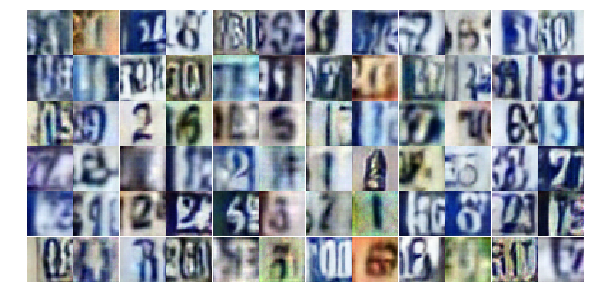

Epoch 15/25... Discriminator Loss: 0.7467... Generator Loss: 1.0942
Epoch 15/25... Discriminator Loss: 0.5991... Generator Loss: 1.7204
Epoch 15/25... Discriminator Loss: 0.9596... Generator Loss: 1.0845
Epoch 15/25... Discriminator Loss: 0.7356... Generator Loss: 0.8898
Epoch 15/25... Discriminator Loss: 1.1327... Generator Loss: 0.5843
Epoch 15/25... Discriminator Loss: 0.5514... Generator Loss: 1.5048
Epoch 15/25... Discriminator Loss: 0.7998... Generator Loss: 0.7842
Epoch 15/25... Discriminator Loss: 0.6287... Generator Loss: 1.5706
Epoch 15/25... Discriminator Loss: 0.7146... Generator Loss: 2.3831
Epoch 15/25... Discriminator Loss: 1.4648... Generator Loss: 0.3644


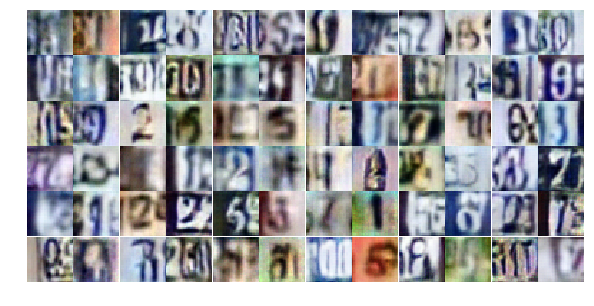

Epoch 15/25... Discriminator Loss: 1.2437... Generator Loss: 0.6883
Epoch 15/25... Discriminator Loss: 0.5255... Generator Loss: 1.3173
Epoch 15/25... Discriminator Loss: 0.6214... Generator Loss: 1.2637
Epoch 15/25... Discriminator Loss: 1.1199... Generator Loss: 0.5398
Epoch 15/25... Discriminator Loss: 0.7038... Generator Loss: 1.7168
Epoch 15/25... Discriminator Loss: 0.8566... Generator Loss: 0.8108
Epoch 15/25... Discriminator Loss: 1.2691... Generator Loss: 0.4620
Epoch 15/25... Discriminator Loss: 0.8951... Generator Loss: 0.8843
Epoch 15/25... Discriminator Loss: 0.8159... Generator Loss: 0.8650
Epoch 15/25... Discriminator Loss: 1.3821... Generator Loss: 0.4878


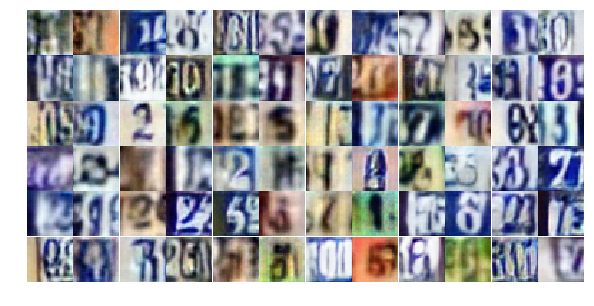

Epoch 15/25... Discriminator Loss: 0.6493... Generator Loss: 1.8462
Epoch 15/25... Discriminator Loss: 0.8639... Generator Loss: 0.8928
Epoch 15/25... Discriminator Loss: 0.5018... Generator Loss: 1.3967
Epoch 15/25... Discriminator Loss: 0.6521... Generator Loss: 1.3299
Epoch 15/25... Discriminator Loss: 0.6468... Generator Loss: 1.1815
Epoch 15/25... Discriminator Loss: 1.1359... Generator Loss: 2.2931
Epoch 15/25... Discriminator Loss: 0.5601... Generator Loss: 1.3202
Epoch 15/25... Discriminator Loss: 0.6778... Generator Loss: 1.2257
Epoch 15/25... Discriminator Loss: 0.5502... Generator Loss: 1.2128
Epoch 15/25... Discriminator Loss: 0.8351... Generator Loss: 0.8802


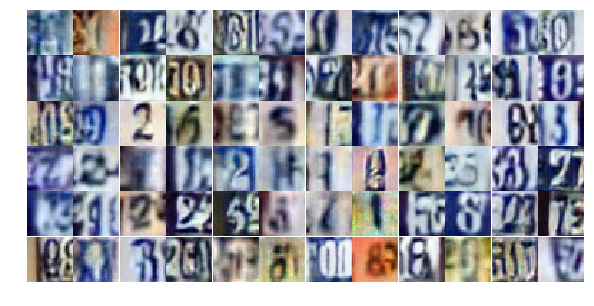

Epoch 15/25... Discriminator Loss: 0.6307... Generator Loss: 1.0769
Epoch 15/25... Discriminator Loss: 0.9298... Generator Loss: 0.6969
Epoch 15/25... Discriminator Loss: 1.2066... Generator Loss: 0.4996
Epoch 15/25... Discriminator Loss: 0.4907... Generator Loss: 1.3994
Epoch 15/25... Discriminator Loss: 0.6770... Generator Loss: 0.9790
Epoch 15/25... Discriminator Loss: 1.7386... Generator Loss: 0.3099
Epoch 15/25... Discriminator Loss: 0.6445... Generator Loss: 1.2250
Epoch 15/25... Discriminator Loss: 1.2374... Generator Loss: 2.7901
Epoch 15/25... Discriminator Loss: 0.9902... Generator Loss: 0.8353
Epoch 15/25... Discriminator Loss: 0.8559... Generator Loss: 1.4159


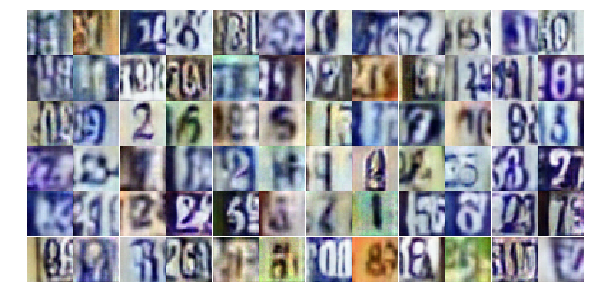

Epoch 15/25... Discriminator Loss: 0.9955... Generator Loss: 0.6495
Epoch 15/25... Discriminator Loss: 1.1292... Generator Loss: 0.5659
Epoch 15/25... Discriminator Loss: 0.5509... Generator Loss: 1.1947
Epoch 15/25... Discriminator Loss: 1.1340... Generator Loss: 0.5606
Epoch 15/25... Discriminator Loss: 0.5243... Generator Loss: 1.4480
Epoch 15/25... Discriminator Loss: 0.9116... Generator Loss: 0.7584
Epoch 15/25... Discriminator Loss: 1.2498... Generator Loss: 0.4741
Epoch 15/25... Discriminator Loss: 0.5145... Generator Loss: 1.5571
Epoch 15/25... Discriminator Loss: 1.5739... Generator Loss: 0.3320
Epoch 16/25... Discriminator Loss: 1.1513... Generator Loss: 0.5533


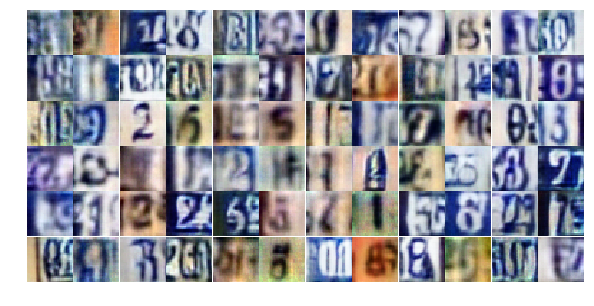

Epoch 16/25... Discriminator Loss: 0.6726... Generator Loss: 1.2550
Epoch 16/25... Discriminator Loss: 0.9200... Generator Loss: 0.7576
Epoch 16/25... Discriminator Loss: 1.1536... Generator Loss: 0.5769
Epoch 16/25... Discriminator Loss: 0.7339... Generator Loss: 1.2841
Epoch 16/25... Discriminator Loss: 0.6348... Generator Loss: 1.1598
Epoch 16/25... Discriminator Loss: 0.6000... Generator Loss: 1.2957
Epoch 16/25... Discriminator Loss: 1.5472... Generator Loss: 0.3424
Epoch 16/25... Discriminator Loss: 1.0184... Generator Loss: 0.6421
Epoch 16/25... Discriminator Loss: 0.5258... Generator Loss: 1.2153
Epoch 16/25... Discriminator Loss: 0.5241... Generator Loss: 1.2301


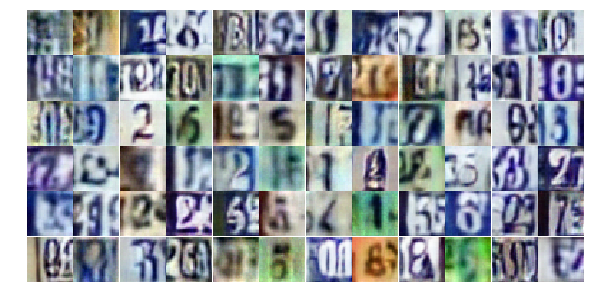

Epoch 16/25... Discriminator Loss: 1.3386... Generator Loss: 0.4595
Epoch 16/25... Discriminator Loss: 0.6880... Generator Loss: 1.0244
Epoch 16/25... Discriminator Loss: 0.5873... Generator Loss: 1.3341
Epoch 16/25... Discriminator Loss: 1.0052... Generator Loss: 0.6330
Epoch 16/25... Discriminator Loss: 0.4716... Generator Loss: 1.7526
Epoch 16/25... Discriminator Loss: 0.6698... Generator Loss: 1.1246
Epoch 16/25... Discriminator Loss: 1.2878... Generator Loss: 0.5174
Epoch 16/25... Discriminator Loss: 0.3610... Generator Loss: 2.3859
Epoch 16/25... Discriminator Loss: 0.7031... Generator Loss: 1.0577
Epoch 16/25... Discriminator Loss: 0.7103... Generator Loss: 1.0146


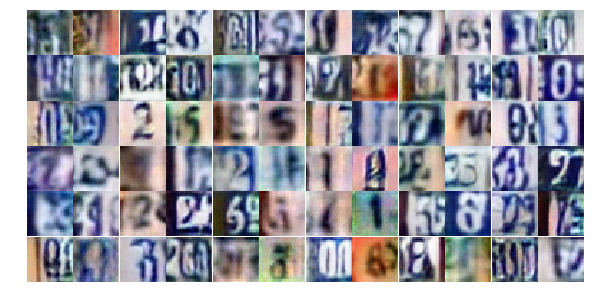

Epoch 16/25... Discriminator Loss: 0.6696... Generator Loss: 1.3622
Epoch 16/25... Discriminator Loss: 0.8446... Generator Loss: 0.8897
Epoch 16/25... Discriminator Loss: 1.0345... Generator Loss: 0.6289
Epoch 16/25... Discriminator Loss: 1.0180... Generator Loss: 0.5958
Epoch 16/25... Discriminator Loss: 0.7026... Generator Loss: 1.3264
Epoch 16/25... Discriminator Loss: 0.8099... Generator Loss: 1.0082
Epoch 16/25... Discriminator Loss: 0.9078... Generator Loss: 0.8046
Epoch 16/25... Discriminator Loss: 0.5229... Generator Loss: 1.2698
Epoch 16/25... Discriminator Loss: 0.7598... Generator Loss: 1.4480
Epoch 16/25... Discriminator Loss: 0.6487... Generator Loss: 1.1445


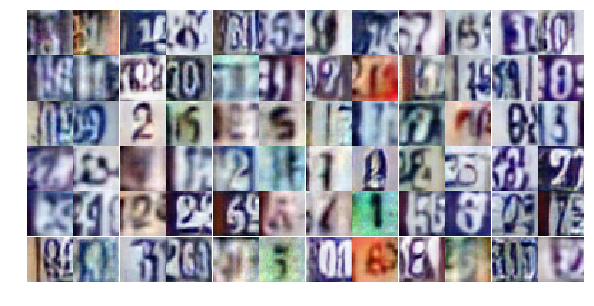

Epoch 16/25... Discriminator Loss: 0.7635... Generator Loss: 0.8615
Epoch 16/25... Discriminator Loss: 0.5200... Generator Loss: 1.3138
Epoch 16/25... Discriminator Loss: 0.7039... Generator Loss: 1.6634
Epoch 16/25... Discriminator Loss: 1.0052... Generator Loss: 0.8359
Epoch 16/25... Discriminator Loss: 0.8948... Generator Loss: 0.9627
Epoch 16/25... Discriminator Loss: 0.6640... Generator Loss: 1.0853
Epoch 16/25... Discriminator Loss: 0.8401... Generator Loss: 0.7793
Epoch 16/25... Discriminator Loss: 0.8481... Generator Loss: 0.7595
Epoch 16/25... Discriminator Loss: 0.7995... Generator Loss: 0.8784
Epoch 16/25... Discriminator Loss: 0.4592... Generator Loss: 1.6978


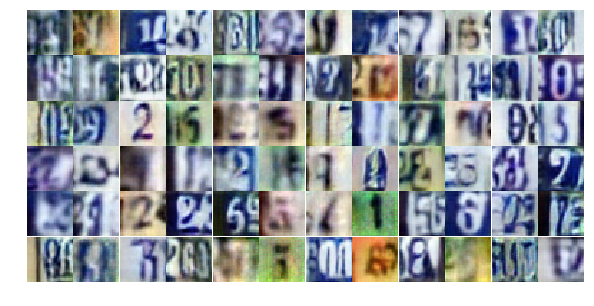

Epoch 16/25... Discriminator Loss: 0.4517... Generator Loss: 1.5207
Epoch 16/25... Discriminator Loss: 0.5224... Generator Loss: 1.3972
Epoch 16/25... Discriminator Loss: 1.2777... Generator Loss: 0.5090
Epoch 16/25... Discriminator Loss: 0.9807... Generator Loss: 0.7004
Epoch 16/25... Discriminator Loss: 0.9083... Generator Loss: 0.7177
Epoch 16/25... Discriminator Loss: 1.2076... Generator Loss: 0.5989
Epoch 16/25... Discriminator Loss: 0.4628... Generator Loss: 1.8506
Epoch 16/25... Discriminator Loss: 1.1048... Generator Loss: 0.5808
Epoch 16/25... Discriminator Loss: 0.5043... Generator Loss: 1.2261
Epoch 16/25... Discriminator Loss: 1.2104... Generator Loss: 0.4760


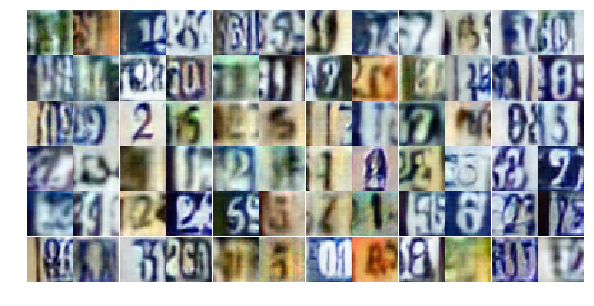

Epoch 16/25... Discriminator Loss: 1.4540... Generator Loss: 0.3787
Epoch 16/25... Discriminator Loss: 0.8222... Generator Loss: 2.4350
Epoch 16/25... Discriminator Loss: 2.6528... Generator Loss: 0.1995
Epoch 16/25... Discriminator Loss: 0.4653... Generator Loss: 2.1434
Epoch 16/25... Discriminator Loss: 0.6041... Generator Loss: 1.5983
Epoch 16/25... Discriminator Loss: 0.8709... Generator Loss: 0.7636
Epoch 17/25... Discriminator Loss: 0.9855... Generator Loss: 0.6960
Epoch 17/25... Discriminator Loss: 0.8158... Generator Loss: 0.8542
Epoch 17/25... Discriminator Loss: 0.7932... Generator Loss: 0.9834
Epoch 17/25... Discriminator Loss: 0.7242... Generator Loss: 0.9373


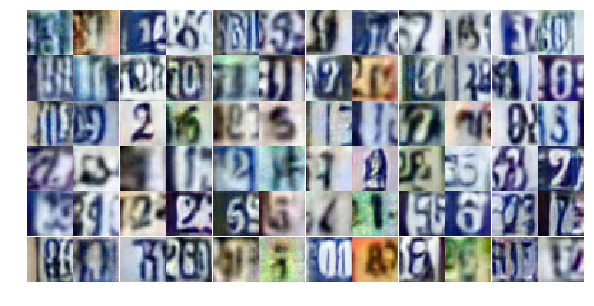

Epoch 17/25... Discriminator Loss: 0.5091... Generator Loss: 1.3574
Epoch 17/25... Discriminator Loss: 0.6147... Generator Loss: 1.1223
Epoch 17/25... Discriminator Loss: 0.7844... Generator Loss: 0.9292
Epoch 17/25... Discriminator Loss: 0.7020... Generator Loss: 0.9549
Epoch 17/25... Discriminator Loss: 1.1893... Generator Loss: 0.5445
Epoch 17/25... Discriminator Loss: 1.1325... Generator Loss: 0.5529
Epoch 17/25... Discriminator Loss: 0.9082... Generator Loss: 0.6960
Epoch 17/25... Discriminator Loss: 0.7823... Generator Loss: 0.8993
Epoch 17/25... Discriminator Loss: 0.5021... Generator Loss: 1.6292
Epoch 17/25... Discriminator Loss: 0.6239... Generator Loss: 1.1998


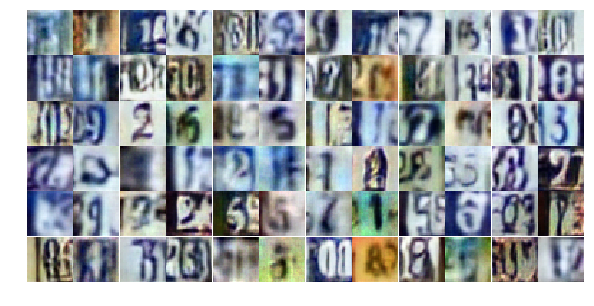

Epoch 17/25... Discriminator Loss: 0.9658... Generator Loss: 0.8764
Epoch 17/25... Discriminator Loss: 0.8663... Generator Loss: 0.8198
Epoch 17/25... Discriminator Loss: 0.4029... Generator Loss: 1.4908
Epoch 17/25... Discriminator Loss: 0.8088... Generator Loss: 1.0107
Epoch 17/25... Discriminator Loss: 0.5899... Generator Loss: 1.2599
Epoch 17/25... Discriminator Loss: 0.7778... Generator Loss: 0.8532
Epoch 17/25... Discriminator Loss: 0.6510... Generator Loss: 1.4151
Epoch 17/25... Discriminator Loss: 1.3433... Generator Loss: 0.4518
Epoch 17/25... Discriminator Loss: 0.7958... Generator Loss: 0.9126
Epoch 17/25... Discriminator Loss: 0.6245... Generator Loss: 1.1771


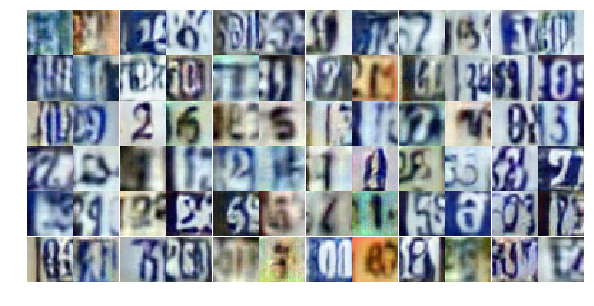

Epoch 17/25... Discriminator Loss: 1.4614... Generator Loss: 0.4118
Epoch 17/25... Discriminator Loss: 0.5159... Generator Loss: 1.3758
Epoch 17/25... Discriminator Loss: 0.6613... Generator Loss: 0.9499
Epoch 17/25... Discriminator Loss: 0.8285... Generator Loss: 0.8915
Epoch 17/25... Discriminator Loss: 1.3980... Generator Loss: 0.4623
Epoch 17/25... Discriminator Loss: 0.6152... Generator Loss: 1.0702
Epoch 17/25... Discriminator Loss: 0.7919... Generator Loss: 0.8895
Epoch 17/25... Discriminator Loss: 0.8125... Generator Loss: 0.8035
Epoch 17/25... Discriminator Loss: 0.9634... Generator Loss: 0.6720
Epoch 17/25... Discriminator Loss: 0.4553... Generator Loss: 1.4565


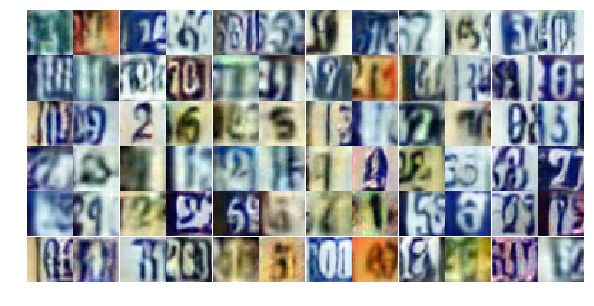

Epoch 17/25... Discriminator Loss: 0.6177... Generator Loss: 1.5725
Epoch 17/25... Discriminator Loss: 1.4529... Generator Loss: 0.5938
Epoch 17/25... Discriminator Loss: 0.9949... Generator Loss: 3.1272
Epoch 17/25... Discriminator Loss: 0.8834... Generator Loss: 0.9257
Epoch 17/25... Discriminator Loss: 0.9968... Generator Loss: 1.3487
Epoch 17/25... Discriminator Loss: 0.6744... Generator Loss: 1.0273
Epoch 17/25... Discriminator Loss: 1.0044... Generator Loss: 0.6856
Epoch 17/25... Discriminator Loss: 0.4655... Generator Loss: 1.5981
Epoch 17/25... Discriminator Loss: 0.4822... Generator Loss: 1.5540
Epoch 17/25... Discriminator Loss: 0.9004... Generator Loss: 0.7118


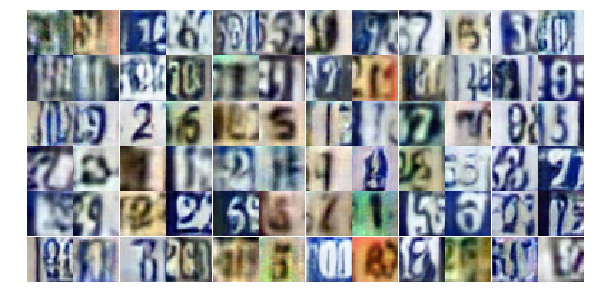

Epoch 17/25... Discriminator Loss: 1.1102... Generator Loss: 2.0333
Epoch 17/25... Discriminator Loss: 0.4298... Generator Loss: 1.7214
Epoch 17/25... Discriminator Loss: 0.9889... Generator Loss: 0.7204
Epoch 17/25... Discriminator Loss: 0.5224... Generator Loss: 1.1610
Epoch 17/25... Discriminator Loss: 0.6304... Generator Loss: 1.0310
Epoch 17/25... Discriminator Loss: 0.8394... Generator Loss: 0.8208
Epoch 17/25... Discriminator Loss: 1.2960... Generator Loss: 0.4594
Epoch 17/25... Discriminator Loss: 0.7727... Generator Loss: 0.8351
Epoch 17/25... Discriminator Loss: 0.7808... Generator Loss: 0.8864
Epoch 17/25... Discriminator Loss: 0.9281... Generator Loss: 1.2790


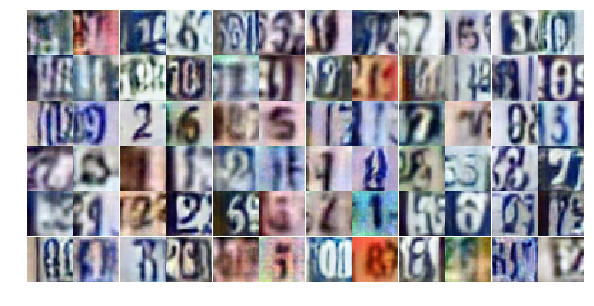

Epoch 17/25... Discriminator Loss: 0.8347... Generator Loss: 0.8447
Epoch 17/25... Discriminator Loss: 1.1110... Generator Loss: 1.8771
Epoch 17/25... Discriminator Loss: 0.5627... Generator Loss: 1.2373
Epoch 17/25... Discriminator Loss: 0.6463... Generator Loss: 1.1717
Epoch 18/25... Discriminator Loss: 1.2794... Generator Loss: 0.4942
Epoch 18/25... Discriminator Loss: 0.6355... Generator Loss: 0.9949
Epoch 18/25... Discriminator Loss: 0.6263... Generator Loss: 1.1100
Epoch 18/25... Discriminator Loss: 0.6071... Generator Loss: 1.1065
Epoch 18/25... Discriminator Loss: 1.3978... Generator Loss: 0.4050
Epoch 18/25... Discriminator Loss: 1.4599... Generator Loss: 0.3613


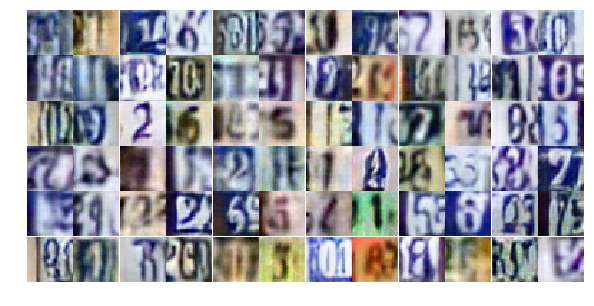

Epoch 18/25... Discriminator Loss: 0.3644... Generator Loss: 2.0220
Epoch 18/25... Discriminator Loss: 0.6419... Generator Loss: 1.7712
Epoch 18/25... Discriminator Loss: 0.6643... Generator Loss: 1.0547
Epoch 18/25... Discriminator Loss: 0.4059... Generator Loss: 1.8825
Epoch 18/25... Discriminator Loss: 0.7350... Generator Loss: 0.9737
Epoch 18/25... Discriminator Loss: 0.6794... Generator Loss: 1.0762
Epoch 18/25... Discriminator Loss: 0.5499... Generator Loss: 1.2360
Epoch 18/25... Discriminator Loss: 1.2461... Generator Loss: 0.4958
Epoch 18/25... Discriminator Loss: 0.5689... Generator Loss: 1.6178
Epoch 18/25... Discriminator Loss: 0.3576... Generator Loss: 1.8598


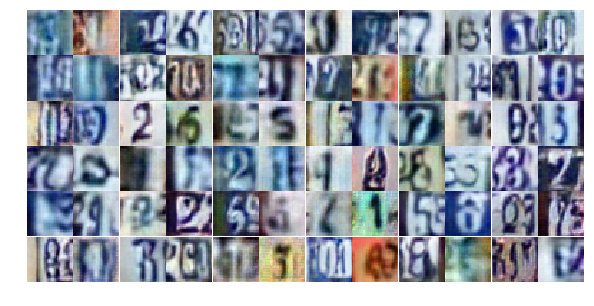

Epoch 18/25... Discriminator Loss: 0.9859... Generator Loss: 0.8490
Epoch 18/25... Discriminator Loss: 0.7047... Generator Loss: 1.0299
Epoch 18/25... Discriminator Loss: 1.0537... Generator Loss: 0.7395
Epoch 18/25... Discriminator Loss: 0.4961... Generator Loss: 1.3531
Epoch 18/25... Discriminator Loss: 1.0268... Generator Loss: 0.5984
Epoch 18/25... Discriminator Loss: 0.9368... Generator Loss: 0.7172
Epoch 18/25... Discriminator Loss: 1.2670... Generator Loss: 0.5024
Epoch 18/25... Discriminator Loss: 1.1218... Generator Loss: 0.5130
Epoch 18/25... Discriminator Loss: 0.6732... Generator Loss: 0.9795
Epoch 18/25... Discriminator Loss: 0.5965... Generator Loss: 1.3234


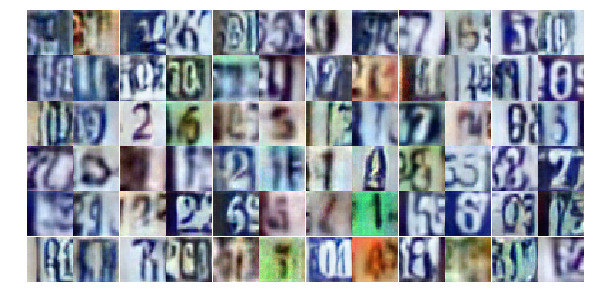

Epoch 18/25... Discriminator Loss: 0.6240... Generator Loss: 1.2560
Epoch 18/25... Discriminator Loss: 0.7944... Generator Loss: 1.3195
Epoch 18/25... Discriminator Loss: 0.9256... Generator Loss: 0.9123
Epoch 18/25... Discriminator Loss: 0.7887... Generator Loss: 0.8719
Epoch 18/25... Discriminator Loss: 1.0140... Generator Loss: 0.6001
Epoch 18/25... Discriminator Loss: 0.5467... Generator Loss: 1.2611
Epoch 18/25... Discriminator Loss: 0.7733... Generator Loss: 0.8852
Epoch 18/25... Discriminator Loss: 0.6926... Generator Loss: 1.0820
Epoch 18/25... Discriminator Loss: 0.5639... Generator Loss: 1.2772
Epoch 18/25... Discriminator Loss: 0.9442... Generator Loss: 0.7838


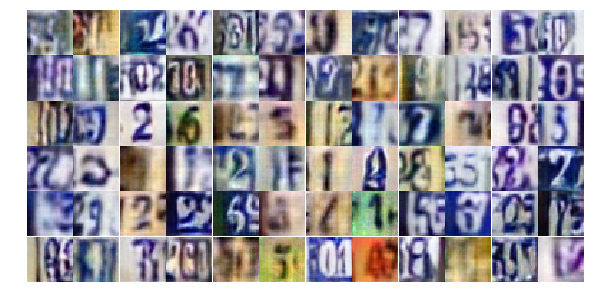

Epoch 18/25... Discriminator Loss: 0.6186... Generator Loss: 1.2625
Epoch 18/25... Discriminator Loss: 0.6968... Generator Loss: 1.2565
Epoch 18/25... Discriminator Loss: 0.7934... Generator Loss: 0.8726
Epoch 18/25... Discriminator Loss: 0.7932... Generator Loss: 0.8051
Epoch 18/25... Discriminator Loss: 1.0442... Generator Loss: 0.6716
Epoch 18/25... Discriminator Loss: 0.3997... Generator Loss: 1.4794
Epoch 18/25... Discriminator Loss: 0.7514... Generator Loss: 0.8896
Epoch 18/25... Discriminator Loss: 1.7877... Generator Loss: 3.0730
Epoch 18/25... Discriminator Loss: 1.0816... Generator Loss: 0.6803
Epoch 18/25... Discriminator Loss: 0.3733... Generator Loss: 1.9643


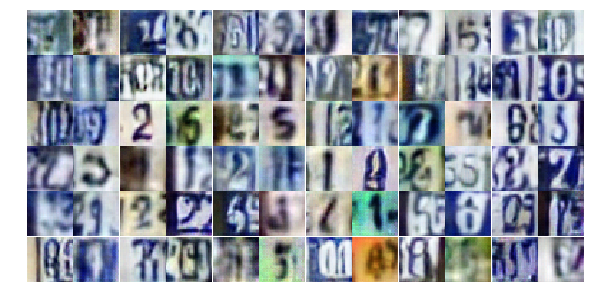

Epoch 18/25... Discriminator Loss: 0.5026... Generator Loss: 1.4643
Epoch 18/25... Discriminator Loss: 0.8950... Generator Loss: 0.7812
Epoch 18/25... Discriminator Loss: 1.1621... Generator Loss: 0.5959
Epoch 18/25... Discriminator Loss: 1.2147... Generator Loss: 0.4989
Epoch 18/25... Discriminator Loss: 0.8428... Generator Loss: 0.8225
Epoch 18/25... Discriminator Loss: 0.6817... Generator Loss: 1.7126
Epoch 18/25... Discriminator Loss: 0.7910... Generator Loss: 0.8562
Epoch 18/25... Discriminator Loss: 1.1944... Generator Loss: 0.6617
Epoch 18/25... Discriminator Loss: 1.0122... Generator Loss: 0.7751
Epoch 18/25... Discriminator Loss: 0.9023... Generator Loss: 0.7260


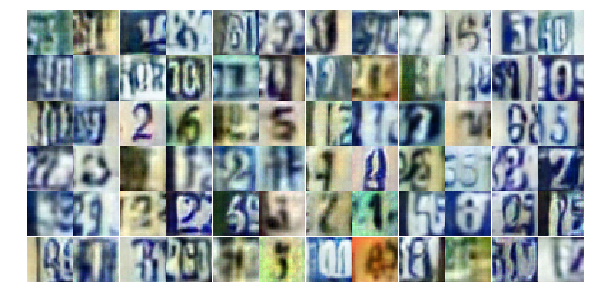

Epoch 18/25... Discriminator Loss: 0.8431... Generator Loss: 1.0130
Epoch 19/25... Discriminator Loss: 1.3522... Generator Loss: 0.4036
Epoch 19/25... Discriminator Loss: 0.9895... Generator Loss: 0.6870
Epoch 19/25... Discriminator Loss: 0.9228... Generator Loss: 0.7460
Epoch 19/25... Discriminator Loss: 0.7973... Generator Loss: 1.0382
Epoch 19/25... Discriminator Loss: 1.0267... Generator Loss: 0.6106
Epoch 19/25... Discriminator Loss: 0.6877... Generator Loss: 1.0250
Epoch 19/25... Discriminator Loss: 0.7227... Generator Loss: 1.5975
Epoch 19/25... Discriminator Loss: 0.7267... Generator Loss: 1.0385
Epoch 19/25... Discriminator Loss: 1.4677... Generator Loss: 0.3817


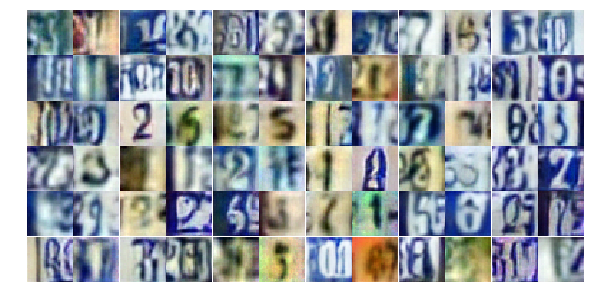

Epoch 19/25... Discriminator Loss: 0.8594... Generator Loss: 0.7311
Epoch 19/25... Discriminator Loss: 0.7770... Generator Loss: 1.0200
Epoch 19/25... Discriminator Loss: 1.0911... Generator Loss: 0.7104
Epoch 19/25... Discriminator Loss: 0.9200... Generator Loss: 0.7368
Epoch 19/25... Discriminator Loss: 1.3063... Generator Loss: 0.4449
Epoch 19/25... Discriminator Loss: 0.6641... Generator Loss: 1.0558
Epoch 19/25... Discriminator Loss: 1.3858... Generator Loss: 0.5415
Epoch 19/25... Discriminator Loss: 0.9846... Generator Loss: 0.7084
Epoch 19/25... Discriminator Loss: 0.9626... Generator Loss: 0.7734
Epoch 19/25... Discriminator Loss: 0.8114... Generator Loss: 0.8522


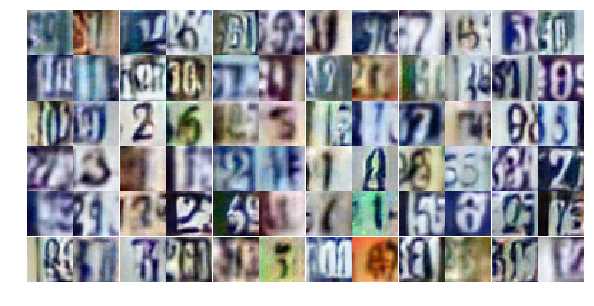

Epoch 19/25... Discriminator Loss: 0.7737... Generator Loss: 0.8852
Epoch 19/25... Discriminator Loss: 1.3237... Generator Loss: 0.4818
Epoch 19/25... Discriminator Loss: 1.4509... Generator Loss: 0.3848
Epoch 19/25... Discriminator Loss: 1.1852... Generator Loss: 0.5398
Epoch 19/25... Discriminator Loss: 1.0373... Generator Loss: 0.6161
Epoch 19/25... Discriminator Loss: 0.6792... Generator Loss: 1.2989
Epoch 19/25... Discriminator Loss: 0.6753... Generator Loss: 1.1140
Epoch 19/25... Discriminator Loss: 0.6713... Generator Loss: 1.1420
Epoch 19/25... Discriminator Loss: 0.6784... Generator Loss: 1.0866
Epoch 19/25... Discriminator Loss: 0.8216... Generator Loss: 0.8955


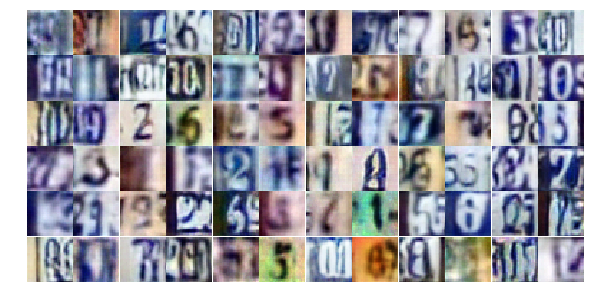

Epoch 19/25... Discriminator Loss: 0.8321... Generator Loss: 0.8941
Epoch 19/25... Discriminator Loss: 0.7637... Generator Loss: 0.9438
Epoch 19/25... Discriminator Loss: 1.2184... Generator Loss: 0.4736
Epoch 19/25... Discriminator Loss: 0.6605... Generator Loss: 0.9892
Epoch 19/25... Discriminator Loss: 0.6791... Generator Loss: 1.0961
Epoch 19/25... Discriminator Loss: 1.3994... Generator Loss: 0.4781
Epoch 19/25... Discriminator Loss: 0.8150... Generator Loss: 1.1387
Epoch 19/25... Discriminator Loss: 0.5002... Generator Loss: 1.4749
Epoch 19/25... Discriminator Loss: 0.9657... Generator Loss: 0.7641
Epoch 19/25... Discriminator Loss: 0.7389... Generator Loss: 0.8346


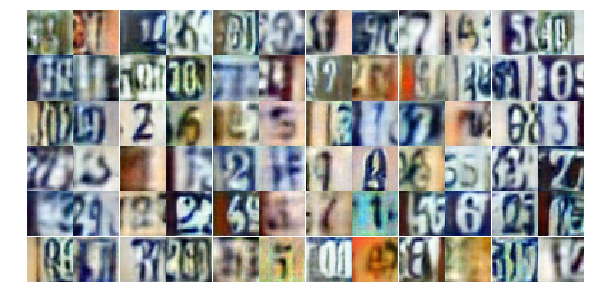

Epoch 19/25... Discriminator Loss: 0.5992... Generator Loss: 1.1616
Epoch 19/25... Discriminator Loss: 1.1146... Generator Loss: 0.6300
Epoch 19/25... Discriminator Loss: 0.9721... Generator Loss: 0.6733
Epoch 19/25... Discriminator Loss: 0.9701... Generator Loss: 0.7365
Epoch 19/25... Discriminator Loss: 0.9836... Generator Loss: 0.8938
Epoch 19/25... Discriminator Loss: 1.1080... Generator Loss: 0.6823
Epoch 19/25... Discriminator Loss: 0.6017... Generator Loss: 1.2134
Epoch 19/25... Discriminator Loss: 0.4506... Generator Loss: 1.4397
Epoch 19/25... Discriminator Loss: 0.8118... Generator Loss: 0.9713
Epoch 19/25... Discriminator Loss: 0.9635... Generator Loss: 0.8755


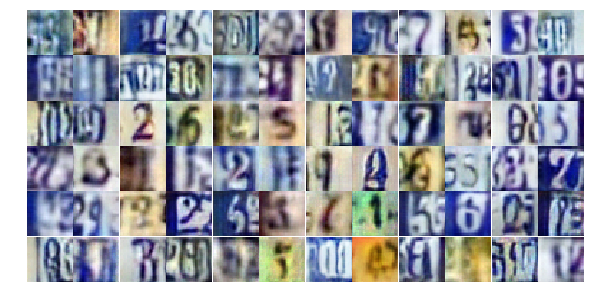

Epoch 19/25... Discriminator Loss: 0.8047... Generator Loss: 0.8188
Epoch 19/25... Discriminator Loss: 0.9516... Generator Loss: 0.7057
Epoch 19/25... Discriminator Loss: 0.7631... Generator Loss: 1.3236
Epoch 19/25... Discriminator Loss: 1.1401... Generator Loss: 0.5391
Epoch 19/25... Discriminator Loss: 0.8577... Generator Loss: 1.5082
Epoch 19/25... Discriminator Loss: 0.8008... Generator Loss: 0.9230
Epoch 19/25... Discriminator Loss: 1.2053... Generator Loss: 0.5627
Epoch 19/25... Discriminator Loss: 0.6130... Generator Loss: 1.2247
Epoch 20/25... Discriminator Loss: 1.0020... Generator Loss: 0.6194
Epoch 20/25... Discriminator Loss: 0.6542... Generator Loss: 1.4119


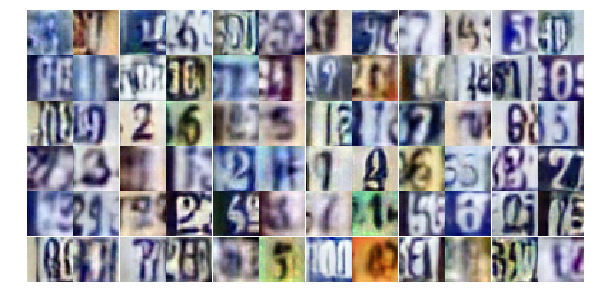

Epoch 20/25... Discriminator Loss: 0.7327... Generator Loss: 0.9511
Epoch 20/25... Discriminator Loss: 0.8817... Generator Loss: 0.8547
Epoch 20/25... Discriminator Loss: 1.4303... Generator Loss: 0.3583
Epoch 20/25... Discriminator Loss: 0.7541... Generator Loss: 0.9044
Epoch 20/25... Discriminator Loss: 0.4461... Generator Loss: 1.4932
Epoch 20/25... Discriminator Loss: 0.9680... Generator Loss: 3.1700
Epoch 20/25... Discriminator Loss: 2.6559... Generator Loss: 1.8969
Epoch 20/25... Discriminator Loss: 1.1894... Generator Loss: 2.0777
Epoch 20/25... Discriminator Loss: 1.2420... Generator Loss: 0.7478
Epoch 20/25... Discriminator Loss: 0.8493... Generator Loss: 0.9312


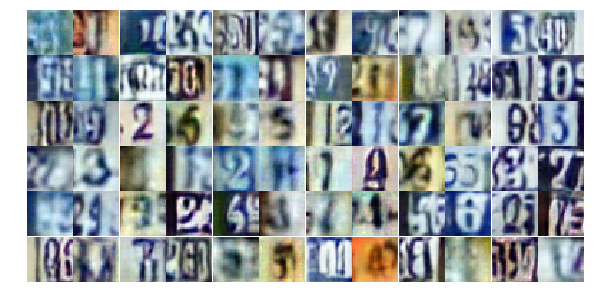

Epoch 20/25... Discriminator Loss: 1.5514... Generator Loss: 0.3372
Epoch 20/25... Discriminator Loss: 0.7475... Generator Loss: 1.0361
Epoch 20/25... Discriminator Loss: 0.6041... Generator Loss: 1.2893
Epoch 20/25... Discriminator Loss: 0.9416... Generator Loss: 0.7222
Epoch 20/25... Discriminator Loss: 0.9585... Generator Loss: 0.7219
Epoch 20/25... Discriminator Loss: 1.2554... Generator Loss: 0.5521
Epoch 20/25... Discriminator Loss: 1.2317... Generator Loss: 0.5206
Epoch 20/25... Discriminator Loss: 0.8425... Generator Loss: 0.8695
Epoch 20/25... Discriminator Loss: 0.8365... Generator Loss: 0.8244
Epoch 20/25... Discriminator Loss: 1.3164... Generator Loss: 0.4704


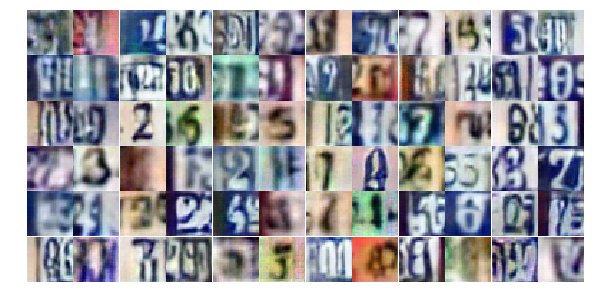

Epoch 20/25... Discriminator Loss: 0.6762... Generator Loss: 1.0745
Epoch 20/25... Discriminator Loss: 0.7373... Generator Loss: 1.0478
Epoch 20/25... Discriminator Loss: 0.4321... Generator Loss: 1.3143
Epoch 20/25... Discriminator Loss: 1.4826... Generator Loss: 0.3799
Epoch 20/25... Discriminator Loss: 0.7471... Generator Loss: 0.9932
Epoch 20/25... Discriminator Loss: 0.7045... Generator Loss: 1.0540
Epoch 20/25... Discriminator Loss: 0.6055... Generator Loss: 1.2410
Epoch 20/25... Discriminator Loss: 1.2915... Generator Loss: 0.4318
Epoch 20/25... Discriminator Loss: 1.0630... Generator Loss: 0.6458
Epoch 20/25... Discriminator Loss: 0.5303... Generator Loss: 1.2067


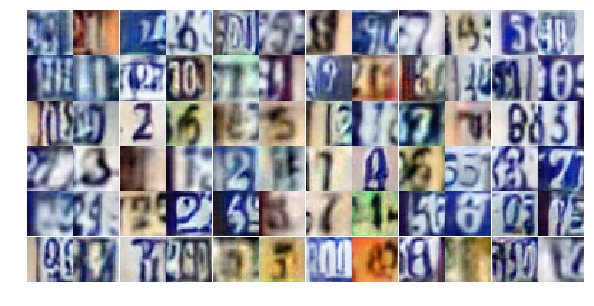

Epoch 20/25... Discriminator Loss: 0.7065... Generator Loss: 1.1111
Epoch 20/25... Discriminator Loss: 0.4898... Generator Loss: 1.4130
Epoch 20/25... Discriminator Loss: 1.5139... Generator Loss: 0.3667
Epoch 20/25... Discriminator Loss: 1.0532... Generator Loss: 1.4561
Epoch 20/25... Discriminator Loss: 0.8791... Generator Loss: 0.8719
Epoch 20/25... Discriminator Loss: 0.6590... Generator Loss: 1.0441
Epoch 20/25... Discriminator Loss: 0.7574... Generator Loss: 1.1099
Epoch 20/25... Discriminator Loss: 1.0673... Generator Loss: 0.6279
Epoch 20/25... Discriminator Loss: 0.8556... Generator Loss: 0.7901
Epoch 20/25... Discriminator Loss: 1.2602... Generator Loss: 0.5360


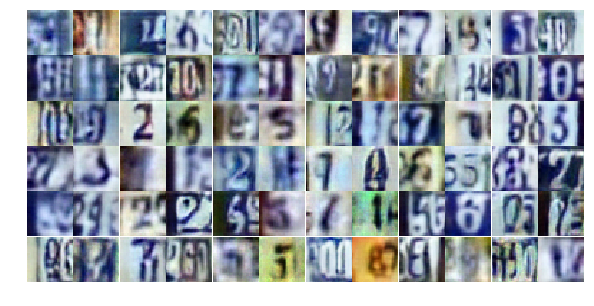

Epoch 20/25... Discriminator Loss: 0.8594... Generator Loss: 0.8527
Epoch 20/25... Discriminator Loss: 0.9676... Generator Loss: 0.6688
Epoch 20/25... Discriminator Loss: 0.4485... Generator Loss: 1.7564
Epoch 20/25... Discriminator Loss: 0.3708... Generator Loss: 1.8400
Epoch 20/25... Discriminator Loss: 0.5494... Generator Loss: 1.4228
Epoch 20/25... Discriminator Loss: 0.7937... Generator Loss: 1.1045
Epoch 20/25... Discriminator Loss: 1.0113... Generator Loss: 0.6416
Epoch 20/25... Discriminator Loss: 0.4797... Generator Loss: 1.5505
Epoch 20/25... Discriminator Loss: 0.6482... Generator Loss: 1.0583
Epoch 20/25... Discriminator Loss: 0.8621... Generator Loss: 0.8113


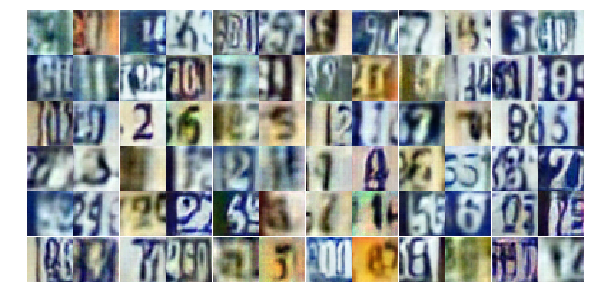

Epoch 20/25... Discriminator Loss: 0.5102... Generator Loss: 1.3124
Epoch 20/25... Discriminator Loss: 0.6190... Generator Loss: 1.8954
Epoch 20/25... Discriminator Loss: 0.5086... Generator Loss: 1.6389
Epoch 20/25... Discriminator Loss: 0.9159... Generator Loss: 0.9472
Epoch 20/25... Discriminator Loss: 0.6425... Generator Loss: 1.1090
Epoch 20/25... Discriminator Loss: 0.4778... Generator Loss: 1.4511
Epoch 21/25... Discriminator Loss: 1.1357... Generator Loss: 0.6132
Epoch 21/25... Discriminator Loss: 0.7277... Generator Loss: 0.8827
Epoch 21/25... Discriminator Loss: 1.1743... Generator Loss: 0.5471
Epoch 21/25... Discriminator Loss: 0.8610... Generator Loss: 0.8338


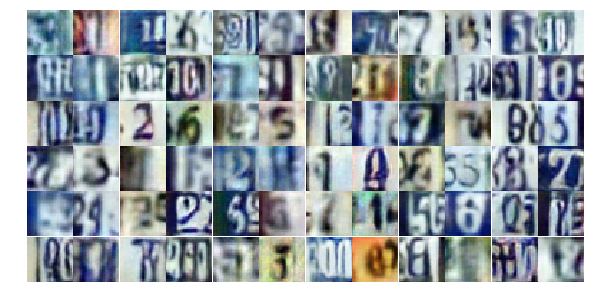

Epoch 21/25... Discriminator Loss: 0.7086... Generator Loss: 1.0890
Epoch 21/25... Discriminator Loss: 2.2381... Generator Loss: 0.1828
Epoch 21/25... Discriminator Loss: 0.4697... Generator Loss: 1.6153
Epoch 21/25... Discriminator Loss: 0.5635... Generator Loss: 1.2024
Epoch 21/25... Discriminator Loss: 0.7774... Generator Loss: 0.8550
Epoch 21/25... Discriminator Loss: 0.5738... Generator Loss: 1.2813
Epoch 21/25... Discriminator Loss: 0.6799... Generator Loss: 1.0442
Epoch 21/25... Discriminator Loss: 0.8507... Generator Loss: 1.0678
Epoch 21/25... Discriminator Loss: 0.7320... Generator Loss: 0.8858
Epoch 21/25... Discriminator Loss: 0.7210... Generator Loss: 0.8907


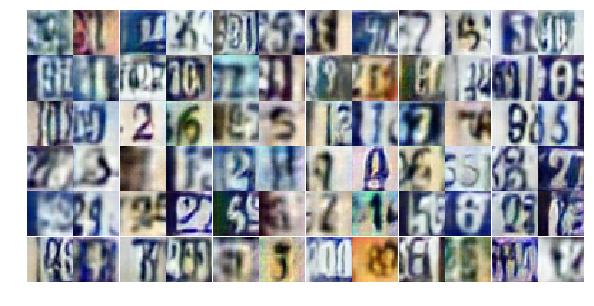

Epoch 21/25... Discriminator Loss: 0.3959... Generator Loss: 1.5155
Epoch 21/25... Discriminator Loss: 1.2976... Generator Loss: 0.4713
Epoch 21/25... Discriminator Loss: 1.7385... Generator Loss: 0.3253
Epoch 21/25... Discriminator Loss: 1.3870... Generator Loss: 0.5217
Epoch 21/25... Discriminator Loss: 0.7165... Generator Loss: 1.0945
Epoch 21/25... Discriminator Loss: 1.1798... Generator Loss: 0.6363
Epoch 21/25... Discriminator Loss: 0.8100... Generator Loss: 0.8540
Epoch 21/25... Discriminator Loss: 0.4942... Generator Loss: 1.2680
Epoch 21/25... Discriminator Loss: 0.3898... Generator Loss: 1.5200
Epoch 21/25... Discriminator Loss: 0.6713... Generator Loss: 1.0174


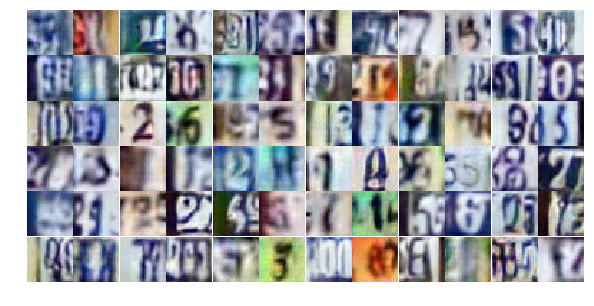

Epoch 21/25... Discriminator Loss: 1.0248... Generator Loss: 0.6451
Epoch 21/25... Discriminator Loss: 0.3994... Generator Loss: 1.6164
Epoch 21/25... Discriminator Loss: 0.7929... Generator Loss: 0.8524
Epoch 21/25... Discriminator Loss: 0.6028... Generator Loss: 1.2060
Epoch 21/25... Discriminator Loss: 0.6394... Generator Loss: 1.1971
Epoch 21/25... Discriminator Loss: 0.8854... Generator Loss: 0.7524
Epoch 21/25... Discriminator Loss: 0.7093... Generator Loss: 0.8845
Epoch 21/25... Discriminator Loss: 0.9268... Generator Loss: 1.7648
Epoch 21/25... Discriminator Loss: 1.2702... Generator Loss: 0.5699
Epoch 21/25... Discriminator Loss: 1.4938... Generator Loss: 0.4879


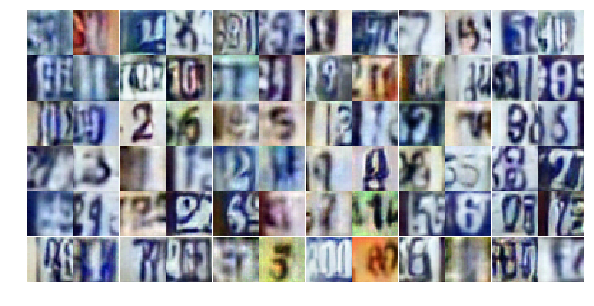

Epoch 21/25... Discriminator Loss: 0.9576... Generator Loss: 0.7485
Epoch 21/25... Discriminator Loss: 0.6929... Generator Loss: 1.0442
Epoch 21/25... Discriminator Loss: 1.6731... Generator Loss: 0.2996
Epoch 21/25... Discriminator Loss: 0.6747... Generator Loss: 1.0375
Epoch 21/25... Discriminator Loss: 0.5197... Generator Loss: 1.3543
Epoch 21/25... Discriminator Loss: 0.7485... Generator Loss: 1.0453
Epoch 21/25... Discriminator Loss: 1.0729... Generator Loss: 0.6494
Epoch 21/25... Discriminator Loss: 1.6046... Generator Loss: 0.3265
Epoch 21/25... Discriminator Loss: 1.2706... Generator Loss: 0.4546
Epoch 21/25... Discriminator Loss: 0.2830... Generator Loss: 3.0318


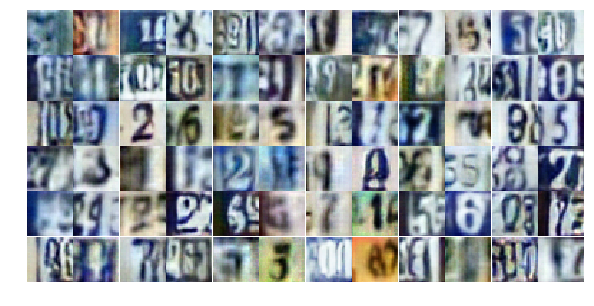

Epoch 21/25... Discriminator Loss: 1.0758... Generator Loss: 0.6207
Epoch 21/25... Discriminator Loss: 0.7822... Generator Loss: 0.9314
Epoch 21/25... Discriminator Loss: 0.7616... Generator Loss: 0.8643
Epoch 21/25... Discriminator Loss: 1.0118... Generator Loss: 0.6741
Epoch 21/25... Discriminator Loss: 0.3250... Generator Loss: 1.7835
Epoch 21/25... Discriminator Loss: 0.6485... Generator Loss: 1.5275
Epoch 21/25... Discriminator Loss: 1.2321... Generator Loss: 0.5008
Epoch 21/25... Discriminator Loss: 1.0546... Generator Loss: 0.6902
Epoch 21/25... Discriminator Loss: 0.8516... Generator Loss: 0.7752
Epoch 21/25... Discriminator Loss: 1.4083... Generator Loss: 0.4388


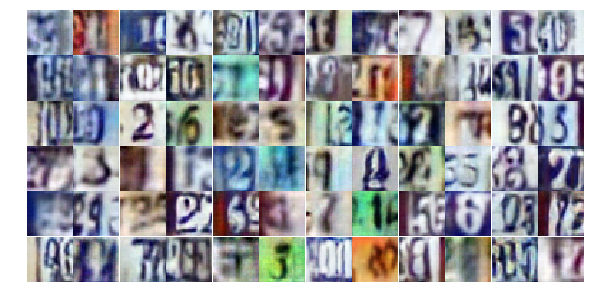

Epoch 21/25... Discriminator Loss: 0.5460... Generator Loss: 1.3519
Epoch 21/25... Discriminator Loss: 1.0817... Generator Loss: 0.6536
Epoch 21/25... Discriminator Loss: 0.6457... Generator Loss: 1.1839
Epoch 22/25... Discriminator Loss: 0.7724... Generator Loss: 1.0093
Epoch 22/25... Discriminator Loss: 0.8190... Generator Loss: 1.0936
Epoch 22/25... Discriminator Loss: 0.9416... Generator Loss: 0.7106
Epoch 22/25... Discriminator Loss: 0.4055... Generator Loss: 1.6740
Epoch 22/25... Discriminator Loss: 0.5640... Generator Loss: 1.1235
Epoch 22/25... Discriminator Loss: 1.3263... Generator Loss: 0.4299
Epoch 22/25... Discriminator Loss: 0.8699... Generator Loss: 0.7962


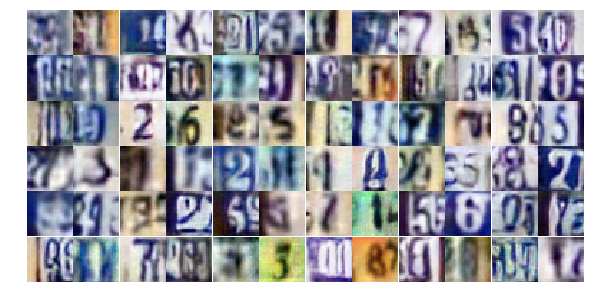

Epoch 22/25... Discriminator Loss: 0.3960... Generator Loss: 1.8615
Epoch 22/25... Discriminator Loss: 0.8060... Generator Loss: 0.9678
Epoch 22/25... Discriminator Loss: 1.4305... Generator Loss: 0.4466
Epoch 22/25... Discriminator Loss: 0.6352... Generator Loss: 1.0734
Epoch 22/25... Discriminator Loss: 0.9109... Generator Loss: 0.8260
Epoch 22/25... Discriminator Loss: 0.7341... Generator Loss: 1.1280
Epoch 22/25... Discriminator Loss: 0.6146... Generator Loss: 1.2058
Epoch 22/25... Discriminator Loss: 0.4794... Generator Loss: 1.5181
Epoch 22/25... Discriminator Loss: 1.0227... Generator Loss: 0.6862
Epoch 22/25... Discriminator Loss: 1.6320... Generator Loss: 0.3403


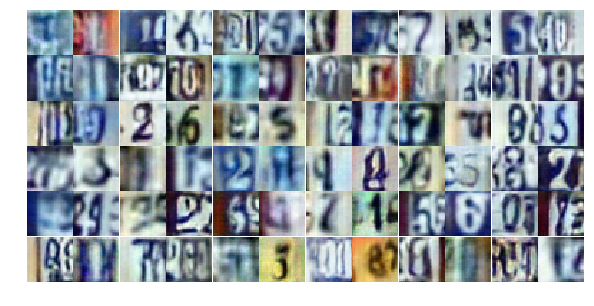

Epoch 22/25... Discriminator Loss: 0.6853... Generator Loss: 1.1494
Epoch 22/25... Discriminator Loss: 0.9264... Generator Loss: 2.7886
Epoch 22/25... Discriminator Loss: 1.6907... Generator Loss: 0.3329
Epoch 22/25... Discriminator Loss: 0.4872... Generator Loss: 1.3392
Epoch 22/25... Discriminator Loss: 0.5660... Generator Loss: 1.5050
Epoch 22/25... Discriminator Loss: 0.7289... Generator Loss: 1.1077
Epoch 22/25... Discriminator Loss: 0.4787... Generator Loss: 1.2600
Epoch 22/25... Discriminator Loss: 0.3733... Generator Loss: 1.8587
Epoch 22/25... Discriminator Loss: 0.6335... Generator Loss: 1.0137
Epoch 22/25... Discriminator Loss: 1.3641... Generator Loss: 0.4326


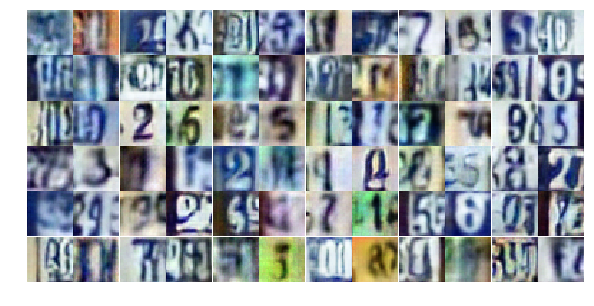

Epoch 22/25... Discriminator Loss: 0.4633... Generator Loss: 1.4234
Epoch 22/25... Discriminator Loss: 0.7233... Generator Loss: 1.0065
Epoch 22/25... Discriminator Loss: 0.8030... Generator Loss: 1.2681
Epoch 22/25... Discriminator Loss: 0.8401... Generator Loss: 0.8215
Epoch 22/25... Discriminator Loss: 0.6365... Generator Loss: 1.7355
Epoch 22/25... Discriminator Loss: 1.3328... Generator Loss: 0.4972
Epoch 22/25... Discriminator Loss: 1.6646... Generator Loss: 0.3421
Epoch 22/25... Discriminator Loss: 1.2453... Generator Loss: 3.0743
Epoch 22/25... Discriminator Loss: 0.9118... Generator Loss: 0.7980
Epoch 22/25... Discriminator Loss: 1.0361... Generator Loss: 0.7208


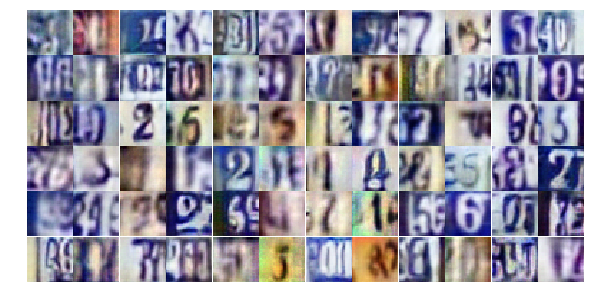

Epoch 22/25... Discriminator Loss: 0.9111... Generator Loss: 0.7602
Epoch 22/25... Discriminator Loss: 0.5146... Generator Loss: 1.4235
Epoch 22/25... Discriminator Loss: 0.4687... Generator Loss: 1.2819
Epoch 22/25... Discriminator Loss: 0.4381... Generator Loss: 2.1526
Epoch 22/25... Discriminator Loss: 0.5262... Generator Loss: 1.2466
Epoch 22/25... Discriminator Loss: 0.3967... Generator Loss: 1.6259
Epoch 22/25... Discriminator Loss: 0.6712... Generator Loss: 1.1366
Epoch 22/25... Discriminator Loss: 1.1336... Generator Loss: 0.5355
Epoch 22/25... Discriminator Loss: 1.3908... Generator Loss: 0.4596
Epoch 22/25... Discriminator Loss: 0.7089... Generator Loss: 1.0358


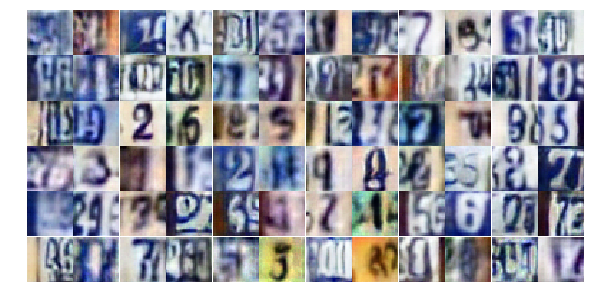

Epoch 22/25... Discriminator Loss: 1.3846... Generator Loss: 0.5312
Epoch 22/25... Discriminator Loss: 0.6959... Generator Loss: 1.0858
Epoch 22/25... Discriminator Loss: 0.9305... Generator Loss: 0.7155
Epoch 22/25... Discriminator Loss: 0.9885... Generator Loss: 0.7864
Epoch 22/25... Discriminator Loss: 1.4905... Generator Loss: 0.3582
Epoch 22/25... Discriminator Loss: 1.2388... Generator Loss: 0.5676
Epoch 22/25... Discriminator Loss: 1.1403... Generator Loss: 0.5396
Epoch 22/25... Discriminator Loss: 0.6563... Generator Loss: 1.0232
Epoch 22/25... Discriminator Loss: 1.0911... Generator Loss: 2.9856
Epoch 22/25... Discriminator Loss: 0.8123... Generator Loss: 0.8412


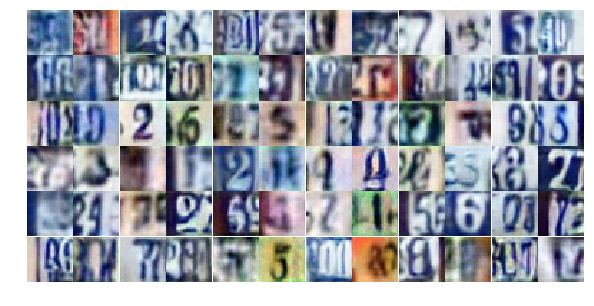

Epoch 23/25... Discriminator Loss: 0.5003... Generator Loss: 1.4420
Epoch 23/25... Discriminator Loss: 0.6031... Generator Loss: 1.0797
Epoch 23/25... Discriminator Loss: 0.8493... Generator Loss: 0.8298
Epoch 23/25... Discriminator Loss: 0.7179... Generator Loss: 1.0236
Epoch 23/25... Discriminator Loss: 0.7138... Generator Loss: 0.9924
Epoch 23/25... Discriminator Loss: 1.5225... Generator Loss: 0.4182
Epoch 23/25... Discriminator Loss: 1.7279... Generator Loss: 0.2882
Epoch 23/25... Discriminator Loss: 0.4919... Generator Loss: 1.9912
Epoch 23/25... Discriminator Loss: 0.6345... Generator Loss: 1.4648
Epoch 23/25... Discriminator Loss: 0.3715... Generator Loss: 1.7093


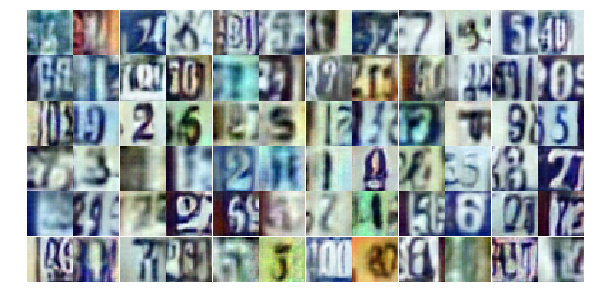

Epoch 23/25... Discriminator Loss: 0.6107... Generator Loss: 1.0863
Epoch 23/25... Discriminator Loss: 0.9813... Generator Loss: 0.6547
Epoch 23/25... Discriminator Loss: 0.9020... Generator Loss: 0.8994
Epoch 23/25... Discriminator Loss: 0.6338... Generator Loss: 1.0800
Epoch 23/25... Discriminator Loss: 0.4517... Generator Loss: 1.4490
Epoch 23/25... Discriminator Loss: 0.7560... Generator Loss: 0.9272
Epoch 23/25... Discriminator Loss: 0.8277... Generator Loss: 0.7997
Epoch 23/25... Discriminator Loss: 2.1620... Generator Loss: 0.3121
Epoch 23/25... Discriminator Loss: 2.5975... Generator Loss: 0.1706
Epoch 23/25... Discriminator Loss: 1.0506... Generator Loss: 0.7225


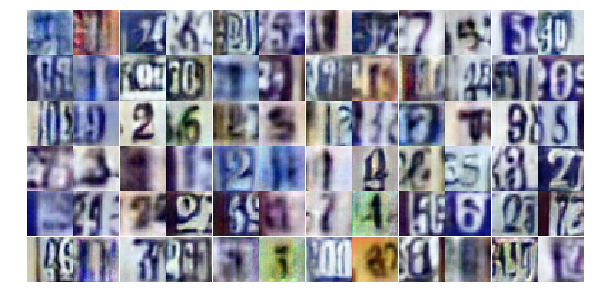

Epoch 23/25... Discriminator Loss: 1.1033... Generator Loss: 0.6310
Epoch 23/25... Discriminator Loss: 0.8490... Generator Loss: 0.9086
Epoch 23/25... Discriminator Loss: 1.4361... Generator Loss: 0.3770
Epoch 23/25... Discriminator Loss: 0.7512... Generator Loss: 0.9197
Epoch 23/25... Discriminator Loss: 0.5165... Generator Loss: 1.3492
Epoch 23/25... Discriminator Loss: 1.0169... Generator Loss: 3.2089
Epoch 23/25... Discriminator Loss: 0.8524... Generator Loss: 0.9596
Epoch 23/25... Discriminator Loss: 0.5595... Generator Loss: 1.3204
Epoch 23/25... Discriminator Loss: 0.6570... Generator Loss: 0.9816
Epoch 23/25... Discriminator Loss: 0.9162... Generator Loss: 1.7017


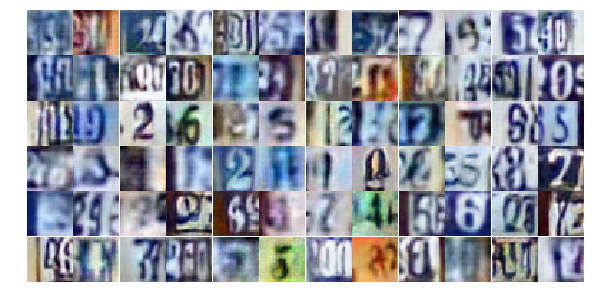

Epoch 23/25... Discriminator Loss: 0.6111... Generator Loss: 1.0416
Epoch 23/25... Discriminator Loss: 0.5505... Generator Loss: 1.2361
Epoch 23/25... Discriminator Loss: 0.6289... Generator Loss: 1.3892
Epoch 23/25... Discriminator Loss: 1.0372... Generator Loss: 0.6506
Epoch 23/25... Discriminator Loss: 0.8822... Generator Loss: 1.8468
Epoch 23/25... Discriminator Loss: 1.0216... Generator Loss: 0.7516
Epoch 23/25... Discriminator Loss: 1.3803... Generator Loss: 0.4324
Epoch 23/25... Discriminator Loss: 0.9502... Generator Loss: 0.6811
Epoch 23/25... Discriminator Loss: 0.4366... Generator Loss: 1.7167
Epoch 23/25... Discriminator Loss: 0.5431... Generator Loss: 1.4060


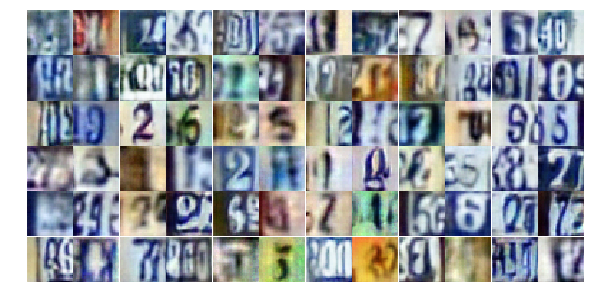

Epoch 23/25... Discriminator Loss: 0.7233... Generator Loss: 1.0517
Epoch 23/25... Discriminator Loss: 0.6807... Generator Loss: 1.2313
Epoch 23/25... Discriminator Loss: 0.8092... Generator Loss: 1.0078
Epoch 23/25... Discriminator Loss: 0.7607... Generator Loss: 1.6126
Epoch 23/25... Discriminator Loss: 1.1875... Generator Loss: 0.5955
Epoch 23/25... Discriminator Loss: 0.8275... Generator Loss: 0.9644
Epoch 23/25... Discriminator Loss: 0.6958... Generator Loss: 1.0578
Epoch 23/25... Discriminator Loss: 1.3481... Generator Loss: 0.5217
Epoch 23/25... Discriminator Loss: 0.7002... Generator Loss: 0.9991
Epoch 23/25... Discriminator Loss: 0.7173... Generator Loss: 1.0898


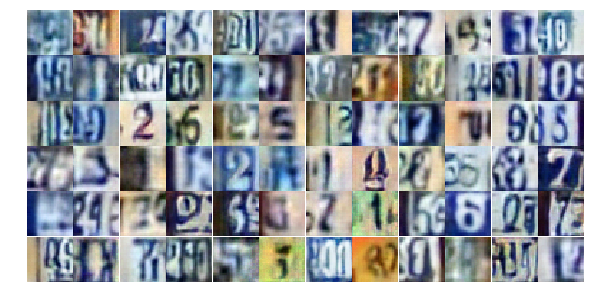

Epoch 23/25... Discriminator Loss: 0.8175... Generator Loss: 0.9684
Epoch 23/25... Discriminator Loss: 1.3506... Generator Loss: 0.4402
Epoch 23/25... Discriminator Loss: 0.8853... Generator Loss: 0.8110
Epoch 23/25... Discriminator Loss: 0.2623... Generator Loss: 2.1739
Epoch 23/25... Discriminator Loss: 1.5186... Generator Loss: 0.4364
Epoch 23/25... Discriminator Loss: 0.6837... Generator Loss: 1.1155
Epoch 23/25... Discriminator Loss: 0.6921... Generator Loss: 1.0803
Epoch 24/25... Discriminator Loss: 0.5493... Generator Loss: 1.3042
Epoch 24/25... Discriminator Loss: 1.0419... Generator Loss: 0.7005
Epoch 24/25... Discriminator Loss: 1.2286... Generator Loss: 0.5489


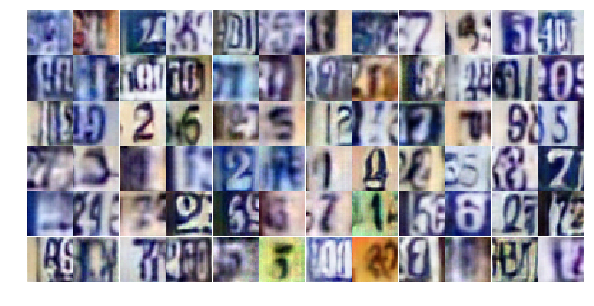

Epoch 24/25... Discriminator Loss: 0.6168... Generator Loss: 2.5648
Epoch 24/25... Discriminator Loss: 0.5246... Generator Loss: 1.5863
Epoch 24/25... Discriminator Loss: 0.5619... Generator Loss: 1.5465
Epoch 24/25... Discriminator Loss: 0.7470... Generator Loss: 2.0255
Epoch 24/25... Discriminator Loss: 0.7080... Generator Loss: 0.8718
Epoch 24/25... Discriminator Loss: 0.5688... Generator Loss: 1.2648
Epoch 24/25... Discriminator Loss: 0.7686... Generator Loss: 1.0307
Epoch 24/25... Discriminator Loss: 1.2902... Generator Loss: 0.4843
Epoch 24/25... Discriminator Loss: 0.8089... Generator Loss: 0.7811
Epoch 24/25... Discriminator Loss: 0.4584... Generator Loss: 1.5263


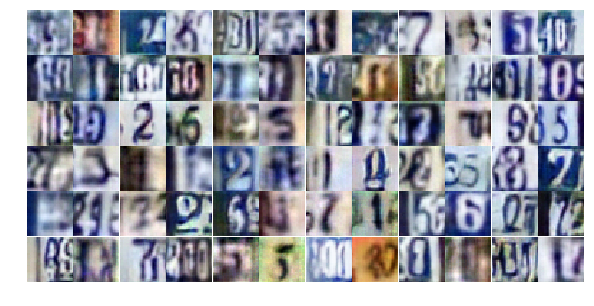

Epoch 24/25... Discriminator Loss: 1.6893... Generator Loss: 0.2946
Epoch 24/25... Discriminator Loss: 1.7734... Generator Loss: 0.3020
Epoch 24/25... Discriminator Loss: 1.1567... Generator Loss: 0.6065
Epoch 24/25... Discriminator Loss: 0.5567... Generator Loss: 1.1314
Epoch 24/25... Discriminator Loss: 0.7269... Generator Loss: 1.1607
Epoch 24/25... Discriminator Loss: 1.5425... Generator Loss: 3.2230
Epoch 24/25... Discriminator Loss: 0.4767... Generator Loss: 1.5745
Epoch 24/25... Discriminator Loss: 1.0537... Generator Loss: 0.7390
Epoch 24/25... Discriminator Loss: 0.9950... Generator Loss: 0.7644
Epoch 24/25... Discriminator Loss: 0.7047... Generator Loss: 0.9756


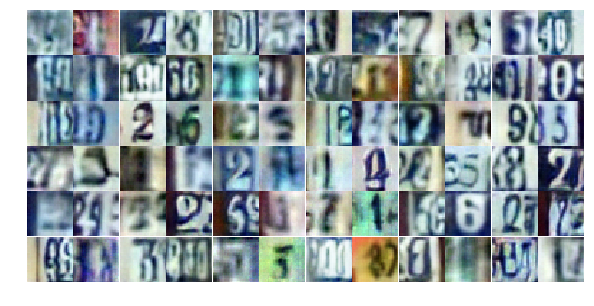

Epoch 24/25... Discriminator Loss: 0.9111... Generator Loss: 0.7549
Epoch 24/25... Discriminator Loss: 0.6542... Generator Loss: 1.2222
Epoch 24/25... Discriminator Loss: 0.7470... Generator Loss: 1.0584
Epoch 24/25... Discriminator Loss: 1.5910... Generator Loss: 0.3552
Epoch 24/25... Discriminator Loss: 0.6713... Generator Loss: 1.0575
Epoch 24/25... Discriminator Loss: 0.6152... Generator Loss: 1.0373
Epoch 24/25... Discriminator Loss: 0.6956... Generator Loss: 0.9822
Epoch 24/25... Discriminator Loss: 0.8605... Generator Loss: 0.8598
Epoch 24/25... Discriminator Loss: 0.7536... Generator Loss: 0.8798
Epoch 24/25... Discriminator Loss: 0.8571... Generator Loss: 0.8353


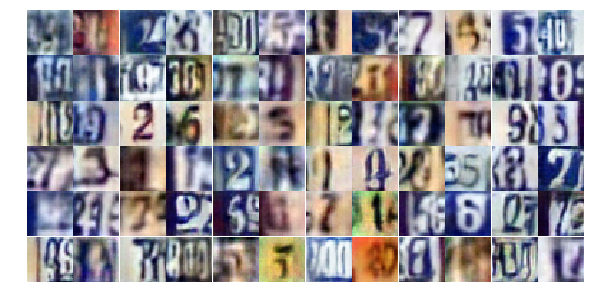

Epoch 24/25... Discriminator Loss: 0.6840... Generator Loss: 0.9296
Epoch 24/25... Discriminator Loss: 0.6530... Generator Loss: 1.0237
Epoch 24/25... Discriminator Loss: 0.9270... Generator Loss: 2.7386
Epoch 24/25... Discriminator Loss: 2.0582... Generator Loss: 0.2713
Epoch 24/25... Discriminator Loss: 0.8367... Generator Loss: 1.1314
Epoch 24/25... Discriminator Loss: 0.7947... Generator Loss: 0.8511
Epoch 24/25... Discriminator Loss: 1.4288... Generator Loss: 0.4099
Epoch 24/25... Discriminator Loss: 0.7818... Generator Loss: 0.8953
Epoch 24/25... Discriminator Loss: 0.9811... Generator Loss: 0.7418
Epoch 24/25... Discriminator Loss: 0.9356... Generator Loss: 0.6795


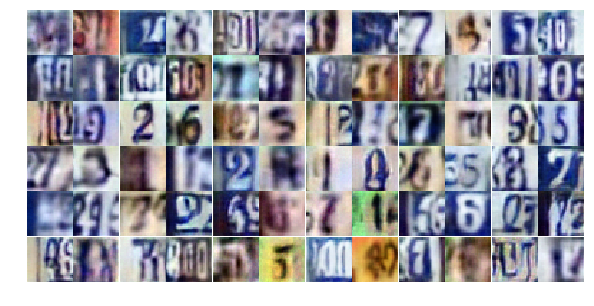

Epoch 24/25... Discriminator Loss: 0.9616... Generator Loss: 0.6482
Epoch 24/25... Discriminator Loss: 0.6883... Generator Loss: 1.0458
Epoch 24/25... Discriminator Loss: 1.1694... Generator Loss: 0.5491
Epoch 24/25... Discriminator Loss: 1.9384... Generator Loss: 0.2789
Epoch 24/25... Discriminator Loss: 1.9903... Generator Loss: 0.2322
Epoch 24/25... Discriminator Loss: 0.6137... Generator Loss: 1.2196
Epoch 24/25... Discriminator Loss: 0.6764... Generator Loss: 0.9723
Epoch 24/25... Discriminator Loss: 0.7431... Generator Loss: 0.9375
Epoch 24/25... Discriminator Loss: 0.8706... Generator Loss: 0.7834
Epoch 24/25... Discriminator Loss: 0.9158... Generator Loss: 0.9398


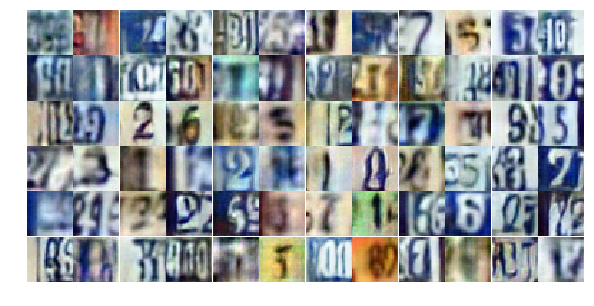

Epoch 24/25... Discriminator Loss: 1.4049... Generator Loss: 0.4406
Epoch 24/25... Discriminator Loss: 1.2995... Generator Loss: 0.4571
Epoch 24/25... Discriminator Loss: 0.8112... Generator Loss: 0.8503
Epoch 24/25... Discriminator Loss: 1.1655... Generator Loss: 0.5939
Epoch 24/25... Discriminator Loss: 1.4891... Generator Loss: 0.3661
Epoch 25/25... Discriminator Loss: 0.6399... Generator Loss: 1.2958
Epoch 25/25... Discriminator Loss: 0.5703... Generator Loss: 1.4404
Epoch 25/25... Discriminator Loss: 0.9387... Generator Loss: 0.6942
Epoch 25/25... Discriminator Loss: 0.9264... Generator Loss: 0.7125
Epoch 25/25... Discriminator Loss: 1.5950... Generator Loss: 0.3780


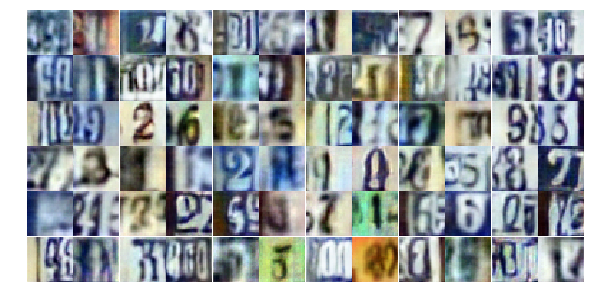

Epoch 25/25... Discriminator Loss: 0.9276... Generator Loss: 0.7274
Epoch 25/25... Discriminator Loss: 1.0599... Generator Loss: 0.6445
Epoch 25/25... Discriminator Loss: 1.4474... Generator Loss: 0.3802
Epoch 25/25... Discriminator Loss: 0.7837... Generator Loss: 1.4101
Epoch 25/25... Discriminator Loss: 0.8220... Generator Loss: 1.8644
Epoch 25/25... Discriminator Loss: 1.1861... Generator Loss: 0.5592
Epoch 25/25... Discriminator Loss: 1.1101... Generator Loss: 0.6099
Epoch 25/25... Discriminator Loss: 0.8300... Generator Loss: 0.8505
Epoch 25/25... Discriminator Loss: 0.5529... Generator Loss: 1.1099
Epoch 25/25... Discriminator Loss: 0.8558... Generator Loss: 0.7543


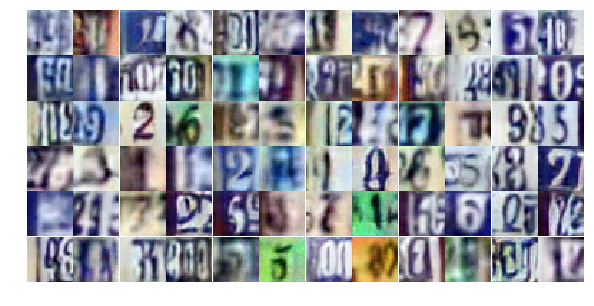

Epoch 25/25... Discriminator Loss: 0.5747... Generator Loss: 1.5631
Epoch 25/25... Discriminator Loss: 0.8022... Generator Loss: 4.0306
Epoch 25/25... Discriminator Loss: 1.4153... Generator Loss: 0.4868
Epoch 25/25... Discriminator Loss: 1.6053... Generator Loss: 0.3862
Epoch 25/25... Discriminator Loss: 0.5451... Generator Loss: 1.5314
Epoch 25/25... Discriminator Loss: 0.6892... Generator Loss: 1.1053
Epoch 25/25... Discriminator Loss: 0.9514... Generator Loss: 0.7546
Epoch 25/25... Discriminator Loss: 1.3993... Generator Loss: 0.4706
Epoch 25/25... Discriminator Loss: 0.4780... Generator Loss: 1.4747
Epoch 25/25... Discriminator Loss: 0.3933... Generator Loss: 1.9252


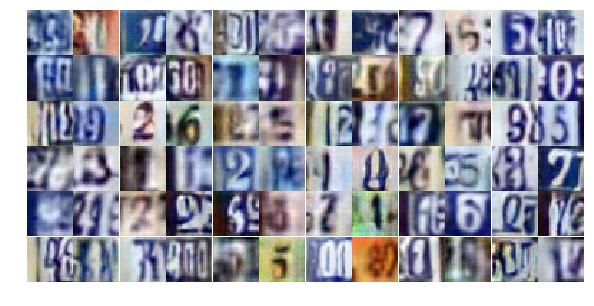

Epoch 25/25... Discriminator Loss: 0.6129... Generator Loss: 1.0993
Epoch 25/25... Discriminator Loss: 0.5651... Generator Loss: 1.4435
Epoch 25/25... Discriminator Loss: 1.5838... Generator Loss: 0.3583
Epoch 25/25... Discriminator Loss: 0.6799... Generator Loss: 1.1002
Epoch 25/25... Discriminator Loss: 0.7287... Generator Loss: 1.0853
Epoch 25/25... Discriminator Loss: 0.5939... Generator Loss: 1.1630
Epoch 25/25... Discriminator Loss: 0.7548... Generator Loss: 0.9962
Epoch 25/25... Discriminator Loss: 0.5950... Generator Loss: 1.2734
Epoch 25/25... Discriminator Loss: 0.9338... Generator Loss: 2.2213
Epoch 25/25... Discriminator Loss: 0.6770... Generator Loss: 1.1291


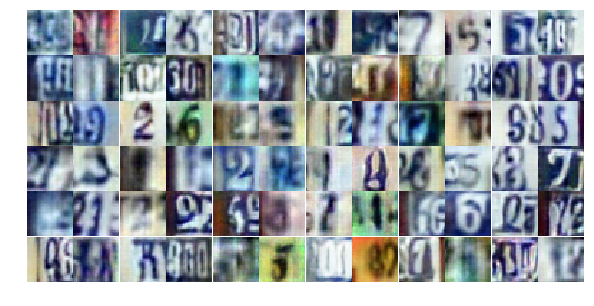

Epoch 25/25... Discriminator Loss: 1.9956... Generator Loss: 0.4073
Epoch 25/25... Discriminator Loss: 0.5911... Generator Loss: 1.9451
Epoch 25/25... Discriminator Loss: 0.7593... Generator Loss: 1.0829
Epoch 25/25... Discriminator Loss: 0.9914... Generator Loss: 0.6733
Epoch 25/25... Discriminator Loss: 0.7848... Generator Loss: 0.8930
Epoch 25/25... Discriminator Loss: 1.0970... Generator Loss: 0.6107
Epoch 25/25... Discriminator Loss: 0.6969... Generator Loss: 1.0048
Epoch 25/25... Discriminator Loss: 0.6054... Generator Loss: 1.0631
Epoch 25/25... Discriminator Loss: 1.4828... Generator Loss: 0.4760
Epoch 25/25... Discriminator Loss: 0.4146... Generator Loss: 1.4562


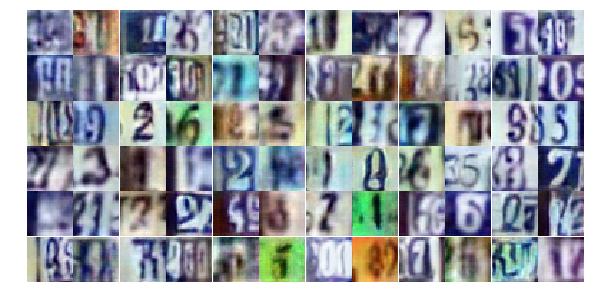

Epoch 25/25... Discriminator Loss: 1.0603... Generator Loss: 0.6957
Epoch 25/25... Discriminator Loss: 0.7904... Generator Loss: 0.9927
Epoch 25/25... Discriminator Loss: 1.1262... Generator Loss: 0.5834
Epoch 25/25... Discriminator Loss: 0.9476... Generator Loss: 0.7715
Epoch 25/25... Discriminator Loss: 1.0543... Generator Loss: 0.6288
Epoch 25/25... Discriminator Loss: 0.4505... Generator Loss: 1.3916
Epoch 25/25... Discriminator Loss: 1.2817... Generator Loss: 0.5383
Epoch 25/25... Discriminator Loss: 0.6897... Generator Loss: 0.9475
Epoch 25/25... Discriminator Loss: 0.8196... Generator Loss: 1.1408
Epoch 25/25... Discriminator Loss: 1.1025... Generator Loss: 0.6711


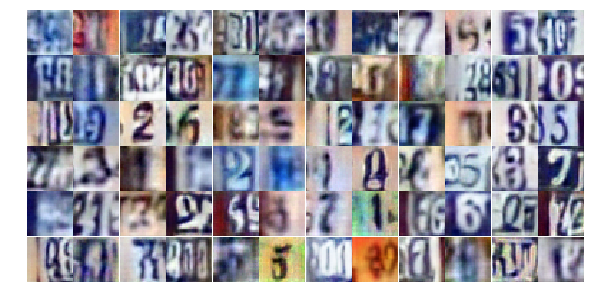

Epoch 25/25... Discriminator Loss: 0.5996... Generator Loss: 1.3460
Epoch 25/25... Discriminator Loss: 1.5804... Generator Loss: 0.3855


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

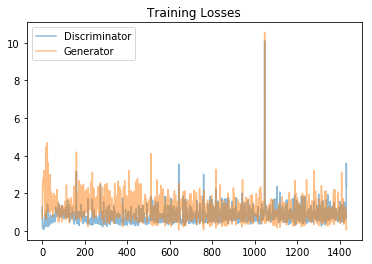

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

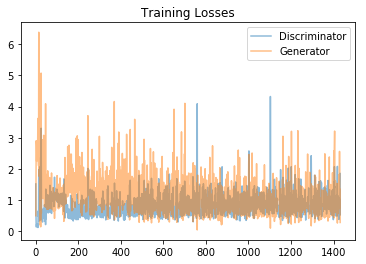

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

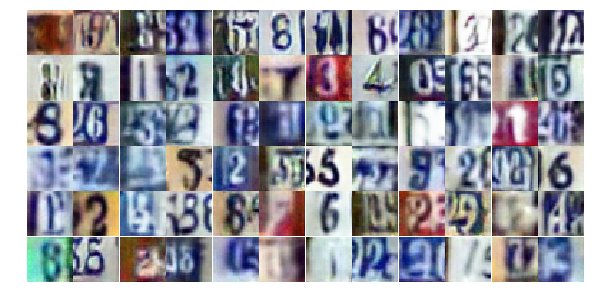

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

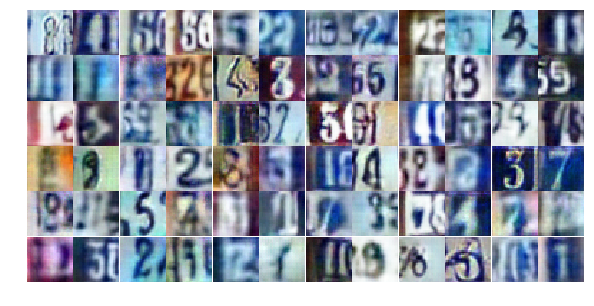

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))